# Réseaux pleinement connectés 

Cet exercice fait suite au devoir 1.  L'objectif ici est d'implanter un réseau pleinement connecté avec une approche plus modulaire. Pour chaque couche, vous serez appelé à implanter une fonction `forward` et une fonction `backward`. La fonction `forward` reçoit en entrée un tenseur `x`, des poids `w` et possiblement d'autres parameters, et retourne le tenseur de sortie de la couche `out`.  La fonction retourne aussi une variable `cache`  contenant des données utilisés pour la rétropropagation (fonction `backward`).  La structure de la fonction `forward` est la suivante : 

```python
def layer_forward(x, w):
  """ Receive inputs x and weights w """
  # Do some computations ...
  z = # ... some intermediate value
  # Do some more computations ...
  out = # the output
   
  cache = (x, w, z, out) # Values we need to compute gradients
   
  return out, cache
```

N'oubliez pas que `x` est une `batch` et donc conbient plus d'un élément.

En rétropropagation, la fonction `backward` de la couche reçoit en entrée un tenseur de dérivées `dout` ainsi que la liste `cache` calculée lors de la propagation avant (fonction `forward`).  Elle retourne deux tenseurs de gradients: un par rapport à ses entrée (`dx`) et un par rapport à ses poids (`dw`) (et parfois un par rapport aux bias `db`).  La structure de la fonction `backward` est la suivante : 

```python
def layer_backward(dout, cache):
  """
  Receive derivative of loss with respect to outputs and cache,
  and compute derivative with respect to inputs.
  """
  # Unpack cache values
  x, w, z, out = cache
  
  # Use values in cache to compute derivatives
  dx = # Derivative of loss with respect to x
  dw = # Derivative of loss with respect to w
  
  return dx, dw
```

Une fois ce type de couches implanté, il sera possible de les combiner ensemble et ainsi construire des réseaux de neurones de différentes architectures.

En plus des réseaux pleinement connectés, nous explorerons différents algorithme de descente de gradient et  introduirons *Dropout* et *Batch Norm*.
  

In [1]:
# As usual, a bit of setup

#import time
import numpy as np
import matplotlib.pyplot as plt
from ift725.classifiers.fc_net import *
from ift725.data_utils import get_CIFAR10_data
from ift725.gradient_check import eval_numerical_gradient, eval_numerical_gradient_array
from ift725.solver import Solver

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

print('setup done!')

setup done!


In [2]:
# Load the (preprocessed) CIFAR10 data.

data = get_CIFAR10_data()
for k, v in data.items():
  print('%s: ' % k, v.shape)

X_train:  (49000, 3, 32, 32)
y_train:  (49000,)
X_val:  (1000, 3, 32, 32)
y_val:  (1000,)
X_test:  (1000, 3, 32, 32)
y_test:  (1000,)


# Couche pleinement connectée : propagation avant
Dans le fichier `ift725/layers.py`, vous devez coder la fonction `forward_fully_connected` et la tester avec le code de la cellule suivante.

In [3]:
# Test the forward_fully_connected function : batch 1 and 1 output neuron

input_shape = (2, 2, 3) # an 2x2x3 input variable (a CIFAR10 image would have a 32x32x3 shape)

input_size = np.prod(input_shape) # here 12
weight_size = np.prod(input_shape) # here 12

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(1, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(weight_size, 1)*10)
b = np.linspace(-0.3, 0.1, num=1)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = 36.7

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out, correct_out))

x-shape  =  (1, 2, 2, 3)
w-shape  =  (12, 1)
b-shape  =  (1,)
out =  [[36.7]]
correct_out =  36.7
Testing forward_fully_connected function:
difference:  0.0


In [4]:
# Test the forward_fully_connected function : batch 2 and 1 output neuron

num_inputs = 2          # batch of 2 input variables
input_shape = (2, 2, 3) # an 2x2x3 input variable (a CIFAR10 image would have a 32x32x3 shape)

input_size = num_inputs * np.prod(input_shape) # here 2x12 = 24
weight_size = np.prod(input_shape) # here 12

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(num_inputs, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(weight_size, 1)*10)
b = np.linspace(-0.3, 0.1, num=1)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = np.array([14.7, 20.7])

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out.T, correct_out))

x-shape  =  (2, 2, 2, 3)
w-shape  =  (12, 1)
b-shape  =  (1,)
out =  [[14.7]
 [20.7]]
correct_out =  [14.7 20.7]
Testing forward_fully_connected function:
difference:  0.0


In [5]:
# Test the forward_fully_connected function : batch 2 and 2 output neurons
num_inputs = 2          # batch of 2 input variables
input_shape = (2, 2, 3) # each variable as a 2x2x3 shape (a CIFAR10 RBG image would have a 32x32x3 shape)
output_dim = 2          # the output has 2 neurons

input_size = num_inputs * np.prod(input_shape)  #here 2x2x2x3 = 24
weight_size = output_dim * np.prod(input_shape) #here 2x12 = 24

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(num_inputs, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(np.prod(input_shape), output_dim)*10)
b = np.linspace(-0.3, 0.1, num=output_dim)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = np.array([[ 12.7,  14.1],
                        [ 11.7,  23.1]])

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out, correct_out))

x-shape  =  (2, 2, 2, 3)
w-shape  =  (12, 2)
b-shape  =  (2,)
out =  [[12.7 14.1]
 [11.7 23.1]]
correct_out =  [[12.7 14.1]
 [11.7 23.1]]
Testing forward_fully_connected function:
difference:  0.0


# Couche pleinement connectée : rétro-propagation
If faut maintenant implanter la fonction `backward_fully_connected` et tester votre code avec un gradient numérique.

In [6]:
# Test the backward_fully_connected function
# Here a case for a batch of 10 elements
# Each elements has a 2x3 size
# The layer has 5 output neurons

x = np.random.randn(10, 2, 3)  # batch of 10 elements, each of size 2x3
w = np.random.randn(6, 5)      # 2x3=6 weigts times 5 output neurones
b = np.random.randn(5)         # one bias for each output neurone
dout = np.random.randn(10, 5)  # the upcoming gradient at each output neuron and for each element of the batch

dx_num = eval_numerical_gradient_array(lambda x: forward_fully_connected(x, w, b)[0], x, dout)
dw_num = eval_numerical_gradient_array(lambda w: forward_fully_connected(x, w, b)[0], w, dout)
db_num = eval_numerical_gradient_array(lambda b: forward_fully_connected(x, w, b)[0], b, dout)

_, cache = forward_fully_connected(x, w, b)
dx, dw, db = backward_fully_connected(dout, cache)

# The error should be around 1e-10
print('Testing backward_fully_connected function:')
print('dx error: ', rel_error(dx_num, dx))  #Gradient with respect to the input x : size 10x2x3
print('dw error: ', rel_error(dw_num, dw))  #Gradient with respect to the weights w : size 5x6
print('db error: ', rel_error(db_num, db))  #Gradient with respect to the bias : size 5

Testing backward_fully_connected function:
dx error:  7.376174983220762e-10
dw error:  1.4867517784548374e-10
db error:  1.509339190578434e-09


# Couche ReLU : propagation avant
Il faut implanter la fonction d'activation ReLU avec la fonction `relu_forward`.  Testez votre implantation avec la cellule que voici:

In [7]:
# Test the relu_forward function

x = np.linspace(-0.5, 0.5, num=12).reshape(3, 4)

out, _ = forward_relu(x)
correct_out = np.array([[ 0.,          0.,          0.,          0.,        ],
                        [ 0.,          0.,          0.04545455,  0.13636364,],
                        [ 0.22727273,  0.31818182,  0.40909091,  0.5,       ]])

# Compare your output with ours. The error should be around 1e-8
print('Testing forward_relu function:')
print('difference: ', rel_error(out, correct_out))

Testing forward_relu function:
difference:  4.999999798022158e-08


# Couche ReLU : rétropropagation
Maintenant il faut implanter la rétro-propagation pour une fonction d'activation ReLU via la fonction `relu_backward`.  Testez votre implantation avec le gradient numérique que voici:

In [8]:
x = np.random.randn(2, 2)
dout = np.random.randn(*x.shape) # Upstream gradient that retropropagates at that layer
print("x = ", x)
print("dout  = ", dout)

dx_num = eval_numerical_gradient_array(lambda xx: forward_relu(xx)[0], x, dout)

_, cache = forward_relu(x)
dx = backward_relu(dout, cache)

# The error should be around 1e-12
print('Testing backward_relu function:')
print('dx error: ', rel_error(dx_num, dx))

x =  [[-2.21869535  1.48077296]
 [ 0.94317617  0.38158315]]
dout  =  [[ 1.2415238   0.12603297]
 [-0.19364552  1.16116745]]
Testing backward_relu function:
dx error:  3.275622619698633e-12


# Couches "Combo"
Souvent, on combine une couche pleinement connectée avec une fonction d'activation comme ReLU. Afin de simplifier ces situations, nous avons différentes fonctions à cet effet dans `ift725/layer_combo.py`.

Pour l'instant, nous porterons notre attention sur les fonctions `forward_fully_connected_transform_relu` et `backward_fully_connected_transform_relu`.  Vous pouvez vérifier le code à l'aide de la vérification numérique que voici:

In [9]:
from ift725.layer_combo import forward_fully_connected_transform_relu, backward_fully_connected_transform_relu

x = np.random.randn(2, 3, 4)  # Batch of 2 elements of size 3x4
w = np.random.randn(12, 10)   # 10 output neurons, each associated with 12=3x4 weights
b = np.random.randn(10)       # 10 biases
dout = np.random.randn(2, 10) # up stream gradient for each neuron (10) and each batch element (2)

out, cache = forward_fully_connected_transform_relu(x, w, b)
dx, dw, db = backward_fully_connected_transform_relu(dout, cache)

dx_num = eval_numerical_gradient_array(lambda xx: forward_fully_connected_transform_relu(xx, w, b)[0], x, dout)
dw_num = eval_numerical_gradient_array(lambda ww: forward_fully_connected_transform_relu(x, ww, b)[0], w, dout)
db_num = eval_numerical_gradient_array(lambda bb: forward_fully_connected_transform_relu(x, w, bb)[0], b, dout)

# Error should be around 1e-10
print('Testing forward_fully_connected_transform_relu:')
print('dx error: ', rel_error(dx_num, dx))
print('dw error: ', rel_error(dw_num, dw))
print('db error: ', rel_error(db_num, db))

Testing forward_fully_connected_transform_relu:
dx error:  5.7365617441821516e-11
dw error:  1.217289459165813e-09
db error:  2.109679020113153e-10


# Fonctions de perte : Softmax et SVM
Au devoir 1, vous avez implanter ces deux fonctions de perte.  Vous devez donc récupérer votre code et l'adapter aux fonctions `softmax_loss` et `svm_loss` du fichier `ift725/layers.py`.

Afin de vous assurer que tout fonctionne pour le mieux, exécutez le code que voici:

In [10]:
num_classes, num_inputs = 10, 50
x = 0.001 * np.random.randn(num_inputs, num_classes)
y = np.random.randint(num_classes, size=num_inputs)

dx_num = eval_numerical_gradient(lambda x: svm_loss(x, y)[0], x, verbose=False)
loss, dx = svm_loss(x, y)

# Test svm_loss function. Loss should be around 9 and dx error should be 1e-9
print('Testing svm_loss:')
print('loss: ', loss)
print('dx error: ', rel_error(dx_num, dx))

dx_num = eval_numerical_gradient(lambda x: softmax_loss(x, y)[0], x, verbose=False)
loss, dx = softmax_loss(x, y)

# Test softmax_loss function. Loss should be 2.3 and dx error should be 1e-8
print('\nTesting softmax_loss:')
print('loss: ', loss)
print('dx error: ', rel_error(dx_num, dx))

Testing svm_loss:
loss:  8.999671497996255
dx error:  8.182894472887002e-10

Testing softmax_loss:
loss:  2.3025527180210266
dx error:  9.322301497050755e-09


# Réseau à deux couches
Au tp1, vous avez implanté un réseau à deux couches à l'intérieur d'une seule classe monolitique. Maintenant que les couches ont un design plus modulaire, vous devez implanter un réseau à deux couches de façon modulaire.

Avec le fichier `ift725/classifiers/fc_net.py`, vous devez compléter l'implantation de la classe `TwoLayerNeuralNet`. Le design de cette classe est le prototype pour les autres réseaux utilisés dans ce devoir.  Par conséquent, soyez attentifs et assurez-vous de bien comprendre cet API. Vous pouvez exécuter la cellule que voici pour tester votre code.

In [11]:
# First, lets try a forward pass for a minibatch of 3 elements of size 5, with an hidden layer of size 50 and 7 classes

N, D, H, C = 3, 5, 50, 7
X = np.random.randn(N, D)
y = np.random.randint(C, size=N)

std = 1e-2
model = TwoLayerNeuralNet(input_dim=D, hidden_dim=H, num_classes=C, weight_scale=std)

print('Testing initialization ... ')
W1_std = abs(model.params['W1'].std() - std)
b1 = model.params['b1']
W2_std = abs(model.params['W2'].std() - std)
b2 = model.params['b2']
assert W1_std < std / 10, 'First layer weights do not seem right'
assert np.all(b1 == 0), 'First layer biases do not seem right'
assert W2_std < std / 10, 'Second layer weights do not seem right'
assert np.all(b2 == 0), 'Second layer biases do not seem right'


print('Testing test-time forward pass ... ')
model.params['W1'] = np.linspace(-0.7, 0.3, num=D*H).reshape(D, H)
model.params['b1'] = np.linspace(-0.1, 0.9, num=H)
model.params['W2'] = np.linspace(-0.3, 0.4, num=H*C).reshape(H, C)
model.params['b2'] = np.linspace(-0.9, 0.1, num=C)
X = np.linspace(-5.5, 4.5, num=N*D).reshape(D, N).T
scores = model.loss(X)

correct_scores = np.asarray(
  [[11.53165108,  12.2917344,   13.05181771,  13.81190102,  14.57198434, 15.33206765,  16.09215096],
   [12.05769098,  12.74614105,  13.43459113,  14.1230412,   14.81149128, 15.49994135,  16.18839143],
   [12.58373087,  13.20054771,  13.81736455,  14.43418138,  15.05099822, 15.66781506,  16.2846319 ]])
scores_diff = np.abs(scores - correct_scores).sum()
assert scores_diff < 1e-6, 'Problem with test-time forward pass'
print('score difference = ', scores_diff)


Testing initialization ... 
Testing test-time forward pass ... 
score difference =  5.115849965875441e-08


In [12]:
# Now lets compute the loss with and without regularization
y = np.asarray([0, 5, 1])

model.reg = 0.0  # NO REG
loss, grads = model.loss(X, y)
correct_loss = 3.4702243556
assert abs(loss - correct_loss) < 1e-10, 'Problem with training-time loss'
print('loss difference = ', abs(loss - correct_loss))

model.reg = 1.0  # WITH REG
loss, grads = model.loss(X, y)
correct_loss = 63.9539735065
print('loss = ', loss, '  correct_loss = ', correct_loss)
print('loss difference = ', abs(loss - correct_loss))
assert abs(loss - correct_loss) < 1e-10, 'Problem with regularization loss'


loss difference =  4.6100900874535e-12
loss =  63.9539735065371   correct_loss =  63.9539735065
loss difference =  3.710454166139243e-11


In [13]:
# Now lets compute the loss with different regularization terms

for reg in [0.0, 0.3, 0.6, 0.9]:
  print('Running numeric gradient check with reg = ', reg)
  model.reg = reg
  loss, grads = model.loss(X, y)

  for name in sorted(grads):
    f = lambda _: model.loss(X, y)[0]
    grad_num = eval_numerical_gradient(f, model.params[name], verbose=False)
    print('%s relative error: %.2e' % (name, rel_error(grad_num, grads[name])))

Running numeric gradient check with reg =  0.0
W1 relative error: 1.22e-08
W2 relative error: 3.30e-10
b1 relative error: 8.37e-09
b2 relative error: 1.94e-10
Running numeric gradient check with reg =  0.3
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 1.00e+00
b2 relative error: 1.00e+00
Running numeric gradient check with reg =  0.6
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 1.00e+00
b2 relative error: 1.00e+00
Running numeric gradient check with reg =  0.9
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 8.51e-01
b2 relative error: 1.00e+00


# Solver
Au tp1, l'entraînement des modèles était couplé aux modèles. Suivant un design plus modulaire, dans ce tp nous avons séparé le code d'entraînement et le code des modèles dans différentes classes.

Familiarisez-vous avec le code `ift725/solver.py` et assurez-vous de bien en comprendre le fonctionnement. Après, utilisez un `Solver` pour entraîner le `TwoLayerNeuralNet` et atteindre environ `50%` de justesse en validation sur le base de donnée CIFAR10 stockée dans la variable `data`.

In [14]:
# Load the (preprocessed) CIFAR10 data.

data = get_CIFAR10_data()
for k, v in data.items():
  print('%s: ' % k, v.shape)

X_train:  (49000, 3, 32, 32)
y_train:  (49000,)
X_val:  (1000, 3, 32, 32)
y_val:  (1000,)
X_test:  (1000, 3, 32, 32)
y_test:  (1000,)


In [15]:
model = TwoLayerNeuralNet()

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un TwoLayerNeuralNet  #
#  qui atteint au moins 50% de précision sur l'ensemble de validation.       #
##############################################################################

solver = Solver(model,
                data,
                update_rule = 'sgd',
                optim_config = {'learning_rate': 1e-3},
                lr_decay = 0.90,
                num_epochs = 20, 
                batch_size = 500,
                print_every = 500)
solver.train()

##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################

(Iteration 1 / 1960) loss: 2.299368
(Epoch 0 / 20) train acc: 0.165000; val_acc: 0.142000
(Epoch 1 / 20) train acc: 0.378000; val_acc: 0.387000
(Epoch 2 / 20) train acc: 0.422000; val_acc: 0.424000
(Epoch 3 / 20) train acc: 0.447000; val_acc: 0.450000
(Epoch 4 / 20) train acc: 0.435000; val_acc: 0.467000
(Epoch 5 / 20) train acc: 0.483000; val_acc: 0.468000
(Iteration 501 / 1960) loss: 1.529641
(Epoch 6 / 20) train acc: 0.494000; val_acc: 0.471000
(Epoch 7 / 20) train acc: 0.506000; val_acc: 0.478000
(Epoch 8 / 20) train acc: 0.473000; val_acc: 0.492000
(Epoch 9 / 20) train acc: 0.513000; val_acc: 0.497000
(Epoch 10 / 20) train acc: 0.500000; val_acc: 0.511000
(Iteration 1001 / 1960) loss: 1.368128
(Epoch 11 / 20) train acc: 0.509000; val_acc: 0.506000
(Epoch 12 / 20) train acc: 0.518000; val_acc: 0.515000
(Epoch 13 / 20) train acc: 0.524000; val_acc: 0.500000
(Epoch 14 / 20) train acc: 0.541000; val_acc: 0.499000
(Epoch 15 / 20) train acc: 0.540000; val_acc: 0.512000
(Iteration 1501 /

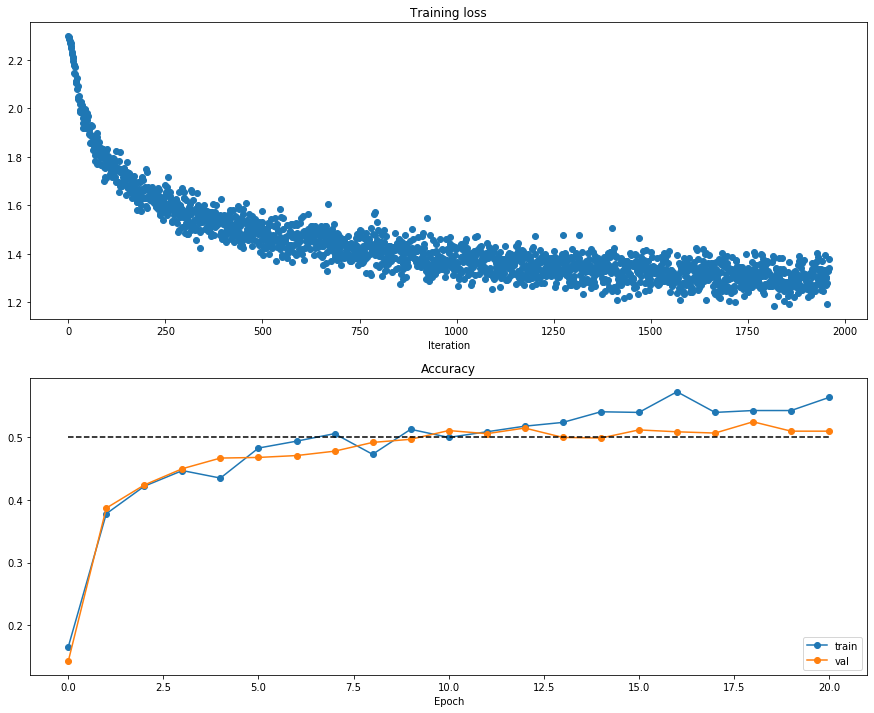

In [16]:
# Run this cell to visualize training loss and train / val accuracy

plt.subplot(2, 1, 1)
plt.title('Training loss')
plt.plot(solver.loss_history, 'o')
plt.xlabel('Iteration')

plt.subplot(2, 1, 2)
plt.title('Accuracy')
plt.plot(solver.train_acc_history, '-o', label='train')
plt.plot(solver.val_acc_history, '-o', label='val')
plt.plot([0.5] * len(solver.val_acc_history), 'k--')
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.gcf().set_size_inches(15, 12)
plt.show()

# Réseau de neurones multi-couches
Maintenant vous devez implanter un réseau ayant un nombre arbitraire de couches.

Pour ce faire, prenez connaissance de la classe `FullyConnectedNeuralNet` du fichier `ift725/classifiers/fc_net.py`.

Vous devez implanter **l'initialization, la propagation avant et la rétro-propagation**. Pour le moment, ne vous souciez pas de dropout ni de batch norm.

##  Fonction de perte et vérification du gradient

La prochaine cellule effectue une vérification dilligente.  Exécutez la cellule afin de vous assurez que la loss avec et sans régularisation fonctionne. 

In [17]:
from ift725.classifiers.fc_net import *
N, D, H1, H2, C = 2, 15, 20, 30, 10
X = np.random.randn(N, D)
y = np.random.randint(C, size=(N,)) 

for reg in [0, 3.14]:
  print('Running check with reg = ', reg)
  model = FullyConnectedNeuralNet([H1, H2], input_dim=D, num_classes=C,
                            reg=reg, weight_scale=5e-2, dtype=np.float64)

  loss, grads = model.loss(X, y)
  print('Initial loss: ', loss)
    
  # Relative error should be below 1e-5
  for name in sorted(grads):
    f = lambda _: model.loss(X, y)[0]
    grad_num = eval_numerical_gradient(f, model.params[name], verbose=False, h=1e-5)
    print('%s relative error: %.2e' % (name, rel_error(grad_num, grads[name])))

Running check with reg =  0
Initial loss:  2.2953654864824418
W1 relative error: 2.90e-06
W2 relative error: 6.29e-07
W3 relative error: 9.31e-08
b1 relative error: 7.31e-08
b2 relative error: 1.69e-09
b3 relative error: 1.66e-10
Running check with reg =  3.14
Initial loss:  7.340298979985988
W1 relative error: 3.18e-08
W2 relative error: 2.37e-07
W3 relative error: 6.60e-09
b1 relative error: 5.95e-08
b2 relative error: 2.53e-09
b3 relative error: 1.48e-10


## Question 1:

Pourquoi croyez-vous que les résultats de la cellule précédentes font foi d'une bonne fonction de perte?
     
**Votre réponse:** ...

Autre vérification diligente, assurez-vous que votre code peut "overfitter" sur un petit ensemble de 50 images. Pour ce faire, essayons un réseau à 3 couches cachées ayant chacune 100 neurones. Une recherche d'hyper-paramètres sera effectué pour trouver le bon taux d'apprentissage (learning rate) ainsi que le `weight_scale`.  Vous devriez être capable d'atteindre une justesse en entraînement de 100% avec 20 epochs.

In [43]:
num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

best_weight_scale = 0.
best_learning_rate = 0.
best_training_acc = 0.

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un réseau à 3 couches #
#  et 100 neurones par couche à overfitter 50 images de CIFAR10.  Il est     #
#  suggéré d'effectuer une recherche d'hyperparamètres pour trouver le bon   #
#  `learning_rate` et le bon `weight_scale`.                                 #
##############################################################################

input_d  = 32 * 32 * 3
hidden_n = [100, 100, 100]
output_c = 10

weight_scales = np.arange(1e-2, 1e-1, 1e-2)
learning_rates = np.arange(1e-3, 1e-2, 1e-3)

results = {}

for w in weight_scales:
    for l in learning_rates:
        model = FullyConnectedNeuralNet(hidden_n,
                                        input_dim = input_d,
                                        num_classes = output_c,
                                        weight_scale = w,
                                        dtype = np.float64)
    
        solver = Solver(model,
                        small_data,
                        update_rule = 'sgd',
                        optim_config = {'learning_rate': l},
                        lr_decay = 0.90,
                        num_epochs = 20, 
                        batch_size = 500,
                        verbose = False)
        solver.train()
    
        train_acc = solver.train_acc_history[-1]
    
        if train_acc > best_training_acc:
            best_weight_scale  = w
            best_learning_rate = l
            best_training_acc  = train_acc
            
        results[(w, l)] = train_acc

##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################

print('The best learning_rate, weight_scale and training accuracy are',best_weight_scale, best_learning_rate, best_training_acc)

The best learning_rate, weight_scale and training accuracy are 0.03 0.009000000000000001 1.0


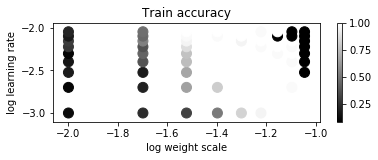

In [44]:
# Visualize the cross-validation results
# import math
marker_size = 100
x_scatter, x_label = [np.log10(x[0]) for x in results], 'log weight scale'
y_scatter, y_label = [np.log10(x[1]) for x in results], 'log learning rate'

# plot validation accuracy
colors = [results[x] for x in results] # default size of markers is 20
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Train accuracy')
plt.show()

Maintenant, faites la même chose pour un réseau à 5 couches.

0.06298565715911145 0.0025127494899038513 

final loss: 0.01667081904168386  train_acc: 1.0


0.015842866956699224 0.007787852989070791 

final loss: 2.2838323116100128  train_acc: 0.28


0.011885688664713389 0.0015566756686169758 

final loss: 2.300940987294624  train_acc: 0.14


0.02278118881475314 0.0017408334660802658 

final loss: 2.2646372209907653  train_acc: 0.18


0.03164310515818282 0.004641325049167446 

final loss: 1.5477923829288347  train_acc: 0.7


0.0198911412906529 0.0024261148294481547 

final loss: 2.2939210926632585  train_acc: 0.26


0.01088195667219463 0.008079765233820192 

final loss: 2.3022987563479136  train_acc: 0.12


0.018430711921486712 0.006112527108819956 

final loss: 2.2727222030594234  train_acc: 0.28


0.012387967339717022 0.003982021000637334 

final loss: 2.2984456309758667  train_acc: 0.2


0.026995538073577244 0.0008482478417861929 

final loss: 2.2162458341886913  train_acc: 0.16


0.019553743498626496 0.0017189410303566786 

final loss: 2.29503

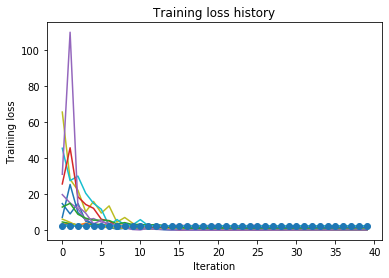

The best learning_rate, weight_scale and training accuracy are 0.03 0.009000000000000001 1.0


In [56]:
num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un réseau à 5 couches #
#  à 100 neurones à overfitter 50 images de CIFAR10.  Il est suggérer de     #
#  d'effectuer une recherche d'hyperparamètres pour trouver le bon           #
#  `learning_rate` et le bon `weight_scale`.                                 #
##############################################################################

def uniform(minv, maxv):
    return np.random.rand() * (maxv - minv) + minv

results = {}
for _ in range(40):
    weight_scale = 10 ** uniform(-2, -1)
    learning_rate = 10 ** uniform(-4, -2)
    print(weight_scale, learning_rate, '\n')
    
    model = FullyConnectedNeuralNet([100, 100, 100, 100],
                  weight_scale=weight_scale, dtype=np.float64)
    solver = Solver(model, small_data,
                    print_every=10, num_epochs=20, batch_size=25,
                    update_rule='sgd',
                    optim_config={
                      'learning_rate': learning_rate,
                    }, verbose=False)
    solver.train()
    train_acc = solver.train_acc_history[-1]
    print('final loss:', solver.loss_history[-1], ' train_acc:', train_acc)
    print('\n')
    plt.plot(solver.loss_history)
    results[(weight_scale, learning_rate)] = train_acc

plt.plot(solver.loss_history, 'o')
plt.title('Training loss history')
plt.xlabel('Iteration')
plt.ylabel('Training loss')
plt.show()



##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################
#best_weight_scale = 0.
#best_learning_rate = 0.
#best_training_acc = 0.
print('The best learning_rate, weight_scale and training accuracy are',best_weight_scale, best_learning_rate, best_training_acc)

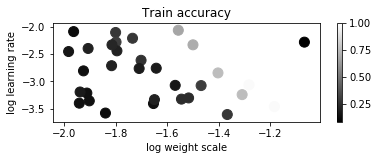

In [57]:
# Visualize the cross-validation results
# import math
marker_size = 100
x_scatter, x_label = [np.log10(x[0]) for x in results], 'log weight scale'
y_scatter, y_label = [np.log10(x[1]) for x in results], 'log learning rate'

# plot validation accuracy
colors = [results[x] for x in results] # default size of markers is 20
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Train accuracy')
plt.show()

# Descente de gradient ++
Jusqu'à présent nous avons utilisé l'algorithmes de base de la descente de gradient (SGD-stochastic gradient descent). Ici nous testerons d'autres algorithmes plus sophistiqués.

# SGD+Momentum
SGD+momentum est très largement utilisé.  Ouvrez  `ift725/optim.py` et prenez connaissance du code et implémentez la fonction `sgd_momentum` et exécutez la cellule que voici. Votre erreur devrait être inféreieure à 1e-6.

In [58]:
from ift725.optim import sgd_momentum

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
v = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-3, 'velocity': v}
next_w, _ = sgd_momentum(w, dw, config=config)

expected_next_w = np.asarray([
    [-0.39994,    -0.34737526, -0.29481053, -0.24224579, -0.18968105],
    [-0.13711632, -0.08455158, -0.03198684,  0.02057789,  0.07314263],
    [ 0.12570737,  0.17827211,  0.23083684,  0.28340158,  0.33596632],
    [ 0.38853105,  0.44109579,  0.49366053,  0.54622526,  0.59879   ]])
expected_velocity = np.asarray([
    [-0.06 ,       0.00684211,  0.07368421,  0.14052632,  0.20736842],
    [ 0.27421053,  0.34105263,  0.40789474,  0.47473684,  0.54157895],
    [ 0.60842105,  0.67526316,  0.74210526,  0.80894737,  0.87578947],
    [ 0.94263158,  1.00947368,  1.07631579,  1.14315789,  1.21      ]])

# Error should be below 1e-06
print('next_w error: ', rel_error(next_w, expected_next_w))
print('velocity error: ', rel_error(expected_velocity, config['velocity']))

v : [[0.5406     0.55475789 0.56891579 0.58307368 0.59723158]
 [0.61138947 0.62554737 0.63970526 0.65386316 0.66802105]
 [0.68217895 0.69633684 0.71049474 0.72465263 0.73881053]
 [0.75296842 0.76712632 0.78128421 0.79544211 0.8096    ]]
next_w : [[-0.4        -0.34736842 -0.29473684 -0.24210526 -0.18947368]
 [-0.13684211 -0.08421053 -0.03157895  0.02105263  0.07368421]
 [ 0.12631579  0.17894737  0.23157895  0.28421053  0.33684211]
 [ 0.38947368  0.44210526  0.49473684  0.54736842  0.6       ]]
next_w error:  1.0
velocity error:  1.0


Maintenant, excécutez cette cellule.  Normalement, le réseau à 6 couches devrait s'entraîner plus rapidement avec SGD+momentum qu'avec SGD.

running with  sgd
(Iteration 1 / 400) loss: 2.715965
(Epoch 0 / 10) train acc: 0.096000; val_acc: 0.087000
(Iteration 11 / 400) loss: 2.253440
(Iteration 21 / 400) loss: 2.058652
(Iteration 31 / 400) loss: 2.121041
(Epoch 1 / 10) train acc: 0.271000; val_acc: 0.232000
(Iteration 41 / 400) loss: 2.059346
(Iteration 51 / 400) loss: 1.969232
(Iteration 61 / 400) loss: 1.974399
(Iteration 71 / 400) loss: 1.854836
(Epoch 2 / 10) train acc: 0.320000; val_acc: 0.272000
(Iteration 81 / 400) loss: 1.938339
(Iteration 91 / 400) loss: 1.735037
(Iteration 101 / 400) loss: 1.921491
(Iteration 111 / 400) loss: 1.837104
(Epoch 3 / 10) train acc: 0.341000; val_acc: 0.289000
(Iteration 121 / 400) loss: 1.832689
(Iteration 131 / 400) loss: 1.812816
(Iteration 141 / 400) loss: 1.723327
(Iteration 151 / 400) loss: 1.810179
(Epoch 4 / 10) train acc: 0.403000; val_acc: 0.310000
(Iteration 161 / 400) loss: 1.678295
(Iteration 171 / 400) loss: 1.739768
(Iteration 181 / 400) loss: 1.840394
(Iteration 191 / 400

v : [[ 8.63949244e-04 -9.65908985e-04  1.99937401e-03  2.49072630e-03
  -1.00838011e-02 -1.45355216e-03  1.65739702e-03  1.88565382e-03
   1.62736303e-03  1.97879970e-03]
 [-1.95325163e-04 -9.39082893e-05  1.84123972e-04  4.86316239e-05
  -1.23119913e-03  5.16197877e-04  5.56220242e-04  3.82742874e-04
  -7.60672847e-05 -9.14167758e-05]
 [ 1.05620609e-04  5.26693584e-05 -1.02857866e-05  1.98771639e-04
  -5.08735597e-04 -1.98880560e-04 -9.22403069e-06  7.70067527e-06
   1.78286180e-04  1.84077435e-04]
 [ 1.16118521e-03 -6.72192720e-04  4.45393787e-04  5.76823601e-04
  -4.84553771e-03 -4.73815977e-04  9.06596368e-04  8.86479800e-04
   8.09295801e-04  1.20577123e-03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [ 1.22116110e-03 -1.16154447e-03  2.47895555e-03  3.97410616e-03
  -1.26292892e-02 -2.68093339e-04  2.33084057e-03  2.30073300e-03
   1.70242158e-03  5.07113145

v : [[-3.98155680e-05  9.22094550e-05  3.48996109e-05 ... -8.13812803e-05
   1.67836679e-05 -7.32748667e-05]
 [-3.66727181e-05  8.75192636e-05  2.99674721e-05 ... -7.80888149e-05
  -1.62765264e-06 -6.85000559e-05]
 [-3.99568926e-05  1.06045569e-04  2.57794782e-05 ... -7.27199222e-05
  -2.34267300e-05 -6.90421002e-05]
 ...
 [-3.12707416e-05  8.91204036e-05  8.71260854e-05 ... -7.64278375e-05
   3.61756684e-05  5.73215875e-05]
 [-3.93536466e-05  9.72971902e-05  9.73035931e-05 ... -8.71898010e-05
   5.30221951e-05  7.53349304e-05]
 [-2.78408097e-05  1.09265355e-04  1.19439836e-04 ... -9.09235605e-05
   6.79526274e-05  7.07177969e-05]]
next_w : [[ 0.05003598 -0.08964489 -0.05450143 ... -0.06231753  0.07831457
   0.0379882 ]
 [-0.01245205 -0.03064848  0.04521732 ...  0.07024781  0.02516734
   0.10273876]
 [-0.07933995  0.03849228  0.0527118  ...  0.06311011 -0.00656065
   0.04735164]
 ...
 [-0.05906202 -0.12142972 -0.04956727 ... -0.01666391  0.09057839
  -0.00774137]
 [ 0.09573049 -0.01783

v : [[-1.11235469e-03  5.01591479e-04  1.35511125e-03  1.90231530e-03
  -6.13246905e-03 -8.52567959e-04  2.93819024e-03  2.81946734e-04
   1.24230748e-03 -1.24069440e-04]
 [-9.72714333e-04 -1.53240515e-04 -3.10847317e-05 -9.84374434e-04
   1.44302088e-04  2.33608385e-04  4.04622435e-04  6.59105484e-04
   5.50427008e-04  1.49348518e-04]
 [ 7.64757278e-05  9.58289165e-05  4.49563195e-05  1.59060728e-04
  -3.91870883e-04 -1.87847400e-04  4.04980092e-05 -5.53909558e-05
   1.58850002e-04  5.94394514e-05]
 [ 6.26664332e-05 -3.54880176e-04  2.67524854e-04  5.73269092e-04
  -3.24089150e-03 -3.99218727e-04  1.63202453e-03  1.76432746e-04
   5.74203674e-04  7.08869426e-04]
 [-1.59414739e-07 -2.91798955e-07 -5.66859853e-07 -4.61526071e-07
  -3.84612164e-08 -2.48600458e-07 -6.12727092e-07  3.20915319e-06
  -3.86022691e-07 -4.43742408e-07]
 [-6.80420548e-03  3.86064337e-03 -9.49307811e-04 -1.50235696e-03
  -3.55665293e-03  3.75313684e-05  4.70903702e-03  1.45999342e-03
   5.45480801e-03 -2.70948838

v : [[-5.19604015e-04  2.23188166e-04  5.81838307e-04  1.43835065e-03
  -4.64025652e-03 -6.23737345e-04  2.31259898e-03  5.04459720e-04
   2.97374878e-04  4.25787701e-04]
 [-1.46375201e-03 -4.15796880e-04 -1.39320479e-03 -1.20740302e-03
   2.29918119e-03  1.50979101e-03  1.10553601e-03 -1.54903624e-04
  -3.30441631e-04  5.09931706e-05]
 [ 6.21095533e-05 -1.97700647e-05 -1.00720688e-04  1.01545367e-04
   7.36345683e-05 -4.08172782e-05 -3.52730785e-05 -1.57931281e-04
   1.06811887e-04  1.04109149e-05]
 [ 3.90435889e-06 -4.58751107e-04 -2.56621948e-04  4.92307707e-04
  -2.28478923e-03 -2.32976163e-04  1.14506972e-03  1.18164440e-04
   2.96319893e-04  1.17737253e-03]
 [ 1.47646961e-05 -2.97291772e-05 -3.79562698e-05  3.21955304e-06
  -7.07443132e-06  2.40267273e-05 -3.34135766e-05  5.90411000e-05
  -2.34828822e-05  3.06042530e-05]
 [-4.46998468e-03  5.86002949e-04 -6.71319151e-03 -1.68088533e-03
   9.28225229e-04  2.94453674e-03  1.76471611e-03  1.57004315e-03
   1.23997033e-03  3.83057073

v : [[-4.3384698e-05 -3.7622824e-04 -2.9615499e-04 ... -4.8163941e-04
  -4.8409592e-04 -1.1900679e-04]
 [-3.0163972e-04 -3.0019623e-04 -9.7771105e-04 ... -1.6170947e-04
   1.0338822e-04  2.5473940e-04]
 [-2.7823061e-04 -3.4463350e-04  9.0015397e-05 ... -8.0387539e-04
  -4.6829789e-04  3.5474901e-04]
 ...
 [-5.8333267e-04 -1.1495950e-03 -1.1742553e-03 ... -1.3615848e-03
  -7.3669903e-04 -2.8617081e-04]
 [-3.4425975e-04 -4.7674487e-04 -6.4951839e-04 ...  1.9616968e-05
  -4.9848139e-04 -2.3874480e-04]
 [-3.0590885e-04 -2.3489328e-04 -4.9193576e-04 ... -4.3146213e-04
  -2.8211402e-04  4.9939506e-05]]
next_w : [[-0.00482193  0.02784063  0.05333605 ... -0.02513663  0.12507892
  -0.06312259]
 [ 0.02997195  0.04540741  0.10664125 ...  0.05461897 -0.07027193
  -0.01518807]
 [-0.0673129  -0.01672894 -0.06630151 ...  0.0482693  -0.07364961
   0.11477872]
 ...
 [-0.01650704 -0.02318168 -0.07649402 ...  0.0137494   0.00045932
  -0.07414493]
 [ 0.02927149  0.08552636 -0.00853752 ...  0.07781149 -0.0

v : [[-1.47597748e-04 -8.27558397e-05  1.06680018e-04  1.20373769e-03
  -3.28332814e-03 -5.63502486e-04  1.43934798e-03 -5.23648632e-04
   5.04764612e-04  1.34630268e-03]
 [-1.14626589e-03  3.08463379e-04 -1.36084319e-03 -1.97018287e-03
   5.02283499e-03  2.06335075e-03  1.73296983e-04 -2.83381529e-03
  -2.15026666e-05 -2.35336192e-04]
 [ 1.68166342e-04 -3.21163243e-05 -1.48070772e-04  1.71347383e-05
   1.07071755e-04 -1.30701010e-05 -9.19107115e-05 -2.88625393e-04
   1.23285732e-04  1.58134630e-04]
 [ 2.11634717e-04 -1.27006948e-04 -6.96440053e-04  3.07205599e-04
  -9.22586420e-04 -5.35215717e-04  3.92169866e-04 -9.21923085e-04
   6.24559121e-04  1.66760292e-03]
 [ 2.09344289e-04  1.60777403e-04 -1.15237999e-04 -1.23571983e-04
  -2.54595398e-05 -1.04951163e-04 -1.30794011e-04 -2.07816585e-04
  -2.42712093e-04  5.80421765e-04]
 [-1.52820535e-03 -3.96900432e-04 -5.10453712e-03 -1.16503763e-03
   1.18011085e-03  1.97516172e-03  6.70079957e-04 -1.31770549e-03
   1.64626865e-03  4.04076744

v : [[-7.0170478e-05  6.5761124e-05  1.5023414e-05 ... -3.4866021e-05
  -2.2690061e-05 -1.2670683e-04]
 [-5.3138014e-05  2.9463037e-05  1.5230565e-05 ... -2.5877343e-05
  -1.7122271e-05 -1.1962788e-04]
 [-5.5388467e-05  3.6788817e-05  2.5791420e-05 ... -2.1691234e-05
  -7.2819180e-06 -1.1709838e-04]
 ...
 [-3.5281861e-05  5.5827550e-06 -1.7330853e-05 ... -1.4092487e-05
  -7.2330295e-05 -1.0679389e-04]
 [-5.0598781e-05  1.1260643e-05  4.3829823e-07 ... -1.7217946e-05
  -6.5107466e-05 -9.5299241e-05]
 [-5.4394146e-05  3.4760134e-05  2.6977101e-05 ... -2.9290695e-05
  -6.3574109e-05 -7.8057812e-05]]
next_w : [[ 0.04985898 -0.08844709 -0.05448307 ... -0.062625    0.07803531
   0.03726841]
 [-0.01255682 -0.0297832   0.04520343 ...  0.07001714  0.02493305
   0.10204636]
 [-0.0795245   0.03942333  0.05271341 ...  0.06293957 -0.00686246
   0.04664649]
 ...
 [-0.05930591 -0.12049069 -0.04896811 ... -0.01721589  0.09043551
  -0.0074612 ]
 [ 0.09535149 -0.01682448 -0.03556896 ... -0.03071986 -0.0

v : [[-5.86220303e-05  5.17934350e-05 -1.19180695e-05 ... -6.77250137e-06
   3.79693120e-06 -7.42000411e-05]
 [-4.48441897e-05  1.08187542e-05 -1.46088114e-05 ...  2.21703999e-07
   7.87723366e-06 -5.31694313e-05]
 [-3.96878604e-05  1.44463447e-05 -2.17181150e-06 ...  5.49281731e-06
   2.04964163e-05 -4.30575310e-05]
 ...
 [-1.03470724e-04  2.05786819e-05  1.69347040e-05 ...  5.29972967e-05
  -1.03232756e-04 -6.43283347e-05]
 [-1.19830736e-04  3.44766158e-05  2.86816794e-05 ...  5.20714311e-05
  -1.02775455e-04 -4.92645086e-05]
 [-1.30659086e-04  6.35686956e-05  4.10648863e-05 ...  3.65526539e-05
  -1.03279563e-04 -2.84549351e-05]]
next_w : [[ 0.04971655 -0.08834417 -0.05443491 ... -0.06266282  0.07803976
   0.0370295 ]
 [-0.01266562 -0.02975429  0.04524157 ...  0.06999362  0.02494352
   0.10183677]
 [-0.07962956  0.03946823  0.05277311 ...  0.06292336 -0.00683441
   0.0464537 ]
 ...
 [-0.05938818 -0.12046733 -0.04899047 ... -0.01720609  0.0903088
  -0.0076301 ]
 [ 0.09523709 -0.016790

v : [[-3.75065647e-05  7.23684279e-05 -1.23690606e-05 ...  3.50086775e-05
  -5.41345689e-05 -6.17941550e-05]
 [-2.29048001e-05  3.42607163e-05 -8.58989006e-06 ...  3.51669914e-05
  -4.54795809e-05 -4.24991958e-05]
 [-2.09311092e-05  2.38417997e-05  8.63199512e-06 ...  2.79184642e-05
  -3.93997107e-05 -2.78246134e-05]
 ...
 [-8.41075453e-05 -1.73790613e-05 -2.81415414e-05 ...  6.52500894e-05
  -1.36062750e-04 -2.76759456e-05]
 [-1.03729260e-04 -2.12397572e-06 -1.80734805e-05 ...  7.50749896e-05
  -1.34214410e-04 -1.64526791e-05]
 [-1.20425546e-04  2.29504330e-05  1.97448753e-06 ...  7.17900111e-05
  -1.39604992e-04  4.54975543e-06]]
next_w : [[ 0.04961711 -0.08820678 -0.05445194 ... -0.06266512  0.07801867
   0.03686168]
 [-0.01273893 -0.02969502  0.04521614 ...  0.07000063  0.0249306
   0.10170827]
 [-0.07969808  0.03952385  0.05277631 ...  0.06293181 -0.00682918
   0.04634777]
 ...
 [-0.05959229 -0.12041706 -0.04897928 ... -0.01710078  0.09009556
  -0.00774282]
 [ 0.09499659 -0.016711

   7.3953161e-06 -3.0861382e-04]]
next_w : [[-4.69864570e-02 -6.15400001e-02  1.09818257e-01 ... -2.73322258e-02
  -6.81761578e-02  1.18096046e-01]
 [ 9.87180322e-02  2.21773109e-04  2.91842874e-02 ...  5.68711124e-02
   5.06207645e-02  4.02529753e-04]
 [-3.77303511e-02  6.85005710e-02 -1.58943292e-02 ... -1.09052554e-01
  -8.43121707e-02 -2.21289620e-02]
 ...
 [ 5.93250915e-02  5.41752502e-02 -7.01413676e-02 ... -8.59277882e-03
   3.35117131e-02 -1.83349922e-02]
 [ 3.22371809e-04 -3.00441552e-02  6.93965098e-03 ...  1.66659057e-02
   5.19618280e-02 -3.27803101e-03]
 [ 9.00746309e-05 -3.21939439e-02 -4.08696532e-02 ... -4.75991191e-03
  -3.61903645e-02 -6.08133562e-02]]
v : [-3.42172370e-07  2.16448962e-06  1.52372777e-05 -1.11813333e-05
 -2.61998157e-05  1.70563646e-06 -7.06459286e-06 -1.54654463e-05
 -1.57914274e-05 -2.55955492e-05  4.30324326e-06 -1.97537047e-05
 -6.31946023e-07 -2.65490089e-05 -5.15765169e-06  2.76060982e-05
 -3.63152981e-06 -3.09574134e-05  8.67251729e-05  1.45600

 -2.34013714e-06 -1.08724489e-04  1.68394490e-05  7.25798600e-06]
next_w : [-2.93178344e-03  2.75455997e-04  2.78373307e-04 -1.51048903e-03
 -3.60020931e-04 -3.62898852e-03  1.98331173e-03 -1.02601189e-04
 -2.35565763e-04 -3.14109260e-04 -8.28310091e-04 -1.58668519e-03
 -5.53262944e-05 -1.08355575e-03  7.01313314e-04  3.11868521e-03
 -3.28255061e-04  8.46115872e-04 -2.97879451e-04  2.67141359e-03
  2.11403449e-03  3.00832628e-03  9.75973962e-04 -9.93888360e-04
 -1.11695426e-03 -3.01795604e-04 -8.35120853e-04 -1.46256585e-03
 -2.91907112e-03 -1.10422540e-03  1.24866876e-03 -8.03766772e-04
 -1.02468568e-03 -3.39320465e-03 -2.33098850e-04 -5.08278282e-03
 -4.05083597e-03  2.44368659e-03 -4.13976330e-03  6.08948583e-04
 -1.16102782e-03 -6.84514991e-04 -1.36250409e-03 -5.50027704e-04
 -1.12846668e-03 -2.10732967e-03 -4.82173287e-04 -6.18002901e-04
 -4.89489466e-04 -2.06236751e-03 -1.76815537e-03 -7.33138935e-04
  1.54362991e-04  4.53519169e-04 -6.74915907e-04 -1.03021902e-03
 -9.00192361e-0

v : [[ 1.14531513e-05 -1.16713425e-04 -4.53129651e-05 ... -5.44247887e-05
  -1.33525042e-04  4.29151369e-05]
 [-6.60274163e-05 -1.73190318e-04 -2.88827723e-04 ...  1.10902569e-04
  -3.57365425e-05  1.66529207e-04]
 [-6.36502227e-05 -8.36000036e-05  3.00320007e-05 ... -1.86900550e-04
  -1.33621666e-04  3.26789741e-05]
 ...
 [-1.40263452e-04 -6.62106613e-04 -2.69044918e-04 ... -1.43963538e-04
  -7.11130124e-05  3.01593507e-04]
 [ 2.78694279e-05 -3.32302952e-05 -1.04109175e-04 ...  4.74101020e-04
  -1.41062454e-04  7.00810342e-05]
 [-8.09413687e-05 -8.21423600e-05 -1.47715473e-04 ...  7.82823990e-05
  -1.12441921e-04  3.30879790e-04]]
next_w : [[-0.00476189  0.0248198   0.05146904 ... -0.02856726  0.12108352
  -0.06267568]
 [ 0.02773763  0.04165404  0.09740068 ...  0.05271972 -0.07034011
  -0.01237159]
 [-0.06945869 -0.01938475 -0.0654498  ...  0.04182666 -0.07741255
   0.11765346]
 ...
 [-0.02076437 -0.03549903 -0.08541878 ...  0.00443806 -0.00518866
  -0.07272268]
 [ 0.02906307  0.08287

v : [[ 1.78671427e-04 -4.14322203e-05  1.36875518e-04 ... -9.21301180e-05
   2.70718883e-04 -2.88359530e-04]
 [-8.75238475e-05  1.39648182e-04  4.15328032e-05 ... -5.87958930e-05
  -4.23611637e-05  1.03519968e-04]
 [-5.01753711e-05 -1.22754398e-04  1.30182307e-04 ... -2.19891190e-05
  -8.83368630e-05 -3.38142912e-04]
 ...
 [ 7.06297669e-06 -1.79705035e-04  1.47536106e-04 ... -2.98975559e-04
   2.79305561e-04 -3.88037093e-04]
 [ 4.64089571e-05 -1.17903764e-04 -2.16683475e-04 ... -3.51523573e-04
   2.70599674e-04  4.39743453e-04]
 [ 1.20602279e-04 -2.37720145e-04  2.81836052e-04 ... -8.43710077e-05
  -1.73429551e-04 -2.85037328e-04]]
next_w : [[-0.01177815  0.0160419  -0.05157191 ...  0.0389018  -0.0095306
   0.01937336]
 [-0.00053554 -0.03123763  0.02622943 ... -0.06047292 -0.04184487
   0.11194054]
 [ 0.03754027  0.01925027  0.0525592  ...  0.07906713 -0.06011751
   0.06527584]
 ...
 [-0.01899003  0.00975164 -0.00035987 ...  0.07791341 -0.05005321
   0.03512124]
 [-0.02191234  0.007255

v : [[ 7.54302018e-05  6.03278633e-04 -2.77757063e-04  7.17405230e-04
  -7.13272369e-04 -2.97114224e-04 -4.14901675e-04 -1.25614722e-04
  -4.15349350e-05  4.74080560e-04]
 [-1.42379699e-03  2.87374295e-03  1.30683929e-03 -2.20694859e-03
   1.46599428e-03 -1.71697116e-03 -2.72406591e-03 -1.61158154e-03
   6.83969003e-04  3.35281994e-03]
 [-1.80431351e-04  9.10588642e-06  4.55757661e-04 -1.97790127e-04
   8.26052055e-05 -9.39015299e-05 -1.06487161e-04 -1.37197901e-04
   3.73739953e-04 -2.05400836e-04]
 [-1.01153622e-03  8.09978228e-04  5.54493308e-05  4.77732188e-04
  -4.58151917e-04 -9.63623403e-04 -5.24874020e-04 -4.78025351e-04
   1.36230479e-03  7.30746309e-04]
 [-9.61143523e-05  8.25564610e-04 -5.85764763e-04 -5.50702680e-05
  -3.77033197e-04 -2.10942177e-04 -6.59949030e-04 -4.96541092e-04
   2.41175265e-04  1.41467527e-03]
 [ 8.80119740e-04 -9.86368541e-05 -8.82911263e-05 -5.94588928e-04
   4.97599358e-05 -1.92773441e-05 -8.44636816e-05 -3.59600643e-04
  -1.13804592e-04  4.28783998

v : [[ 7.92453357e-05  4.97082307e-04 -1.26653526e-04  6.29688904e-04
  -5.71282988e-04 -1.23552600e-04 -3.44926229e-04 -1.17422256e-04
  -4.28760541e-05  1.20696932e-04]
 [-1.59226009e-04  8.63730907e-04  1.17072370e-03  6.69999863e-04
   3.80307029e-04 -2.45556794e-03 -9.05810390e-04 -6.16340549e-04
  -4.07656713e-04  1.45984208e-03]
 [ 2.14835265e-04  8.89409421e-05  3.90287430e-04 -1.05347652e-04
   1.60389667e-04 -1.21498510e-04 -1.86184741e-04  1.50440501e-05
  -3.19288520e-04 -1.37178155e-04]
 [ 7.84746022e-04  6.42502389e-04  1.56204274e-04  1.04794092e-03
  -4.93101077e-04 -1.20594783e-03 -4.80200019e-04 -8.07809993e-04
   3.23667220e-04  3.19981918e-05]
 [ 6.91057532e-04  6.04971661e-04 -5.13602223e-04  3.43243009e-04
  -2.18049463e-04 -4.30881482e-04 -8.01444519e-04 -2.79251311e-04
  -1.84197270e-05  6.22376683e-04]
 [ 1.12941419e-03 -4.80911112e-04  4.37508512e-04 -5.97569102e-04
   1.63720288e-05 -1.32200032e-04 -9.48551460e-05 -1.84797871e-04
  -3.20563238e-04  2.27602141

v : [[ 4.28431667e-06  3.70535097e-04 -1.09267188e-04  8.40671128e-04
  -5.92151366e-04 -6.03659428e-05 -1.09035616e-04  9.62434642e-05
  -4.13740432e-04 -2.71735626e-05]
 [-2.87254865e-04  4.17835370e-04 -6.69538393e-04  1.83041464e-03
   8.24261515e-04 -1.60396053e-03  2.69876909e-05  7.53531640e-05
  -2.69849389e-03  2.08439725e-03]
 [ 5.63998765e-05 -1.16389318e-04  3.24929715e-04  7.84670192e-06
   1.22704339e-04 -4.46713420e-05 -7.61807096e-05 -2.83134868e-05
  -6.59672834e-04  4.13346803e-04]
 [ 7.40477990e-04  7.48250342e-04 -5.36295178e-04  1.19197543e-03
  -5.67250652e-04 -1.07512739e-03 -8.49233984e-05 -3.32199241e-04
  -2.07504351e-03  1.99013669e-03]
 [ 3.89809342e-04  2.04358832e-04 -5.07601711e-04  4.94070118e-04
  -1.61303629e-04 -1.93401007e-04 -5.00946830e-04 -2.26066928e-04
  -9.27625806e-04  1.42870774e-03]
 [ 1.21017033e-03 -7.00627512e-04  5.77538740e-04 -5.76906721e-04
   1.06466789e-04 -5.31083642e-05 -8.93464021e-05 -2.40797181e-05
  -6.52887626e-04  2.02780706

next_w : [-2.66869283e-05 -1.11763102e-05 -5.48679236e-05 -2.40921981e-05
 -5.01934592e-05 -4.83992408e-05 -5.50471668e-05  7.05668845e-06
 -6.13944030e-06  2.78196731e-05 -3.48970593e-06 -9.68931272e-06
 -3.31406773e-05 -3.58198340e-05  3.71740753e-05 -1.38030209e-05
  6.94039863e-06 -2.22650360e-05 -3.98580632e-05 -1.09825341e-05
  1.68904376e-06  7.77417590e-05 -3.85657149e-05 -2.64770297e-05
  1.00527413e-05 -5.59110013e-05 -3.05162812e-05 -3.64562511e-05
 -5.24410571e-05 -3.21023217e-05 -2.06541063e-05  9.90551507e-06
  5.53316750e-06  1.20495106e-05  2.15691362e-05 -3.84413352e-06
 -3.94702656e-05  1.64061694e-05  1.37821030e-06  3.54327221e-06
 -4.75145225e-06 -5.15987413e-05 -1.35670152e-05  3.50843620e-05
 -4.41907578e-05 -2.25103076e-06 -1.22703641e-05 -2.45244828e-05
 -1.57160539e-05 -1.00622783e-05 -4.36785958e-05 -5.17271073e-05
  2.14112897e-05  1.05642712e-05 -1.15523862e-05 -1.28718139e-05
 -3.71647729e-05 -1.36235503e-05 -4.02193873e-05 -1.87717233e-05
 -1.88926970e-05

next_w : [[-5.59034161e-02  1.24951340e-02  2.14225589e-03 -4.93415706e-02
  -6.80563673e-02  1.64188966e-02 -7.08808154e-02 -3.28322314e-02
  -5.48347123e-02  2.57852930e-03]
 [-7.27403909e-02  6.48598522e-02  7.28561655e-02 -3.38860117e-02
   5.81932291e-02 -3.16018164e-02 -7.47940391e-02 -7.60725737e-02
  -7.88604319e-02 -1.97227346e-03]
 [ 4.62418795e-02 -3.37524042e-02 -3.54266316e-02 -1.25631899e-01
   2.21845955e-02 -4.56957407e-02 -1.68041531e-02  1.13700833e-02
   1.14089951e-01  1.05790729e-02]
 [-3.26947868e-02  4.50607203e-02  1.36950342e-02  5.76327089e-03
  -1.37351658e-02  8.03671498e-03 -1.29235551e-01  1.15936371e-02
  -6.46429583e-02  2.13240646e-03]
 [-3.75065245e-02 -3.61624127e-03  5.63955344e-02  3.03901732e-02
   3.73254344e-02 -1.12668075e-01  5.73129989e-02  1.74542554e-02
  -1.99003518e-02  1.93641149e-02]
 [-1.99049455e-03  2.76034810e-02  3.79885994e-02 -5.38934283e-02
  -6.46640137e-02 -7.09400550e-02  1.94734652e-02 -1.13523770e-02
   1.37682827e-02 -6.852

v : [[ 2.7859263e-05 -7.3248193e-05 -2.9450144e-05 ...  8.1875027e-05
  -1.0655680e-05 -1.8094514e-04]
 [ 2.1104555e-05 -9.2569237e-05 -4.0713439e-05 ...  9.3828268e-05
  -9.0598114e-06 -1.3545860e-04]
 [ 2.3769353e-05 -8.5895183e-05 -2.8166163e-05 ...  7.5848104e-05
  -1.4019861e-05 -1.3594142e-04]
 ...
 [-2.7533020e-05 -8.5087115e-05  3.3434811e-05 ...  3.6586745e-05
  -6.0042508e-05 -8.7545559e-05]
 [-4.6323381e-05 -8.4176434e-05  8.8428642e-06 ...  2.2811544e-05
  -3.1378135e-05 -1.1553117e-04]
 [-4.4564458e-05 -7.6491204e-05  3.8611128e-05 ...  1.0440241e-05
  -1.9805098e-05 -1.1572847e-04]]
next_w : [[ 0.0505466  -0.08799388 -0.05539116 ... -0.06277022  0.07636662
   0.03565632]
 [-0.01181685 -0.02964302  0.04419661 ...  0.07011848  0.02353039
   0.10120355]
 [-0.07876756  0.03953526  0.05217868 ...  0.06274518 -0.00796636
   0.04575998]
 ...
 [-0.06165937 -0.12344816 -0.0489725  ... -0.01672652  0.08711582
  -0.00807373]
 [ 0.09249584 -0.01958959 -0.03563448 ... -0.0303383  -0.0

v : [ 4.69021245e-07  7.26256712e-06 -1.15286400e-06  1.01001024e-06
 -7.38091512e-06 -5.12909128e-06  2.75088951e-06 -3.98139321e-07
 -7.34649393e-06  0.00000000e+00 -5.39220491e-06  1.51866925e-05
 -4.96699613e-06  4.79331993e-06 -1.59704723e-06 -1.81677497e-05
  1.41746250e-06  1.88488434e-06 -1.68393956e-06  1.84424953e-05
  1.73718399e-05  5.11546432e-07 -8.12485541e-06 -5.66069957e-06
  1.27836638e-05 -5.11940516e-06  7.15731312e-06  4.83150234e-06
  1.69595125e-07 -4.55281315e-06 -2.25534859e-06  5.06101969e-06
 -1.91518702e-05 -2.02955584e-06  2.89005720e-06  1.00787338e-05
 -4.83392341e-06  1.51720469e-05 -7.44209729e-06  1.22986148e-06
 -1.00718228e-06 -1.05033296e-05 -1.73149317e-08  1.45015929e-05
 -1.13875694e-06 -1.13888234e-06  4.28208205e-06  2.12833356e-06
  4.43969748e-06 -5.60196122e-06 -1.25407269e-05  4.55820827e-06
 -2.09474292e-05  2.69722977e-06 -1.80015832e-06 -1.43057594e-06
  6.88240470e-06  3.48910385e-06 -1.39333479e-05  1.29629723e-06
  6.31524381e-06 -2.4

v : [-2.18808623e-06 -4.07615858e-07 -5.44390900e-07 -1.03046136e-06
 -1.06452461e-07 -3.75071068e-07 -2.50698861e-07 -4.49905059e-07
  2.66350480e-06  8.72818191e-07 -1.98771977e-06  6.70595114e-07
  4.75545733e-07  9.07236029e-07  1.67533483e-06  1.08446386e-07
  9.09868788e-07 -1.42280248e-06 -2.36833529e-07 -7.10754932e-07
 -7.11985422e-07  1.68069039e-06 -7.29907640e-07 -1.38636051e-06
 -1.28181364e-06 -4.67522483e-07 -1.69022542e-07 -3.07177493e-06
 -7.57126429e-07 -8.07445645e-07 -1.94437177e-07  1.88536660e-06
  9.45542581e-07 -4.77825779e-09  7.27575809e-07  1.93579808e-07
 -1.58337969e-06  7.34565162e-07  5.90050604e-08  5.65237201e-07
 -2.22705921e-07 -7.20967023e-07  5.52463291e-07  1.36972062e-06
 -5.03086085e-07 -4.64327229e-07 -9.21936817e-07 -2.40015368e-07
  1.54876795e-06 -7.38605536e-07 -4.14822807e-08  5.74990793e-07
 -1.59900452e-07  1.43608395e-06  1.08588551e-06  6.07591573e-07
  7.63435423e-07 -1.80651824e-07 -1.37725374e-06 -9.67072765e-07
 -1.45754336e-06 -7.9

(Epoch 1 / 10) train acc: 0.266000; val_acc: 0.278000
v : [[-6.25578614e-05  2.97021252e-05 -4.02655751e-05 ...  1.09972636e-04
   7.74930668e-05 -3.03903362e-05]
 [-4.73147993e-05  2.78992156e-05 -5.74125879e-05 ...  1.08417102e-04
   8.51923032e-05  6.22940752e-06]
 [-3.26734298e-05  4.08742417e-05 -5.33050406e-05 ...  8.82666718e-05
   7.52443593e-05  3.35865443e-05]
 ...
 [-4.73639411e-05 -2.76294959e-05  1.33206267e-04 ... -4.86439512e-06
  -3.96205869e-05  4.11776182e-06]
 [-6.35676552e-05 -2.07288540e-05  1.06062340e-04 ... -1.44118676e-05
  -3.58885518e-05 -2.08500769e-05]
 [-6.50796937e-05 -9.49572859e-06  1.20889585e-04 ... -2.24700852e-05
  -2.59676690e-05 -2.89130658e-05]]
next_w : [[ 0.05063039 -0.0883607  -0.05540422 ... -0.06235077  0.07626695
   0.03510603]
 [-0.01170507 -0.03012575  0.04411446 ...  0.07056928  0.02343329
   0.1008625 ]
 [-0.0786133   0.03907898  0.05216734 ...  0.06311958 -0.00808331
   0.04551605]
 ...
 [-0.06188561 -0.12393285 -0.04842899 ... -0.0166

v : [[ 1.83919299e-04  1.79234485e-04 -9.46065193e-05 -3.48608184e-04
  -1.31446228e-04 -5.98225801e-04  3.57140845e-04 -2.80270528e-04
   6.94831542e-04  3.80311976e-05]
 [ 6.73632429e-04 -1.32876635e-03  1.08127401e-03 -9.90698813e-04
  -1.37831620e-03  9.45908250e-04  7.56672584e-04  6.92950562e-05
   3.38771497e-06  1.67611812e-04]
 [ 7.89812300e-04 -4.87324927e-04  2.80151056e-04  5.15165957e-05
   1.78898015e-04  4.55206609e-05 -6.32853262e-05 -3.81894759e-04
  -3.39124294e-04 -7.42694538e-05]
 [ 1.99453207e-04  5.22490824e-04 -6.24640088e-04 -1.28464977e-04
  -5.47593692e-04 -9.12043615e-04 -3.56385281e-04  2.99916894e-04
   1.31886790e-03  2.28399062e-04]
 [ 6.59742975e-04 -6.89342123e-05  2.09094069e-04  1.96722787e-04
  -1.73400986e-06 -2.38338806e-04 -1.62336233e-04 -3.67125642e-04
  -4.98099602e-04  2.71008612e-04]
 [ 2.41705056e-04 -3.22616776e-04  1.41288969e-03 -1.83369950e-04
  -6.71366142e-05 -2.37344764e-04 -8.52421581e-05 -2.41331640e-04
  -4.64365119e-04 -5.31877013

v : [[ 5.25943527e-04  3.86963715e-04 -3.86919783e-05 -5.82761131e-04
  -1.38731659e-04 -1.79089780e-04  4.51393134e-05 -2.02449461e-04
   9.00361163e-04 -7.16683804e-04]
 [ 1.21578877e-03 -6.46224187e-04  1.64551614e-03 -9.06332745e-04
   5.99320163e-04 -1.54392677e-04  7.94878724e-06 -1.63180302e-04
  -7.71321822e-04 -8.27122014e-04]
 [ 2.07459112e-03 -9.04857152e-05 -1.12540132e-04 -7.80213813e-05
   1.23849357e-04 -2.44045295e-05 -1.29555818e-04 -2.54933868e-04
  -1.12662010e-03 -3.81879014e-04]
 [ 1.53751345e-03  8.56135390e-04 -4.37104667e-04 -2.55182211e-04
   6.96474628e-04 -1.25890342e-03 -8.44013994e-04 -5.00607712e-06
   1.04183075e-03 -1.33174285e-03]
 [ 1.50350051e-03  7.05849016e-05 -1.12077199e-04  1.29093096e-04
   3.97663534e-05 -2.93735531e-04 -2.00830953e-04 -1.69141800e-04
  -9.22487758e-04 -4.46716440e-05]
 [ 9.83920065e-04 -2.17738358e-04  8.52095720e-04 -1.43889978e-04
   1.06256615e-04 -2.47290445e-04 -9.63451166e-05 -4.91506507e-05
  -1.01185439e-03 -1.76003436

v : [[ 4.11780551e-04  1.31524226e-03 -2.02757350e-04 -5.23268478e-04
  -1.38262651e-04 -3.83862032e-04 -2.29578174e-04  5.56421233e-04
   4.07269690e-04 -1.21298491e-03]
 [ 1.03074627e-03  6.13249023e-04  7.36379996e-04 -6.47356384e-04
   8.24931660e-04 -6.38707075e-04 -5.72502613e-05 -2.74344085e-04
  -1.76578411e-03  1.78134593e-04]
 [ 1.90495327e-03  3.41251580e-04 -1.53968722e-04 -2.34727722e-05
   3.14642675e-04 -1.52812165e-04 -1.43729500e-04 -1.26302039e-04
  -1.89993577e-03 -6.06263638e-05]
 [ 1.03243382e-03  3.37801035e-03 -4.81971132e-04 -4.39579948e-04
   7.12944835e-04 -1.71863637e-03 -7.32351094e-04  8.78021587e-04
  -7.88335514e-04 -1.84053578e-03]
 [ 1.28802995e-03  4.93972737e-04 -1.79249968e-04  2.69446100e-05
   1.49662912e-04 -3.54258082e-04 -2.20762857e-04  3.42802785e-04
  -1.29726203e-03 -2.49880133e-04]
 [ 1.26169401e-03  1.65598576e-05  2.70663906e-04 -8.42012523e-05
   3.38951722e-05 -2.49460572e-04 -1.15744413e-04  2.07830526e-05
  -9.14180535e-04 -2.40009191

next_w : [[-5.99445850e-02  1.98169220e-02  1.57390931e-03 -5.15205823e-02
  -7.05721676e-02  1.15526319e-02 -6.82988092e-02 -3.48336250e-02
  -4.59524281e-02 -3.55506781e-05]
 [-6.89352378e-02  5.66761382e-02  9.27966014e-02 -3.08791604e-02
   6.06692433e-02 -2.62691025e-02 -8.08071867e-02 -8.64694044e-02
  -8.72482732e-02 -3.55190411e-03]
 [ 5.34151979e-02 -3.61521468e-02 -3.27036977e-02 -1.24861412e-01
   2.54906155e-02 -4.56422567e-02 -1.90412346e-02  6.71463739e-03
   1.08669691e-01  1.12653673e-02]
 [-3.37151624e-02  5.77745065e-02  9.30447504e-03  7.68805342e-03
  -1.32247554e-02 -5.77708334e-03 -1.39323890e-01  6.40964881e-03
  -4.96942699e-02  6.53179362e-03]
 [-2.96941157e-02 -7.22699042e-04  5.62616624e-02  3.38473208e-02
   3.78300548e-02 -1.16734862e-01  5.22797853e-02  1.24907698e-02
  -2.42948774e-02  2.32882742e-02]
 [-1.93461392e-03  2.22974326e-02  5.66383488e-02 -5.71075864e-02
  -6.44848272e-02 -7.31355473e-02  1.74252186e-02 -1.40068838e-02
   1.21125178e-02 -8.663

next_w : [[-5.94156198e-02  2.21179724e-02  1.42442458e-03 -5.16682714e-02
  -7.10786805e-02  1.04737794e-02 -6.96587414e-02 -3.39035466e-02
  -4.49563190e-02 -1.54927955e-03]
 [-6.76075518e-02  5.84659800e-02  9.24377069e-02 -2.87769400e-02
   5.99231124e-02 -2.82086413e-02 -7.93581232e-02 -8.80633891e-02
  -8.90285671e-02 -3.80186737e-03]
 [ 5.64869456e-02 -3.52359340e-02 -3.34137864e-02 -1.24852024e-01
   2.60622725e-02 -4.60173115e-02 -1.94445904e-02  6.64939033e-03
   1.06313765e-01  1.06060365e-02]
 [-3.30685489e-02  6.39846921e-02  7.33318832e-03  8.48078728e-03
  -1.27441538e-02 -8.91213678e-03 -1.39813587e-01  7.48046720e-03
  -4.96365279e-02  2.86913710e-03]
 [-2.65457854e-02  7.06411374e-05  5.55294901e-02  3.38631384e-02
   3.81161682e-02 -1.17214903e-01  5.15409112e-02  1.31777050e-02
  -2.65349094e-02  2.25488618e-02]
 [ 1.40742783e-03  2.23526303e-02  5.66070527e-02 -5.73471822e-02
  -6.46099374e-02 -7.35735968e-02  1.71775278e-02 -1.40397251e-02
   1.04486346e-02 -9.281

v : [[ 4.48192295e-05  1.11117988e-04 -9.67256528e-06 ... -3.64601729e-05
  -7.52012784e-05 -1.03450084e-05]
 [-1.62639265e-06  2.10585895e-05 -1.53393174e-07 ... -4.47562934e-06
   1.26531295e-05  2.17435044e-07]
 [-1.69064224e-04 -9.85224848e-04  1.04324240e-03 ... -6.44402346e-04
  -3.79560632e-04  3.89743000e-05]
 ...
 [ 1.09948407e-04 -5.84328664e-04  5.69416297e-05 ... -1.15488336e-04
   6.76449636e-05  3.77422475e-05]
 [-1.99632632e-06 -7.09473505e-04  4.99695889e-04 ... -1.24223021e-04
   3.06480251e-06  1.12542810e-04]
 [ 2.99800795e-05 -5.97851067e-05  4.99825364e-05 ... -1.11602340e-05
   7.08969892e-05 -8.91212403e-06]]
next_w : [[-0.11962984 -0.02629994 -0.00083609 ... -0.00415649 -0.09666936
  -0.03582856]
 [-0.02396605  0.00952471  0.03041044 ...  0.02493823  0.03354711
  -0.04783801]
 [ 0.0069128   0.11274876  0.02000678 ... -0.02480303  0.03655713
  -0.00293598]
 ...
 [ 0.01152904  0.03788594 -0.07001901 ... -0.03588238  0.05049922
   0.02457426]
 [ 0.08882106  0.07092

v : [[ 5.5536646e-05  7.6190066e-05 -2.6759290e-04 ...  4.7929898e-05
   1.8081413e-05 -6.6932844e-06]
 [ 6.1353116e-05  4.3584223e-05 -2.4231100e-04 ...  5.3237411e-05
   2.8671395e-05 -2.0022684e-05]
 [ 7.1938455e-05  4.1238622e-05 -2.3502219e-04 ...  4.7495476e-05
   2.0832849e-05 -9.0641697e-07]
 ...
 [-2.6268935e-06 -1.3544981e-04 -4.4808490e-05 ...  1.1887032e-04
  -7.6033604e-05  1.9296793e-05]
 [-2.0378116e-05 -9.8034914e-05 -4.5794848e-05 ...  1.0172943e-04
  -7.4658834e-05 -6.9369116e-06]
 [-2.5692230e-05 -6.1343722e-05 -6.1236700e-05 ...  1.1037146e-04
  -8.4218598e-05  4.5131210e-06]]
next_w : [[ 0.05036635 -0.0870759  -0.0566134  ... -0.06158227  0.07769108
   0.03462898]
 [-0.01200774 -0.02907822  0.04316764 ...  0.07147619  0.02492642
   0.10052256]
 [-0.07876115  0.04020243  0.05130789 ...  0.06373861 -0.0067327
   0.04561003]
 ...
 [-0.0624591  -0.12458484 -0.04671372 ... -0.01591783  0.08600426
  -0.00806795]
 [ 0.0915354  -0.02044599 -0.03373901 ... -0.02975648 -0.03

v : [[ 5.0042592e-05  1.2659239e-04 -2.9700142e-04 ...  6.2093415e-05
   5.5837623e-05 -4.0948747e-05]
 [ 5.3928696e-05  9.1297952e-05 -2.7958900e-04 ...  7.4186581e-05
   6.3754793e-05 -4.3570966e-05]
 [ 5.7648234e-05  1.0280790e-04 -2.8199350e-04 ...  6.3778949e-05
   5.5651559e-05 -3.8388251e-05]
 ...
 [-1.9488412e-05 -2.0730069e-05 -1.1669946e-04 ...  1.1148761e-04
  -5.3308133e-05  6.3244079e-05]
 [-2.7372349e-05  2.2220989e-05 -1.1440725e-04 ...  1.0671199e-04
  -5.1581101e-05  2.5649057e-05]
 [-4.1134343e-05  6.7453759e-05 -1.1387078e-04 ...  1.2839038e-04
  -5.0065544e-05  2.0313182e-05]]
next_w : [[ 0.05050197 -0.08687117 -0.05717048 ... -0.06146086  0.07771643
   0.03464055]
 [-0.01186517 -0.0289338   0.04265828 ...  0.07160494  0.02497324
   0.10050593]
 [-0.07859945  0.04034672  0.050804   ...  0.06385299 -0.00669927
   0.0456205 ]
 ...
 [-0.06246291 -0.12481726 -0.04687652 ... -0.01567819  0.08587284
  -0.00803688]
 [ 0.09150121 -0.02059722 -0.03390057 ... -0.02954229 -0.0

v : [[-1.84378354e-04  4.43829922e-04  4.00095130e-04  4.08216729e-04
  -9.85613224e-05 -1.04654195e-04 -6.42786967e-04 -1.93771644e-04
  -2.51069141e-04  2.23079784e-04]
 [-1.23926497e-03  7.78074027e-05  5.44414250e-03 -1.83986512e-03
  -1.45541795e-03  2.78172607e-04 -8.64560250e-04 -1.30608166e-03
  -6.55328389e-04  1.56039605e-03]
 [-1.03357271e-03 -1.28547603e-04  3.27335292e-04 -2.63842696e-04
   3.48341651e-04  8.06880853e-05 -8.24279705e-05  1.30560657e-04
  -4.98328940e-04  1.11979432e-03]
 [-1.62007136e-03  1.26178400e-03  2.12314120e-03 -1.45873753e-03
   2.12728919e-04  6.73282659e-04 -1.20994705e-03 -2.70146615e-04
  -2.13659019e-03  2.42455746e-03]
 [-2.78179912e-04  8.28647317e-05  2.73311627e-04  9.80153200e-05
   1.52022796e-04 -7.02616162e-05 -2.35851126e-04  1.81112104e-04
  -3.21618485e-04  1.18584408e-04]
 [ 5.24092698e-04 -3.75844320e-05  2.52791768e-04 -1.25978258e-04
   4.57083152e-05 -1.66008133e-04  9.93081339e-05  1.76312489e-04
  -4.92230523e-04 -2.76411971

v : [[ 1.28555939e-05  3.03149100e-05 -7.21403630e-05 ...  2.87808343e-05
   1.01102046e-07 -3.51488416e-05]
 [ 4.08225933e-05  2.02111441e-05 -3.51866984e-05 ...  2.86090835e-05
   1.54476747e-05 -3.03350207e-05]
 [ 2.54775969e-05  9.63854473e-06 -2.47824155e-05 ...  1.41062092e-05
   1.23277514e-05 -2.50296562e-05]
 ...
 [-6.43256935e-05  6.64538529e-05  1.21495264e-04 ...  2.99773710e-05
  -4.19799217e-05  1.02392987e-04]
 [-6.68948924e-05  8.89855874e-05  9.51220791e-05 ...  2.94949768e-05
  -2.49826790e-05  7.42081684e-05]
 [-4.80437775e-05  1.09781999e-04  8.61405133e-05 ...  5.28654964e-05
  -1.39334843e-05  7.66195735e-05]]
next_w : [[ 0.05063161 -0.08641952 -0.0580801  ... -0.06127745  0.07796077
   0.03449874]
 [-0.01164846 -0.02861125  0.04189238 ...  0.07184353  0.02524335
   0.10033376]
 [-0.07843158  0.04069137  0.05004964 ...  0.06404389 -0.00646157
   0.04550611]
 ...
 [-0.06237045 -0.1247559  -0.04710014 ... -0.01525599  0.08559646
  -0.00760956]
 [ 0.09155399 -0.02033

v : [[ 4.06121399e-05  1.25381936e-04  1.38375588e-04  1.24425409e-04
  -2.16222943e-05 -4.87470243e-04 -2.62681744e-04  4.35887021e-04
   5.62935369e-04 -6.55843178e-04]
 [ 3.87366250e-04 -9.76311625e-04  8.27558048e-04 -1.12341263e-03
  -5.39207249e-04  1.27470563e-03 -3.78197175e-04 -4.26019891e-04
   8.14381754e-04  1.39136770e-04]
 [ 8.55204649e-04 -9.00288578e-04  2.31885089e-04 -2.71617435e-04
   3.30444076e-04 -1.91015861e-04 -1.74693254e-04 -2.54491606e-04
   2.10603495e-04  1.63969802e-04]
 [ 9.44287633e-04 -8.95871781e-04 -3.24351364e-04  8.24650342e-05
  -2.31165031e-04 -1.86687292e-04  1.39475611e-04  4.38456191e-04
   8.91750795e-04 -8.58359854e-04]
 [ 6.01900218e-04 -1.96292149e-05  4.26952494e-04 -1.84742152e-04
   2.45066913e-04 -3.99684650e-04 -1.42629287e-04  7.32785047e-05
  -4.08545573e-04 -1.91967178e-04]
 [ 8.20484012e-04 -1.22449375e-04  2.55378865e-04 -1.44352278e-04
   5.98836959e-05 -1.91259736e-04  1.86115038e-04 -1.11657428e-04
  -4.79846756e-04 -2.72296078

v : [[ 6.47715642e-05 -1.02037018e-04  9.51998518e-05 -1.32102505e-04
   5.98585757e-05 -4.89347382e-04 -2.50763958e-04  2.27157288e-04
   5.84528898e-04 -5.72653080e-05]
 [ 1.18822383e-04  1.12826674e-04  6.64443593e-04 -1.65164936e-03
   3.71523376e-04  6.94186252e-04 -4.26020619e-04 -8.71167402e-04
   6.76094904e-04  3.10940261e-04]
 [-4.75953857e-05 -1.09229621e-03  1.54355483e-04 -2.60326895e-04
   1.51031214e-04 -2.47079646e-04 -1.83905824e-04 -1.01416823e-04
   7.40251271e-04  8.86983005e-04]
 [ 3.90354922e-04 -9.06425645e-04 -1.16540352e-04 -5.09410806e-04
  -6.86953936e-05 -4.38234245e-04  1.02273945e-04 -1.04567429e-04
   7.38710514e-04  9.12534248e-04]
 [-1.81267955e-04 -4.05093248e-04  4.01384314e-04 -2.18352972e-04
   1.69380612e-04 -3.73532064e-04  1.42899531e-04 -3.66041641e-05
  -1.49179279e-04  6.50365138e-04]
 [ 3.30413430e-04 -3.69524678e-05  3.08503339e-04 -1.61924778e-04
   3.52123752e-05 -1.67795661e-04  1.84005534e-04 -1.72106054e-04
  -2.90409080e-05 -2.90314871

v : [[-3.37081692e-05  1.60788011e-04  6.20903302e-05 ... -5.02764524e-05
  -1.00656711e-04  7.75629960e-05]
 [-1.59756128e-05  1.24768907e-04  6.86676503e-05 ... -5.12874030e-05
  -6.06135000e-05  4.46674385e-05]
 [-1.95533357e-05  1.33145310e-04  5.28177952e-05 ... -4.77335561e-05
  -7.69595063e-05  2.63670190e-05]
 ...
 [-1.70446452e-04 -8.73978861e-05  1.83565309e-04 ...  5.18279630e-05
   1.60880663e-05 -7.65399091e-05]
 [-1.86326681e-04 -1.05027524e-04  1.58497351e-04 ...  4.36873015e-05
   3.00973261e-05 -1.19760472e-04]
 [-1.90458377e-04 -1.49241794e-04  1.42095494e-04 ...  4.73900291e-05
   3.14659374e-05 -1.58918876e-04]]
next_w : [[ 0.05073014 -0.08595165 -0.05757888 ... -0.06131916  0.07743168
   0.03441061]
 [-0.01143011 -0.02835481  0.04260847 ...  0.07187667  0.02484923
   0.10019545]
 [-0.07832655  0.04096549  0.05077391 ...  0.06407578 -0.00695006
   0.04532448]
 ...
 [-0.06325949 -0.12478543 -0.04606097 ... -0.01484017  0.08536728
  -0.00779809]
 [ 0.0906044  -0.02028

  1.88678041e-06  5.40100336e-06 -2.43609998e-06  3.23906670e-06]
next_w : [-2.89173913e-04  2.02830961e-05 -4.91497107e-04  2.63118505e-04
 -1.56313778e-04 -1.65843303e-04  1.90840554e-04  7.51000916e-05
 -7.36406582e-05  0.00000000e+00 -9.18152509e-05  6.70003647e-04
 -4.52657296e-05  1.53503745e-04 -2.55939434e-04 -3.36080935e-04
  2.18191606e-04 -3.00499669e-05  2.31528229e-05  5.40034089e-04
  2.21457056e-04 -4.61771589e-04 -5.67256182e-04  3.37242294e-04
  4.94888402e-04 -2.78317049e-04 -2.19468304e-04  3.74695024e-04
  1.52607085e-04  1.42204808e-04 -1.37159477e-05 -1.26070794e-04
 -1.24798948e-03 -4.77393303e-04 -4.48356604e-06 -6.75566087e-04
 -7.76003988e-04  2.01848525e-04  2.10584694e-04 -3.01482360e-04
 -5.20726971e-05 -2.01492585e-04 -4.25358623e-04  8.58434476e-04
  3.02003900e-04  1.87045371e-04  2.37536864e-04  2.29909434e-04
 -1.79224400e-04 -9.34714044e-05 -1.45216807e-04 -1.81068055e-04
 -3.72878043e-04  1.74234709e-04 -1.03413797e-04 -2.94016005e-04
  5.72454192e-0

v : [[-1.27552805e-04  7.68699043e-04 -8.04133815e-05 -5.04614902e-04
   6.57674900e-05 -1.17027084e-04 -5.73733669e-05  6.88879736e-05
   6.02909364e-04 -6.19282306e-04]
 [-1.05561619e-03  1.49856857e-03  5.47900097e-04 -5.24931937e-04
  -1.20001670e-03  5.61390421e-04 -1.03084184e-03  1.94188242e-03
   1.09487690e-03 -1.83321186e-03]
 [ 1.13151316e-03  5.38768014e-04  6.09427225e-04 -3.12682561e-04
   2.52944505e-04  6.26127294e-05 -2.39376328e-04 -1.22184079e-04
  -1.69830222e-03 -2.22720555e-04]
 [-1.90848688e-04  1.20369077e-03 -1.28320965e-03 -9.51055496e-04
  -1.30174856e-04 -4.18355281e-04  9.87374107e-04  1.67450891e-03
   8.50024750e-04 -1.74195482e-03]
 [ 1.50141690e-03  4.47769038e-04  4.35364018e-06 -8.48836382e-04
   2.59289140e-04  7.97379646e-04 -9.06211426e-06 -3.46888555e-04
  -9.60214937e-04 -8.45206436e-04]
 [ 8.67652532e-04  1.28422398e-04  5.97300183e-04 -7.59660325e-05
   6.73635077e-05 -4.90803723e-05  8.14617888e-05 -2.22021248e-04
  -1.10571366e-03 -2.89419026

v : [[ 6.8060472e-05  2.4711553e-05 -4.4549735e-05 ...  6.9499984e-05
  -6.2854982e-05  9.3684663e-05]
 [ 9.7431235e-05 -6.2591771e-06 -5.3571286e-05 ...  6.6962632e-05
  -3.2093802e-05  6.4993634e-05]
 [ 9.8999000e-05 -1.2356189e-05 -4.2542997e-05 ...  6.9992093e-05
  -5.2065181e-05  1.8172555e-05]
 ...
 [-1.7021642e-04 -7.9151650e-05  5.9450977e-06 ...  1.1665766e-04
   6.7908048e-05 -2.0030142e-05]
 [-1.7093217e-04 -9.6843331e-05 -1.3892935e-05 ...  1.2563985e-04
   4.9030987e-05 -2.3783698e-05]
 [-1.8289255e-04 -1.4000878e-04 -1.9323230e-05 ...  1.5078024e-04
   3.0307167e-05 -7.3211821e-05]]
next_w : [[ 0.05099341 -0.08557543 -0.05761982 ... -0.06157596  0.07707416
   0.03494824]
 [-0.01108358 -0.02819439  0.04261928 ...  0.07164865  0.02471663
   0.10062124]
 [-0.07802685  0.04112659  0.05073524 ...  0.06386296 -0.00715073
   0.0456279 ]
 ...
 [-0.06436885 -0.12504365 -0.045197   ... -0.01464447  0.08572273
  -0.00819732]
 [ 0.08948623 -0.0206769  -0.03263795 ... -0.02855339 -0.0

v : [[-2.4805177e-06  3.7209908e-04 -5.6545450e-05 ... -5.0281815e-05
  -5.5349141e-05 -5.5942024e-07]
 [-2.0845434e-06 -3.5154502e-05 -5.7173429e-07 ... -1.3744062e-05
  -1.0780264e-05  7.5885403e-08]
 [-2.7387493e-04  2.1479501e-04 -5.0301960e-04 ...  3.3193664e-04
   1.2084092e-04 -2.7517362e-05]
 ...
 [-9.3425944e-05  1.3159050e-04 -2.0337651e-05 ... -7.6461241e-05
  -1.4430990e-05 -1.3850150e-05]
 [ 6.3525113e-07 -1.3543286e-07 -1.7651619e-04 ...  1.5749737e-04
  -1.7158662e-05  1.0239891e-05]
 [-5.6086055e-06 -5.6357341e-05 -1.5236469e-04 ...  1.1345840e-04
  -7.1681352e-05  6.8017783e-08]]
next_w : [[-0.11891467 -0.02250959 -0.00177309 ... -0.00473392 -0.0984372
  -0.03591208]
 [-0.02398128  0.0088087   0.03023999 ...  0.02487959  0.03365161
  -0.04783343]
 [ 0.00119169  0.10088872  0.02812513 ... -0.03014424  0.03263564
  -0.00135414]
 ...
 [ 0.0120524   0.03798377 -0.06911849 ... -0.03887997  0.05134928
   0.02440933]
 [ 0.08795226  0.06450086 -0.06036752 ... -0.03908394  0.05

v : [[-1.86894249e-04 -6.41414081e-04  9.79315591e-05  8.39027052e-06
   4.99578600e-05 -3.68561596e-05 -2.98043960e-05  3.98306292e-05
   3.82564845e-04  3.16293736e-04]
 [-1.27997354e-03 -2.30193930e-03  2.17289571e-03  2.10914113e-05
  -3.77071497e-04  2.92165205e-04 -1.31581840e-03  1.09543063e-04
   5.82807057e-04  2.09630001e-03]
 [-4.48701525e-04  8.76277554e-05  3.47771012e-04 -2.23170384e-04
   4.52505279e-04  9.15231358e-05 -2.37015527e-04 -7.21728284e-05
   2.69998534e-04 -2.68365402e-04]
 [-1.62238127e-03 -3.21140699e-03  8.15877458e-04 -7.48693012e-04
   3.12690099e-04 -5.46738214e-04  3.80481099e-04  8.22316506e-04
   1.14093558e-03  2.65691895e-03]
 [ 4.31770517e-04 -4.03802114e-05  2.07381891e-06 -3.77110817e-04
   9.62283084e-05  8.95369390e-04 -4.19462856e-04  1.83610056e-04
  -5.88020775e-04 -1.84077784e-04]
 [-8.80561536e-04 -2.38870853e-05  4.86832781e-04  4.11621440e-05
   8.68431380e-05  2.85687383e-05 -5.46207848e-05 -8.77608036e-05
   4.37595241e-04 -3.41717860

(Epoch 2 / 10) train acc: 0.405000; val_acc: 0.324000
v : [[ 2.2515218e-04 -7.8946570e-05 -1.2315174e-04 ... -6.3714135e-05
   1.7144746e-05  2.8811573e-06]
 [ 2.4448609e-04 -6.9032103e-05 -1.3215112e-04 ... -5.9290815e-05
   6.0472281e-05 -2.5363179e-06]
 [ 2.7929497e-04 -6.2216495e-05 -1.4128409e-04 ... -4.6188659e-05
   5.4201621e-05 -9.7885113e-06]
 ...
 [-7.1866925e-05  8.1943246e-05 -1.8348586e-04 ... -2.8345563e-05
   2.1879285e-05 -1.2895434e-04]
 [-3.8278718e-05  5.3635467e-05 -1.9400127e-04 ... -3.4282086e-05
  -7.7815639e-07 -9.9039440e-05]
 [-2.0855234e-05  2.5165635e-05 -1.8112292e-04 ... -1.2787630e-05
  -9.8296023e-06 -1.1812526e-04]]
next_w : [[ 0.05176226 -0.08575962 -0.05822386 ... -0.06134307  0.07693093
   0.03511479]
 [-0.01018141 -0.02840062  0.04203625 ...  0.07192253  0.02490751
   0.10064218]
 [-0.07697298  0.04099065  0.05016933 ...  0.06420989 -0.0070302
   0.04551801]
 ...
 [-0.0650908  -0.12454063 -0.04579378 ... -0.01422954  0.08619052
  -0.00858529]
 [ 0.

 -9.28050795e-05 -7.59392860e-05  1.56889830e-04 -3.53614960e-05]
v : [[-4.0277687e-06 -2.9377486e-05 -9.4342772e-07 ... -2.9088812e-06
  -6.3630221e-05 -5.7423684e-05]
 [-7.6790981e-05 -1.7233034e-04  1.6945027e-04 ... -5.5060751e-05
  -6.2969782e-05 -1.4269665e-05]
 [ 2.1421783e-06 -5.1995917e-06  1.5641775e-05 ... -1.3286666e-06
  -6.1439454e-07 -1.6496031e-05]
 ...
 [-1.5538532e-04 -2.8467862e-04  1.1563605e-04 ... -7.1459741e-04
  -2.8530971e-04 -8.5963286e-04]
 [-1.0214487e-04 -3.6836346e-04  1.2957187e-04 ...  3.4419994e-04
  -9.6816344e-05 -3.7995412e-04]
 [-9.9162608e-05  7.1487528e-05  3.6986421e-05 ... -2.8340448e-05
  -9.4665666e-05 -3.2806987e-04]]
next_w : [[-0.00459294  0.02002621  0.05082435 ... -0.02993199  0.11913894
  -0.06371696]
 [ 0.02515763  0.04276799  0.09545105 ...  0.0518639  -0.07171565
  -0.00753351]
 [-0.07020142 -0.01963303 -0.06518354 ...  0.04035627 -0.07876665
   0.11620112]
 ...
 [-0.02464771 -0.03337572 -0.08875047 ... -0.00313514 -0.00796851
  -0.06

v : [[ 3.74070223e-05  1.52680499e-03 -2.80945416e-04  4.50008258e-04
   1.53786605e-04 -1.82464632e-04 -1.09973371e-05 -3.46892193e-04
   2.42451861e-04 -1.58915925e-03]
 [-9.45062668e-04  3.95055208e-03 -1.71781715e-03 -3.47306341e-04
   1.37317705e-03  2.68519478e-04  1.94891298e-03 -1.29931234e-03
   1.41843979e-04 -3.37350741e-03]
 [ 9.88882035e-04  6.93437250e-05 -2.76292354e-04 -2.94981073e-05
   4.28210304e-04 -1.59283911e-04 -2.43494243e-04 -2.13922060e-04
  -7.44195713e-05 -4.89526079e-04]
 [-1.98304930e-04  2.53371871e-03 -4.61757358e-04  2.86731287e-04
   9.17602330e-04 -3.98935284e-04  1.25676961e-04 -4.83539188e-04
   6.23358501e-05 -2.38352828e-03]
 [ 6.50320668e-04  2.59655062e-04 -1.78127768e-04  1.15523471e-04
   1.25711100e-04  1.68832499e-04 -2.72104429e-04 -8.06865792e-05
  -3.48191126e-04 -4.40933014e-04]
 [ 3.69853224e-04  6.54859905e-05  2.57910451e-05 -6.44021056e-05
   8.72207820e-05 -7.88822872e-05  1.17836453e-05 -2.32322403e-04
  -1.78305454e-05 -1.66697238

next_w : [[-6.21287972e-02  2.90100053e-02  1.58824516e-03 -4.72016968e-02
  -7.09346831e-02  2.90585659e-03 -8.01502988e-02 -3.19651626e-02
  -3.34228873e-02 -5.91487018e-03]
 [-9.72515196e-02  7.34627172e-02  1.09046556e-01 -3.71153429e-02
   5.67958243e-02 -1.63249914e-02 -9.48881432e-02 -9.69993398e-02
  -7.45464563e-02  3.80238704e-03]
 [ 5.60008921e-02 -3.74448858e-02 -3.47156301e-02 -1.30808443e-01
   3.77859175e-02 -4.81979623e-02 -2.69062091e-02  5.89901162e-03
   1.05130590e-01  2.04114579e-02]
 [-5.62875383e-02  7.68915415e-02 -1.07625732e-02 -3.42113641e-03
  -3.85564798e-03 -2.35599950e-02 -1.37490168e-01  2.45292131e-02
  -4.13308367e-02  2.12604478e-02]
 [-4.13717888e-03  1.46892178e-03  5.62034063e-02  2.70893909e-02
   4.43664119e-02 -1.11550771e-01  4.35706414e-02  1.31666427e-02
  -4.44917046e-02  1.88655071e-02]
 [ 1.62849873e-02  2.45736111e-02  6.36902079e-02 -6.14506416e-02
  -6.26625940e-02 -7.79115930e-02  1.99631602e-02 -1.79156233e-02
   2.88047013e-03 -1.831

v : [[-3.23844233e-07  2.99319709e-07 -1.05731830e-04 ...  4.13947873e-06
  -2.26302450e-06 -1.13748149e-06]
 [ 1.13427886e-04  2.61729874e-05  7.84874210e-05 ... -1.17665695e-05
  -1.93373216e-05 -9.87284693e-06]
 [-9.13285567e-06 -2.40028494e-05  1.52580731e-04 ...  3.38655955e-05
   9.01660496e-06 -1.07158598e-06]
 ...
 [ 2.77107374e-05  2.01929979e-05 -2.93603516e-04 ... -1.86370569e-04
  -2.46957025e-05 -1.56227779e-05]
 [-6.41463839e-06  3.05914764e-05  1.71799940e-04 ... -1.45364738e-05
   5.02432522e-05 -1.76522663e-05]
 [ 3.76276657e-05  4.85775636e-05  1.63555873e-04 ...  1.64671845e-04
  -8.53081874e-05  3.10902542e-05]]
next_w : [[-4.59349863e-02 -6.18823208e-02  1.11126944e-01 ... -2.90809590e-02
  -6.86458051e-02  1.16268486e-01]
 [ 1.00929700e-01 -1.61696837e-04  3.56289260e-02 ...  6.47540465e-02
   4.95362431e-02  9.69524117e-05]
 [-3.76338661e-02  6.81386888e-02 -1.40579147e-02 ... -1.09378785e-01
  -8.44227448e-02 -2.48516221e-02]
 ...
 [ 6.43226653e-02  5.49064651e-

next_w : [[-5.92296198e-02  3.33568938e-02  7.63127464e-05 -4.59169112e-02
  -7.18219280e-02  2.18311744e-03 -8.03769827e-02 -3.29825953e-02
  -3.33909392e-02 -1.01116505e-02]
 [-9.75958034e-02  7.96763152e-02  9.70209315e-02 -4.42863740e-02
   6.26985878e-02 -1.32139958e-02 -8.64578336e-02 -9.91645679e-02
  -7.51106516e-02  2.41508498e-03]
 [ 6.86103553e-02 -4.07926217e-02 -3.52872424e-02 -1.30835161e-01
   3.56826335e-02 -4.89451326e-02 -2.80356091e-02  5.50303096e-03
   1.03245579e-01  1.80088747e-02]
 [-5.20178638e-02  8.18075165e-02 -1.20866522e-02 -1.83946779e-03
  -4.84382594e-03 -2.47516613e-02 -1.38001338e-01  2.19966583e-02
  -4.19222824e-02  1.76322106e-02]
 [-6.68262772e-04  1.19140511e-03  5.67618534e-02  2.70113498e-02
   4.39748839e-02 -1.10863566e-01  4.34103236e-02  1.29682347e-02
  -4.67163958e-02  1.74814425e-02]
 [ 1.75422598e-02  2.44468227e-02  6.43470287e-02 -6.17176853e-02
  -6.25199527e-02 -7.81743377e-02  1.99104864e-02 -1.85119994e-02
   2.62215524e-03 -1.880

 -8.81360756e-05 -8.90986848e-05 -3.79574252e-04 -3.20387830e-04]
v : [[ 3.9797292e-06 -2.5861187e-05  3.4472563e-05 ...  2.0981737e-05
  -4.0638811e-06  3.2997348e-05]
 [ 1.3883934e-04 -6.1465926e-06 -1.2905723e-04 ...  4.5080513e-05
  -1.9227722e-05  8.6271075e-07]
 [-1.9642473e-05 -4.4004097e-05  1.4549852e-04 ...  6.8822337e-05
  -3.4619829e-05  1.7760298e-05]
 ...
 [-1.4628965e-04 -3.7417689e-05 -2.9660671e-04 ... -2.3702529e-04
  -1.9244046e-05  5.0061280e-05]
 [-7.8066614e-06  2.6475849e-05  1.2126811e-04 ... -2.8169206e-06
   2.2777738e-05 -9.5785199e-06]
 [-7.5513999e-05  5.4017153e-05  8.9066125e-05 ...  2.4293937e-05
  -2.7660120e-05  2.2401591e-05]]
next_w : [[-4.59248796e-02 -6.19711913e-02  1.10765807e-01 ... -2.90583633e-02
  -6.86564520e-02  1.16331086e-01]
 [ 1.01359963e-01 -1.70737359e-04  3.56867872e-02 ...  6.47642165e-02
   4.94600944e-02  9.33607225e-05]
 [-3.77301835e-02  6.80082813e-02 -1.34373773e-02 ... -1.09232403e-01
  -8.44367817e-02 -2.48447694e-02]
 ...
 

next_w : [[-5.60755841e-02  3.38098146e-02 -2.38519721e-03 -4.52215485e-02
  -7.22116530e-02  1.95195351e-03 -8.06400254e-02 -3.17276269e-02
  -3.37085985e-02 -1.20058376e-02]
 [-9.87593010e-02  7.44985715e-02  9.11515206e-02 -5.49810603e-02
   6.82648718e-02 -5.21102268e-03 -8.09866711e-02 -1.01208724e-01
  -7.62833804e-02  9.49691236e-03]
 [ 7.58182853e-02 -4.76334430e-02 -3.36884037e-02 -1.31625533e-01
   3.45813818e-02 -4.84089926e-02 -2.95824390e-02  7.72210490e-03
   9.34246555e-02  2.65470892e-02]
 [-4.68076058e-02  7.78639093e-02 -1.27667487e-02 -6.93731941e-04
  -5.55555569e-03 -2.33237799e-02 -1.38843536e-01  2.09758691e-02
  -4.56970409e-02  2.08215285e-02]
 [ 7.81027600e-04  1.55233574e-05  5.91892749e-02  2.55809408e-02
   4.37526703e-02 -1.08969755e-01  4.34034355e-02  1.22075696e-02
  -5.22676073e-02  2.08581872e-02]
 [ 2.01648772e-02  2.35579107e-02  6.52499869e-02 -6.17768578e-02
  -6.29215613e-02 -7.77403265e-02  1.90722700e-02 -1.88597925e-02
   2.28951219e-03 -1.989

next_w : [-2.99946405e-04  8.52768135e-05 -4.53171000e-04  1.05593579e-04
 -1.21382283e-04 -2.54378567e-04  2.99185995e-05  8.21446447e-05
 -4.51789565e-05 -2.26354205e-05 -6.10312563e-05  1.13022618e-03
 -4.89863050e-05  1.04394843e-04 -3.40279308e-04 -4.59019851e-04
  3.23752174e-04 -1.37319721e-05 -7.42505217e-05  1.02265528e-03
  4.36517526e-04 -4.49250743e-04 -8.25796044e-04  5.84309397e-04
  8.08414945e-04 -1.66398037e-04 -3.23081098e-04  5.81069326e-04
  2.75401020e-04  3.94937175e-04 -2.15721193e-05 -3.19798186e-04
 -1.93923095e-03 -4.80531598e-04 -1.66327955e-05 -9.99926939e-04
 -7.80303788e-04  3.04147310e-04  1.26795276e-04 -3.91622161e-04
 -7.18316733e-05 -3.73693387e-04 -6.01101725e-04  1.40375260e-03
  5.97185863e-04  2.54092884e-04  2.84360402e-04  2.40216992e-04
 -7.17668081e-05 -1.50993481e-04 -1.81556898e-04 -1.74885048e-04
 -4.99811838e-04  3.39699181e-04  5.17136214e-05 -2.27470126e-04
  4.74357861e-04 -4.76126552e-05 -7.12792738e-04 -2.03624921e-04
  8.13714578e-05

next_w : [-2.93231045e-04  9.42791812e-05 -4.52624285e-04  1.45782309e-04
 -1.42130550e-04 -2.53538979e-04  1.02214417e-05  8.69276046e-05
 -4.92211002e-05 -2.14763768e-05 -5.23396957e-05  1.15383253e-03
 -4.15412687e-05  1.03058846e-04 -3.41641484e-04 -4.92131338e-04
  3.48644244e-04 -3.88620974e-05 -7.68022946e-05  1.04915083e-03
  4.62960656e-04 -4.56388138e-04 -8.52834841e-04  5.96387545e-04
  8.20423418e-04 -1.37981042e-04 -3.28497263e-04  6.07057242e-04
  2.83768517e-04  3.74037074e-04 -2.61275181e-06 -3.41472653e-04
 -1.95805286e-03 -4.93176281e-04 -1.13233418e-05 -1.02404074e-03
 -7.74726039e-04  3.16567865e-04  1.16248353e-04 -3.89067631e-04
 -8.46599942e-05 -3.94220435e-04 -6.07727328e-04  1.44453347e-03
  6.39207894e-04  2.64267699e-04  2.95509788e-04  2.66498741e-04
 -6.39663558e-05 -1.56373964e-04 -1.63067918e-04 -1.65342644e-04
 -5.16352593e-04  3.43982450e-04  6.26952678e-05 -2.30466816e-04
  5.09547768e-04 -4.47018720e-05 -7.11573171e-04 -1.99296584e-04
  8.19266643e-05

v : [[ 3.08227929e-04  1.15018920e-04 -4.50285879e-04 -8.06145545e-06
   1.29604639e-04  1.50288743e-05 -2.46314856e-04  1.76994916e-04
   1.88983991e-04 -2.29197321e-04]
 [ 3.42494983e-04  1.56730320e-03  3.29719856e-04 -1.33626047e-03
   1.82671926e-03  5.78469131e-04 -6.42866886e-04 -1.25225761e-03
  -5.91730350e-04 -8.21591704e-04]
 [-4.07225511e-04 -3.79078614e-04 -3.55017604e-04  1.37912473e-04
   5.69305383e-04  2.87607603e-04 -2.23622250e-04  4.30862856e-05
   1.14572547e-04  2.12459519e-04]
 [ 4.27514198e-04  2.38860003e-03 -1.18742569e-03 -5.09774603e-04
   2.45996285e-04  2.49123666e-04 -2.86398918e-05 -2.84222449e-04
  -9.45049571e-04 -3.56121804e-04]
 [-2.97261831e-05 -3.10584845e-04 -2.01449147e-05 -2.92280718e-04
   1.01540507e-04  1.09734421e-04  1.05388608e-06  1.94566004e-04
   4.48855862e-04 -2.03014162e-04]
 [ 1.98580878e-04  1.92600361e-04  4.89293598e-06 -2.62491405e-04
   3.12264136e-04 -8.43044327e-05 -3.45898225e-05 -1.98614420e-04
   1.11886045e-04 -2.40224384

v : [[ 2.43939532e-04  1.62308104e-04 -4.19229502e-04 -1.23120597e-04
   4.45561964e-05 -1.06016269e-04 -9.70326801e-05  1.88115780e-04
   3.29273491e-04 -2.22794246e-04]
 [ 1.01843347e-04 -1.18732406e-03  3.48115165e-04 -8.13631108e-04
   4.06323117e-04  6.98691350e-04  1.08896662e-03 -1.13090069e-03
  -1.56496069e-03  2.05287663e-03]
 [-2.81127053e-04 -1.07604559e-04 -2.46831856e-04 -3.94314047e-05
   3.40718660e-04  1.15290233e-04 -2.10775659e-04 -5.90008276e-05
   1.83175711e-04  3.05586582e-04]
 [ 8.17815308e-05  9.56762291e-04 -6.51167531e-04 -7.93659885e-04
  -4.57508955e-04  1.64343364e-04  2.85764341e-04  8.00100272e-04
  -2.05989322e-03  1.67347793e-03]
 [-1.06946012e-04 -1.56896713e-04  2.78207226e-05 -2.93758698e-04
   7.89007681e-05 -3.56083547e-06  1.64224184e-05  2.13761683e-04
   3.12857126e-04 -8.86005146e-05]
 [ 1.31154928e-04  1.47186525e-04  1.43529032e-04 -1.61584438e-04
   1.53512417e-04 -1.14658185e-04 -7.38156159e-05  6.30940485e-06
  -1.71625885e-04 -6.00082421

  5.4069817e-05  6.1589290e-06  3.5340872e-07 -4.7594717e-06]
next_w : [ 5.85656613e-04  3.42411542e-04  8.10415484e-04  2.88841169e-04
 -1.87287049e-03  4.66541707e-04 -2.81793938e-04 -5.17397966e-05
 -7.73713051e-04 -8.02173337e-04  1.28648349e-03 -2.12513609e-04
 -1.82419398e-03 -4.18599416e-03 -4.80155984e-04  1.62143609e-03
  1.57326765e-04 -1.36193074e-03  1.64559740e-03 -1.49494503e-04
  7.52196182e-04 -6.17121172e-04  1.57355110e-03 -1.90234964e-03
  1.55265746e-03  2.00926280e-03 -2.31938902e-05 -1.18870893e-03
 -7.59860442e-04  1.47877575e-03 -5.42842259e-04  2.43256964e-05
 -1.27078325e-03  1.42330339e-03  4.20814846e-04 -1.17225852e-03
  4.82525583e-03  6.10709481e-04 -2.80292210e-04 -2.47470685e-04
 -5.92637749e-04 -1.31060462e-03 -1.40741793e-03  4.61158634e-04
  1.27215113e-03 -1.92277436e-03 -1.35764224e-03 -1.61655953e-05
 -8.05602816e-04 -1.09741883e-03 -2.86144321e-03 -6.85064471e-04
 -7.77056383e-04 -4.56976559e-04 -5.50881959e-03 -2.51244463e-04
  1.30087475e-03 -8

v : [[-7.45237994e-05  5.11121834e-05  1.16477095e-04 ...  2.72400212e-06
  -5.08631774e-06 -4.92965082e-05]
 [ 1.73579247e-05  1.08950306e-04  4.26802126e-06 ... -2.79668311e-05
   2.06506829e-05 -6.12941619e-07]
 [ 2.86858049e-05  1.02242884e-05  5.37151718e-05 ... -5.06224023e-06
  -2.43239374e-05 -4.16839157e-07]
 ...
 [ 9.46767977e-05 -5.63801586e-05 -3.85559615e-05 ... -2.07212899e-04
  -8.94787718e-06 -3.42077947e-05]
 [ 1.82889489e-05  5.06918241e-06 -2.02949246e-04 ... -1.13016264e-04
  -2.48877877e-05 -5.02977127e-05]
 [-1.25580351e-04  5.69116164e-05  8.68836723e-05 ... -5.51893718e-05
   1.64494202e-06  3.06692050e-06]]
next_w : [[-4.60124351e-02 -6.17861785e-02  1.12830110e-01 ... -2.83271912e-02
  -6.87785298e-02  1.16384856e-01]
 [ 1.01721317e-01  7.44850084e-04  3.58439945e-02 ...  6.54593334e-02
   4.95849177e-02  8.29247874e-05]
 [-3.77584770e-02  6.79861084e-02 -1.23141529e-02 ... -1.09042749e-01
  -8.50237384e-02 -2.47037355e-02]
 ...
 [ 6.55355752e-02  5.49362749e-

v : [[ 1.39875396e-04  2.45185307e-04 -3.23182583e-04  2.34414867e-04
  -6.92515314e-05 -1.71074847e-04 -1.92595733e-04  1.10500725e-04
   1.68263636e-04 -1.42135221e-04]
 [ 2.74048507e-05 -4.98344889e-05  5.81183063e-04  8.88681039e-04
  -1.30462914e-03 -1.65904348e-04  2.43386254e-04  5.49665594e-04
  -1.37262352e-04 -6.32690266e-04]
 [-5.68084826e-04  2.63648311e-04 -2.51996476e-04 -1.60201947e-04
   1.57155882e-04 -5.58987376e-05 -1.62275493e-04  8.88061368e-06
   5.73435449e-04  1.95337008e-04]
 [-4.27186373e-04  4.55660454e-04 -5.88833238e-04 -2.96390906e-04
  -8.36024585e-04 -8.39873508e-04 -2.22507137e-04  1.61629403e-03
  -3.86904983e-04  1.52576668e-03]
 [ 1.80554765e-04  1.81755895e-04  1.79255920e-04  1.73518260e-04
  -3.98500764e-04 -2.70666278e-05  1.00758531e-04 -3.08959497e-05
  -1.28440923e-04 -2.30939128e-04]
 [ 3.91308917e-04  2.95310281e-04  2.04696946e-04  2.39608198e-07
   5.20986068e-05 -8.35451647e-05 -1.93356773e-05 -6.00484418e-06
  -6.90575107e-04 -1.44193647

v : [[-6.17472906e-05  4.04285565e-05  8.23501105e-05 ... -1.32564155e-05
  -3.33713297e-06 -9.12108590e-05]
 [ 7.09399974e-05  3.96576033e-05 -4.84198099e-05 ...  1.42286328e-04
   1.37995576e-05 -1.46265775e-05]
 [-1.82744770e-05 -2.01880248e-05  1.20148878e-04 ...  1.76244776e-05
  -1.59589345e-05 -2.20382594e-06]
 ...
 [ 1.25492486e-04 -5.05039934e-05 -1.36243340e-04 ...  1.30241780e-04
  -9.29664839e-06 -9.99617550e-05]
 [ 3.21499392e-05  3.57954304e-05 -1.93417975e-04 ... -6.46278058e-05
  -1.63288751e-05 -5.27280572e-05]
 [-7.04338090e-05  1.85427081e-04  2.40989102e-04 ...  1.31643792e-05
   1.14956238e-05  2.01220632e-06]]
next_w : [[-4.62999009e-02 -6.15993291e-02  1.13358788e-01 ... -2.83379853e-02
  -6.87960237e-02  1.16143942e-01]
 [ 1.01877965e-01  1.16946443e-03  3.58550064e-02 ...  6.55096695e-02
   4.96568643e-02  7.55565925e-05]
 [-3.77284996e-02  6.79301918e-02 -1.20628113e-02 ... -1.09049372e-01
  -8.51073861e-02 -2.47135218e-02]
 ...
 [ 6.61379844e-02  5.47714047e-

v : [[ 7.41601689e-05  2.14774918e-04 -4.01603233e-04  1.42700199e-04
  -2.68975637e-05 -2.59568606e-05 -9.65718209e-05  2.28440607e-04
   1.13392409e-04 -2.22438830e-04]
 [ 6.91346242e-04 -9.04938133e-06 -5.12016122e-04  9.14304284e-04
   1.60258426e-03 -2.36328022e-04 -1.62317907e-03  3.14559584e-04
  -2.67407770e-04 -8.74814170e-04]
 [-2.44886614e-04 -1.92372769e-04 -5.07052901e-05  1.30130866e-04
   2.96006165e-05 -8.32463338e-05 -1.04217070e-04 -2.05391829e-04
  -3.41061299e-04  1.06214988e-03]
 [ 5.42385096e-05 -1.94607972e-04 -4.11230285e-04  1.52290566e-03
   3.40525177e-04 -9.64811654e-04 -8.50885059e-04  3.81204591e-04
  -7.21091055e-04  8.43752176e-04]
 [ 6.14473713e-04 -1.10798705e-04  1.24953350e-03  1.75463851e-04
  -3.93420807e-04  2.08496989e-04 -1.63514596e-05 -2.68758507e-04
  -1.29893236e-03 -1.59706193e-04]
 [ 3.84140236e-04 -4.07046464e-05  5.99550083e-04  1.85957237e-04
  -6.04099696e-05 -5.00443130e-05  1.46200560e-04 -9.89553591e-05
  -8.30993347e-04 -2.34740728

v : [[ 1.09312401e-04  5.16814398e-05 -1.18305499e-04 ... -6.65295374e-07
   2.11614097e-04  1.50525171e-04]
 [ 6.07950205e-05 -1.60239106e-05 -1.15521427e-04 ... -2.35567059e-05
   2.16098502e-04  1.00457073e-04]
 [ 1.33908325e-05 -9.37726145e-06 -1.20438097e-04 ... -2.21300361e-05
   2.10130151e-04  6.20297942e-05]
 ...
 [-2.09788996e-04 -7.04513368e-05 -1.11783484e-04 ... -8.27739350e-05
   1.37947336e-06  1.22851678e-04]
 [-1.95887609e-04  4.05044557e-06 -1.69830586e-04 ... -6.69986475e-05
   5.28575220e-05  9.86140949e-05]
 [-1.61895936e-04  4.84888078e-05 -1.62913246e-04 ... -6.50854054e-05
   5.46937663e-05  1.00925710e-04]]
next_w : [[ 0.05326509 -0.08804858 -0.0583076  ... -0.06215654  0.0753125
   0.03619136]
 [-0.00883297 -0.03090351  0.04194899 ...  0.07060201  0.02424643
   0.1013096 ]
 [-0.07567307  0.03892005  0.0507359  ...  0.06326522 -0.00770321
   0.04474615]
 ...
 [-0.06677317 -0.12446067 -0.04808543 ... -0.01358433  0.08636435
  -0.00904376]
 [ 0.08787855 -0.020037

next_w : [[-0.00223822  0.02281545  0.0510813  ... -0.03155612  0.11939128
  -0.06443068]
 [ 0.02943475  0.05302443  0.09693569 ...  0.03589988 -0.07302816
  -0.00694837]
 [-0.07044916 -0.01973848 -0.06540298 ...  0.04009651 -0.07875798
   0.11601604]
 ...
 [-0.03117423 -0.03539094 -0.08780307 ... -0.00724803 -0.01424588
  -0.08305672]
 [ 0.02855347  0.1137096  -0.00893022 ...  0.09689963 -0.06643382
  -0.05299842]
 [-0.01807836 -0.08091567  0.0335965  ... -0.05856189 -0.078463
   0.07169449]]
v : [-6.49060394e-06  1.17422915e-05 -8.24823746e-06  9.03495129e-06
  1.59367009e-05 -1.69817522e-05  3.21805010e-06 -6.29746955e-06
 -1.10469337e-05  2.97882366e-06 -3.31212505e-06  1.04212249e-05
 -2.07571502e-05 -9.63398179e-06 -6.01458214e-06 -3.47020404e-07
  1.73251237e-07  7.93382424e-06 -3.54028361e-06  5.50250252e-06
  1.38599353e-05  1.49807893e-05  5.28764394e-06  1.30697872e-05
  5.56924078e-07  8.90203773e-06 -2.38322446e-06  1.81461692e-05
  1.65401093e-06  4.50457082e-06 -3.936648

next_w : [[-5.04396707e-02  3.49648334e-02 -1.33368447e-02 -4.47637737e-02
  -7.29737803e-02  1.06092985e-03 -8.29107240e-02 -2.71462277e-02
  -2.72720065e-02 -1.53970513e-02]
 [-8.72989520e-02  5.62387705e-02  1.07760012e-01 -6.60137832e-02
   6.39765635e-02  2.96440884e-03 -7.70930573e-02 -1.08319938e-01
  -7.69420862e-02  1.07097821e-02]
 [ 6.85095266e-02 -5.49364313e-02 -3.96983810e-02 -1.32893428e-01
   4.02542353e-02 -4.61130403e-02 -3.41019519e-02  8.14182404e-03
   1.00965381e-01  3.70269902e-02]
 [-4.66521792e-02  7.39605427e-02 -2.42077466e-02 -1.06363237e-04
  -1.55024659e-02 -3.20417657e-02 -1.39157817e-01  3.64096723e-02
  -3.75341848e-02  3.08056287e-02]
 [ 8.58410355e-03 -5.52012119e-03  6.38131797e-02  2.26525459e-02
   3.92925330e-02 -1.06401786e-01  4.61937375e-02  1.24248723e-02
  -5.40473983e-02  1.75595824e-02]
 [ 2.52999533e-02  2.45347749e-02  6.71243519e-02 -6.33800924e-02
  -6.09363690e-02 -7.90976584e-02  1.98324602e-02 -2.15892699e-02
   2.34234380e-03 -2.498

v : [[ 1.05022125e-04  1.63490738e-04 -9.96824456e-05 ... -3.70741363e-05
   2.61182904e-05 -3.24479879e-05]
 [ 5.70094380e-05  1.06731150e-03 -5.39555855e-04 ... -4.03476792e-04
  -2.10177823e-05 -7.87076366e-04]
 [-2.46541549e-06 -1.34935663e-05 -2.69456763e-07 ... -6.85632529e-07
   2.61425779e-08 -2.00794648e-06]
 ...
 [-1.49979460e-04  1.34330898e-04 -1.47293555e-04 ...  1.11414498e-04
  -4.81551024e-06 -3.64915584e-04]
 [ 5.65263945e-05  1.10923848e-03 -4.32376313e-04 ...  6.06087560e-05
  -1.07868094e-04 -3.08159535e-04]
 [-3.38262267e-04  1.38098927e-04 -1.29331980e-04 ...  6.59483194e-05
   5.46790980e-05 -4.52898967e-04]]
next_w : [[-0.00207656  0.02359524  0.05074273 ... -0.03179197  0.1194552
  -0.06443433]
 [ 0.02955576  0.05647824  0.09496109 ...  0.0344678  -0.07298622
  -0.00883287]
 [-0.07046209 -0.01980921 -0.0654044  ...  0.04009292 -0.07875784
   0.11599643]
 ...
 [-0.03202471 -0.03504532 -0.08745281 ... -0.0067751  -0.01446435
  -0.08403035]
 [ 0.0284615   0.118529

v : [[-7.91114071e-05  1.26030674e-04 -5.09805628e-04  3.75913514e-04
  -3.48235713e-04 -1.48944528e-04  4.19958407e-04  1.11580419e-04
   2.59550834e-05  2.66591687e-05]
 [ 2.94375117e-04  1.46146142e-03 -1.11748348e-03  3.31748393e-04
  -5.84691472e-04 -5.08955680e-04 -4.10664361e-04  7.61150295e-06
   5.18199638e-04  8.39918721e-06]
 [-4.56431531e-04 -1.38693445e-04 -3.54217744e-04  1.87037964e-04
  -1.41932396e-04  1.58376977e-04 -8.59954598e-05 -6.96562638e-05
   1.17153081e-03 -2.70018936e-04]
 [-4.60566109e-04  6.59638958e-04 -1.57420337e-03  1.60960155e-03
  -1.85706944e-03 -1.01083843e-03  1.57872762e-03 -5.49818913e-04
   1.58312544e-03  2.14033353e-05]
 [ 4.77143883e-04 -2.90064665e-04 -5.08902885e-04 -3.88347660e-04
  -4.42855126e-05  2.84728187e-04  2.29399389e-04  1.02490216e-04
   3.66460474e-04 -2.28621167e-04]
 [ 5.97653387e-04 -1.59793752e-04 -8.26342206e-04 -2.77575338e-04
   5.69179610e-05  6.94941264e-05  1.39144337e-04 -2.16163520e-04
   5.39295434e-04  7.73694701

v : [[ 4.56243615e-05  4.03663580e-06  1.84048840e-04 ...  1.32277113e-04
  -3.94450290e-05 -1.05707630e-04]
 [ 2.03365289e-05  4.00810313e-06  1.89815953e-04 ...  9.69686516e-05
  -2.32092425e-05 -1.14247094e-04]
 [-2.04834923e-05 -3.02458720e-05  1.97416084e-04 ...  9.27577930e-05
  -1.22684287e-05 -1.32781905e-04]
 ...
 [ 2.28282734e-05 -7.87004683e-05  1.32886184e-04 ...  6.31150033e-06
  -6.22856023e-05  8.32487422e-06]
 [ 2.14511165e-05 -6.08053560e-05  1.00108977e-04 ...  2.18249770e-05
  -1.94258901e-05  1.29966065e-06]
 [ 8.13756924e-06 -5.92990073e-05  1.15688410e-04 ...  2.51479469e-05
  -4.87381840e-06 -3.08770541e-05]]
next_w : [[ 0.05403239 -0.08826677 -0.05819347 ... -0.06203134  0.07562042
   0.037648  ]
 [-0.00850403 -0.03138077  0.04213982 ...  0.07057916  0.02452314
   0.10239072]
 [-0.07594418  0.03837892  0.0509315  ...  0.06334394 -0.00738124
   0.04562765]
 ...
 [-0.06761795 -0.12594965 -0.04818038 ... -0.01488038  0.08493139
  -0.00770848]
 [ 0.08707035 -0.02095

v : [[ 1.62387441e-05 -5.52651836e-05 -2.80519773e-04 -2.41171045e-04
  -4.07204680e-05 -1.87932368e-04  6.03988185e-04  1.41824625e-04
  -5.62091882e-05  9.97664974e-05]
 [-2.13726220e-04 -2.16403650e-03 -4.17667092e-04  1.85166267e-04
   8.69420532e-04  2.90860422e-04 -5.32960403e-05 -4.19908320e-04
   6.96575153e-04  1.22661225e-03]
 [-2.54427083e-04 -2.91810342e-04 -2.16318120e-04 -8.39654604e-06
  -2.29579178e-04  9.90039844e-05 -7.12127221e-05  3.77514407e-05
   9.14771925e-04  2.02167066e-05]
 [-3.98922944e-04 -1.68979028e-03 -8.11835926e-04  1.48769410e-04
  -1.31895853e-04 -5.74458332e-04  8.85511632e-04 -1.33923069e-03
   1.78448856e-03  2.12736405e-03]
 [-4.18118434e-05 -1.51722779e-04 -2.96380516e-04 -1.75084919e-04
  -1.41251774e-04  1.48531268e-04  1.33046924e-04  2.82215304e-04
   1.95063520e-04  4.73947912e-05]
 [ 9.72478301e-04 -2.39457848e-04 -5.93015226e-04 -1.96212524e-04
   2.54537998e-04  1.50794993e-04 -6.13104421e-05 -7.10766108e-05
  -5.68826763e-05 -1.59855743

next_w : [[-5.07718362e-02  3.51383649e-02 -1.73193198e-02 -4.49130498e-02
  -7.47964606e-02  1.29464106e-03 -7.71278962e-02 -2.67584957e-02
  -2.82728150e-02 -1.46874413e-02]
 [-8.52672756e-02  5.33024073e-02  1.08156621e-01 -7.19455704e-02
   7.02205300e-02 -8.90346128e-04 -7.49258623e-02 -1.11607142e-01
  -7.51954019e-02  1.41337980e-02]
 [ 6.19709827e-02 -5.59175722e-02 -4.29418795e-02 -1.31700650e-01
   3.82478796e-02 -4.38555069e-02 -3.51114124e-02  8.85376800e-03
   1.12481572e-01  3.51275615e-02]
 [-5.52130826e-02  7.33623952e-02 -3.33160758e-02  6.45330176e-03
  -2.73467712e-02 -3.96999232e-02 -1.21942677e-01  2.71167811e-02
  -2.20537204e-02  3.86130884e-02]
 [ 1.21867266e-02 -8.14672839e-03  5.77188358e-02  1.88197624e-02
   3.78395021e-02 -1.03148252e-01  4.91001830e-02  1.41763855e-02
  -5.06950244e-02  1.66998766e-02]
 [ 3.27086747e-02  2.26634126e-02  5.79103641e-02 -6.64738491e-02
  -5.92735186e-02 -7.79450014e-02  2.11069528e-02 -2.33417694e-02
   6.98687043e-03 -2.520

next_w : [[-0.05085991  0.03623856 -0.01747053 -0.04533342 -0.07456484  0.00087736
  -0.07663371 -0.02618829 -0.02870329 -0.01557622]
 [-0.08565652  0.05393324  0.10768659 -0.07170343  0.0711353  -0.00020771
  -0.07542425 -0.11240566 -0.07534852  0.01397274]
 [ 0.06283099 -0.05596397 -0.04319211 -0.13164172  0.0377631  -0.04374527
  -0.03497744  0.00921839  0.11281816  0.03404463]
 [-0.05457856  0.07607429 -0.03431116  0.0065751  -0.02770796 -0.04165851
  -0.12124603  0.02581046 -0.02098418  0.03799986]
 [ 0.01285285 -0.00846712  0.05707391  0.01857489  0.03772074 -0.10300539
   0.04927553  0.01473707 -0.05021776  0.01600654]
 [ 0.03401738  0.02230861  0.05742206 -0.06680013 -0.05904127 -0.07778778
   0.02096317 -0.02335661  0.00698467 -0.02556906]
 [-0.09149314 -0.00615862  0.02475099  0.08646418  0.09604305  0.10207047
   0.05832643 -0.0806088  -0.0491507  -0.09304141]
 [-0.04672711 -0.08865163  0.03633688  0.02947009 -0.04317611 -0.01824074
  -0.0632783   0.02810242 -0.12449563  0.0

v : [[-7.68017198e-05  4.22387559e-04 -2.21357826e-04 -3.79631347e-05
  -1.81681360e-04 -1.51333501e-04  3.48090951e-04  2.82794295e-04
  -1.62885961e-04 -2.21249327e-04]
 [-8.08798475e-04  1.31938024e-03  3.30685219e-03  1.38544315e-03
  -4.15336527e-03 -9.45409876e-04 -1.58799347e-03  9.60999983e-04
   6.48031710e-05  4.58088296e-04]
 [-1.56735943e-04  2.41769376e-04  3.40078695e-04  2.90542557e-05
   1.54235779e-04  7.42216253e-06  1.31274821e-04  2.75126600e-04
  -5.17813372e-04 -5.04412455e-04]
 [-7.14698224e-04  1.82369433e-03  3.43873340e-04 -1.31707231e-04
  -1.87388272e-04 -1.02202874e-03 -3.53981217e-04  1.64788376e-04
   3.20699997e-04 -2.43252114e-04]
 [-3.05337308e-04 -5.29662939e-05  2.93673016e-04  2.26148622e-05
  -5.34235878e-05  7.98347392e-05  2.71412064e-05  4.48052073e-04
  -4.22484809e-05 -4.17340256e-04]
 [ 5.84446825e-05  1.49499698e-04  2.42036491e-04 -1.15621151e-04
   1.38574454e-04 -2.14392676e-05 -1.45008118e-04  7.13131012e-05
  -9.30179376e-05 -2.84781796

next_w : [[ 0.05368504 -0.08803812 -0.05745665 ... -0.06046358  0.07473397
   0.03699762]
 [-0.00889295 -0.03106669  0.0428717  ...  0.07188848  0.02376967
   0.10155697]
 [-0.07638604  0.0385462   0.05165592 ...  0.06462895 -0.00797254
   0.04464725]
 ...
 [-0.06681254 -0.12603547 -0.04719923 ... -0.01537637  0.08473146
  -0.00687635]
 [ 0.08789116 -0.02104224 -0.03660473 ... -0.02872393 -0.03053335
  -0.03160376]
 [ 0.03409594  0.04863728 -0.02638047 ...  0.08055054 -0.03963426
  -0.0179409 ]]
v : [ 7.25687926e-07  1.22044651e-06 -3.11913027e-06 -2.12918917e-06
 -1.80982761e-06 -5.61175000e-07 -8.13256634e-07 -2.68820713e-06
 -2.59064177e-06  4.23687652e-06  1.28290412e-06 -5.56806867e-07
 -1.06111565e-06 -3.08907511e-06 -2.17526735e-06  5.33480772e-07
 -2.16177523e-06 -7.28000146e-07 -1.74032067e-07 -1.05219829e-06
  1.31303466e-06  2.10189910e-07  3.54101587e-07  8.03647652e-07
 -1.06270147e-06  1.39578742e-06 -3.06769408e-07 -2.77355582e-07
 -5.17877993e-07  2.10638450e-06 -2.3272

v : [[-8.56006372e-05  1.04884290e-04 -3.71114875e-04 -9.70734254e-05
  -3.05481633e-04  2.47415519e-05  1.88166945e-04  5.99638675e-04
  -3.10478674e-04  2.52317754e-04]
 [ 1.82708516e-03 -3.52246803e-03  1.67522673e-03  7.43664219e-04
  -3.49977007e-03 -1.55442674e-03 -1.94565277e-03  3.75043112e-03
   1.28950202e-03  1.23640813e-03]
 [-2.11139995e-05  4.22834361e-04  9.40148893e-05 -5.41901391e-05
   4.29891297e-05 -1.98687503e-05  9.65441723e-05  3.45783541e-04
  -2.33500847e-04 -6.73492439e-04]
 [ 5.22449380e-04 -9.44366679e-04 -9.28042107e-04  2.24730320e-04
  -5.73215424e-04 -6.35677367e-04 -6.37449441e-04  1.09617366e-03
   8.26500938e-04  1.04889693e-03]
 [-9.36309370e-05  2.05223274e-04  1.84841789e-04 -5.83249857e-05
  -1.76689107e-04  1.19928272e-05  2.19459525e-05  4.61888267e-04
   7.78856192e-05 -6.35132717e-04]
 [ 3.30297305e-04  1.78103473e-05  2.04858370e-04 -7.51963307e-05
   1.07109037e-04 -1.41018136e-05 -1.17905809e-04 -1.53508790e-05
  -3.01851978e-04 -1.35668175

v : [[-3.16927762e-05 -2.77944084e-04 -4.69013466e-05 -8.67137278e-05
  -2.51042744e-04 -7.46072983e-05  6.14527788e-04  3.03993293e-04
  -3.23043729e-04  1.73424560e-04]
 [ 1.33694627e-03 -3.78120365e-03  1.54164422e-03  1.26542361e-03
  -2.90676719e-03 -2.55971355e-03  1.10066426e-03  2.30238610e-03
   3.05608264e-04  1.39501167e-03]
 [ 2.91780343e-05  4.33016801e-04 -2.91152392e-05 -9.34521959e-05
  -1.32389076e-04 -4.36958289e-05  6.44117827e-05  2.46725860e-04
  -4.53351589e-04 -2.13285675e-05]
 [ 5.32375299e-04 -1.36873324e-03 -3.05941969e-04 -1.63262637e-04
  -1.08887407e-03 -6.55320648e-04  1.30592193e-03  2.45439383e-04
  -1.59352203e-04  1.65774906e-03]
 [-1.44983336e-04  7.23927660e-05  4.46081176e-05 -8.26981559e-05
  -2.92447046e-04 -6.29735860e-06 -1.02838667e-05  1.75727328e-04
   2.71391415e-04 -2.74098129e-05]
 [ 7.37066948e-05 -2.22468952e-05  1.93886735e-04 -6.29832066e-05
   7.78701578e-05 -7.67837191e-05 -3.35887489e-05  9.50434187e-05
  -1.36685165e-04 -1.08219210

v : [[-1.46296094e-04  7.24279380e-05 -1.76422938e-04 -2.61313020e-04
  -2.07775418e-04 -6.33942327e-05  6.92306319e-04  6.75567208e-05
  -2.48394761e-04  2.71305442e-04]
 [ 1.57935123e-04 -2.56243790e-03  4.44413919e-04  9.86550353e-04
  -4.26271930e-04 -2.41653528e-03  1.83418416e-03  1.07703940e-03
  -3.94473784e-04  1.29959581e-03]
 [-9.27880174e-05  5.64512215e-04 -2.23423660e-04 -1.43081896e-04
   1.09644534e-04 -8.71735319e-05  2.77205982e-05 -1.45074679e-04
  -7.16614595e-04  7.06279010e-04]
 [ 3.77617471e-05  2.21570372e-04 -5.22496062e-04 -1.02250278e-03
  -1.04790379e-04 -6.00572443e-04  1.43785018e-03 -5.38378605e-04
  -1.30489469e-03  2.39645340e-03]
 [-3.94258474e-04  1.65585676e-04  5.41641784e-05 -5.57459753e-05
   9.92079731e-06 -4.23237434e-05  2.25724216e-05 -3.78175231e-04
  -1.75063251e-04  7.93323677e-04]
 [-2.21367955e-05  1.36491974e-04  1.43847006e-04 -1.10935012e-04
   1.27255975e-04 -3.92240436e-05  7.12455221e-05 -2.53480175e-05
  -5.20675152e-04  2.39478686

v : [[ 9.7127137e-05 -1.1373515e-04 -4.2165408e-05 ... -3.8141367e-05
   2.6193200e-05  1.3797424e-05]
 [-1.2498013e-04 -4.6575777e-05 -1.9191011e-06 ...  2.7918582e-05
  -2.2396453e-05 -9.6973799e-06]
 [ 2.0175325e-04  2.9989763e-04 -1.4304728e-04 ...  1.7175576e-04
  -3.1638501e-04 -1.5196671e-04]
 ...
 [-1.1722771e-04 -7.2767271e-04  1.5133981e-05 ... -3.9916093e-05
  -7.6209835e-05 -1.2444282e-05]
 [ 1.2549844e-05 -5.6409920e-07 -2.2035865e-05 ...  1.3626861e-06
  -2.8738401e-05 -2.8483208e-07]
 [-1.3860706e-06 -9.9357021e-06  9.0568957e-09 ... -2.0527722e-07
   7.8386447e-06 -6.5353567e-09]]
next_w : [[-0.11637934 -0.0111123  -0.00301356 ... -0.00547744 -0.09856807
  -0.03603705]
 [-0.02532445  0.00795359  0.03073205 ...  0.02529964  0.03355319
  -0.04791355]
 [-0.00454905  0.09610356  0.02714058 ... -0.02872261  0.04309002
  -0.00098959]
 ...
 [ 0.0098127   0.04303543 -0.06765345 ... -0.04198397  0.05387488
   0.02325868]
 [ 0.08766515  0.06490063 -0.06177098 ... -0.04030794  0.0

v : [[ 1.5621998e-04 -2.0963693e-04 -3.4153978e-05 ... -6.3997919e-05
  -3.2430267e-04  1.2160214e-05]
 [-9.9473058e-05  1.6675261e-04  3.0267245e-05 ...  1.1871896e-05
  -5.4970034e-04  1.5184650e-05]
 [ 2.4496863e-04  1.3526515e-04  2.2570006e-04 ...  1.1243787e-04
  -5.9355696e-04 -9.1664195e-05]
 ...
 [-7.8683734e-05 -8.5379323e-04  9.9312865e-06 ... -3.1412786e-05
  -4.2102690e-04 -1.9653258e-05]
 [-9.3593035e-06 -6.1456763e-06 -1.6345670e-05 ...  2.8127683e-05
  -4.6059507e-05 -2.3071398e-07]
 [-1.1227171e-06 -4.5701704e-06  7.3360851e-09 ... -6.7267450e-07
  -5.6651734e-06 -5.2936384e-09]]
next_w : [[-0.1161245  -0.01095506 -0.00309368 ... -0.00555843 -0.09856606
  -0.03601083]
 [-0.02548793  0.0082889   0.03074201 ...  0.02536415  0.03332229
  -0.04792421]
 [-0.00412547  0.0967392   0.02733538 ... -0.02842323  0.04237572
  -0.00127186]
 ...
 [ 0.00958295  0.04184962 -0.06762376 ... -0.04205269  0.05369027
   0.02322041]
 [ 0.08766858  0.06490199 -0.06181049 ... -0.04027858  0.0

next_w : [[-5.26565239e-02  3.99933904e-02 -2.08748747e-02 -4.76432331e-02
  -7.71555975e-02  7.07955187e-05 -6.92366809e-02 -2.31058560e-02
  -3.25745605e-02 -1.50311524e-02]
 [-8.16534311e-02  3.56690958e-02  1.13978729e-01 -5.80902174e-02
   5.37438840e-02 -2.50803139e-02 -7.26615861e-02 -9.20359045e-02
  -7.21841007e-02  2.42956262e-02]
 [ 6.35654107e-02 -4.99665923e-02 -4.30331267e-02 -1.32397801e-01
   3.88887227e-02 -4.40954305e-02 -3.38456072e-02  9.56531428e-03
   1.06655434e-01  3.18183973e-02]
 [-5.32583334e-02  8.53605121e-02 -3.95974889e-02  3.55888833e-03
  -3.04914769e-02 -5.30259125e-02 -1.13016240e-01  2.37766486e-02
  -2.60121431e-02  4.86788824e-02]
 [ 1.00180870e-02 -6.61622547e-03  5.79202622e-02  1.82776712e-02
   3.71200107e-02 -1.02849729e-01  4.92190719e-02  1.51883522e-02
  -4.72073331e-02  1.34811075e-02]
 [ 3.92013825e-02  2.32080799e-02  5.74539825e-02 -6.82216063e-02
  -5.69602586e-02 -7.75901973e-02  2.16259304e-02 -2.35111136e-02
   1.28578837e-03 -2.735

next_w : [-3.35811579e-04  5.01974602e-04 -4.77142312e-04  4.63896431e-04
 -1.66584548e-04 -7.55559886e-04 -2.34439838e-04  1.78144299e-04
 -9.18887672e-05 -1.37020224e-05 -7.70890401e-05  1.89549546e-03
 -1.23739374e-05  1.72255735e-04 -4.38170333e-04 -9.18305013e-04
  8.23564187e-04 -2.45343435e-05  5.48181088e-05  1.83945266e-03
  7.96178356e-04 -2.35644635e-04 -1.28191116e-03  1.00698404e-03
  1.21233438e-03 -1.68577899e-04 -3.16661055e-04  1.41618354e-03
  4.62285650e-04  2.68392876e-04  1.90285020e-04 -4.35195572e-04
 -3.38674453e-03 -5.14915504e-04 -8.10315105e-05 -1.38417748e-03
 -9.16769030e-04  4.84515418e-04 -4.21770441e-04 -3.95343581e-04
 -1.41747645e-04 -3.86027416e-04 -9.27853165e-04  2.51825200e-03
  1.37584622e-03  3.50822782e-04  4.50993684e-04  3.95969109e-04
 -2.73233418e-05 -7.35025314e-05 -2.15154258e-04 -2.40676920e-04
 -8.66814225e-04  4.03539249e-04  4.30391374e-04 -3.10921809e-04
  5.03017684e-04 -4.93500957e-05 -8.27214448e-04  1.63390112e-04
  1.65893980e-05

  -1.00238062e-03 -6.37281686e-04]]
next_w : [[ 0.00248181  0.03918651 -0.05206344 ...  0.01510985 -0.01634035
   0.04115345]
 [-0.02174723  0.00236485  0.02772462 ... -0.05930742 -0.01233935
   0.10275994]
 [ 0.03884924  0.01213562  0.05295392 ...  0.05894983 -0.0582801
   0.05807787]
 ...
 [-0.01968916 -0.0199233  -0.00907769 ...  0.0644357  -0.06546621
   0.01706781]
 [-0.03171246  0.0161641  -0.09750473 ...  0.05071467 -0.07711957
  -0.02164422]
 [ 0.04055264 -0.09273549 -0.02739121 ... -0.01669829  0.04174155
   0.12436557]]
v : [ 3.1043830e-06 -3.5493213e-06 -7.2362161e-07  4.2826382e-06
 -3.1148024e-06  4.2562954e-07  3.5957316e-06  2.0034490e-06
 -1.2540823e-06 -4.5873890e-07  3.2123010e-06  7.4735698e-07
 -2.1296864e-06  2.8432969e-06 -4.8584698e-06  4.0296682e-06
 -2.3434745e-07 -7.7184886e-06  8.3732957e-06  1.6566922e-06
 -5.8560008e-06 -2.8190840e-07 -1.1626516e-06  5.4391935e-06
  9.0719914e-07 -1.1072120e-06 -8.2097577e-06  3.0732025e-08
 -6.6824794e-07 -3.6908423e-06  2

  1.8121407e-03  2.0358257e-03 -1.0847697e-03 -1.1439770e-03]
v : [[ 1.8278910e-04  2.8265032e-04 -1.9030720e-05 ... -1.9023551e-05
   3.4432131e-05  1.1428803e-05]
 [-5.8289781e-05 -7.5464995e-05 -7.0379909e-05 ...  2.2143027e-05
  -6.5068110e-05 -1.7835860e-05]
 [ 1.1530887e-04  3.7885690e-04 -2.0925824e-04 ...  3.9116462e-04
  -4.7418388e-04 -4.0060331e-06]
 ...
 [-5.3082262e-05  4.3182768e-04 -8.7385110e-05 ... -1.4262634e-05
   6.2462874e-05  2.2067245e-05]
 [-4.6258312e-05 -4.3853179e-06 -8.7798340e-05 ...  6.2574272e-06
   6.9060909e-05  2.2291651e-06]
 [-6.6305925e-06  2.7455057e-05  8.7409653e-06 ... -6.3528737e-06
   1.9885592e-05 -1.3660874e-05]]
next_w : [[-0.11441708 -0.01085884 -0.00334049 ... -0.0059179  -0.10109415
  -0.03589784]
 [-0.02621222  0.00709375  0.03114123 ...  0.02535358  0.0304942
  -0.04778161]
 [-0.0025179   0.09704305  0.03063079 ... -0.02944445  0.0403698
  -0.00153168]
 ...
 [ 0.00901909  0.0393559  -0.06760564 ... -0.04230122  0.05123202
   0.02316802

v : [[ 1.77230904e-04  1.32880188e-04  3.88221291e-04  1.05066528e-03
  -9.88016036e-05  4.83883807e-04 -1.50916644e-03  3.78441415e-04
  -6.86214116e-05 -9.34733078e-04]
 [ 3.35800942e-05 -2.19030655e-04  8.30974255e-04  1.44887296e-03
  -3.34500131e-04  3.97090742e-04 -6.51623821e-04 -1.96120789e-04
   7.04673585e-06 -1.31628965e-03]
 [-3.65061453e-04 -3.05715977e-04 -8.23171285e-05 -1.33640831e-04
   1.80837946e-04  2.52538011e-05 -1.21754601e-05 -2.08273123e-04
   3.81882419e-05  8.62904242e-04]
 [-9.10700765e-05 -3.65482992e-04  3.80178099e-04  3.95588897e-04
   4.04594641e-04 -1.08852793e-04 -1.95402172e-04 -4.17088449e-04
   7.50378007e-04 -7.52843043e-04]
 [ 5.32143924e-04 -5.58202955e-05 -5.65761700e-04  1.81709056e-05
   4.80852032e-05 -4.99671696e-05 -1.15245624e-04 -1.97542424e-04
   8.71892116e-05  2.98748084e-04]
 [-3.73011397e-04 -4.38640069e-04 -9.40491882e-05  6.44199841e-04
   4.46794176e-04 -1.54095018e-04 -7.33845693e-04  1.65270569e-04
  -1.51818269e-04  6.89195120

(Epoch 4 / 10) train acc: 0.478000; val_acc: 0.356000
v : [[ 2.1419201e-04 -3.6371748e-05 -8.7164546e-05 ...  8.5475702e-05
  -2.2088730e-04 -9.3665039e-05]
 [ 2.0263839e-04 -6.9620568e-05 -6.6073568e-05 ...  5.6538756e-05
  -2.1233875e-04 -1.3952656e-04]
 [ 2.1561290e-04 -2.1539385e-05 -7.3121191e-05 ...  4.4008179e-05
  -2.0592849e-04 -1.2527271e-04]
 ...
 [ 3.8613132e-05  1.5267577e-04 -1.3715874e-04 ... -8.7626075e-05
  -3.9285122e-05  1.1050368e-05]
 [ 5.2409614e-05  1.4726154e-04 -1.6800190e-04 ... -8.4861684e-05
  -3.2767242e-05  4.4734719e-05]
 [ 4.6676392e-05  1.3528814e-04 -1.8294805e-04 ... -9.8070836e-05
  -6.7161818e-05  5.8218291e-05]]
next_w : [[ 0.0524105  -0.08885808 -0.05837884 ... -0.05995647  0.07480338
   0.03529516]
 [-0.00980825 -0.03201986  0.04151453 ...  0.07231342  0.02390383
   0.09932676]
 [-0.07709742  0.03833661  0.05035385 ...  0.06525739 -0.0079226
   0.04281905]
 ...
 [-0.06518601 -0.12577902 -0.0476459  ... -0.01744524  0.0847234
  -0.00622534]
 [ 0.0

next_w : [[ 0.05280991 -0.08890655 -0.05855038 ... -0.0597668   0.07441658
   0.03516667]
 [-0.00942827 -0.03210144  0.04138007 ...  0.07245453  0.02355033
   0.0990997 ]
 [-0.07669536  0.03835248  0.05020192 ...  0.06538039 -0.00827212
   0.04261019]
 ...
 [-0.06514154 -0.12549904 -0.04787787 ... -0.0176145   0.08465276
  -0.00632977]
 [ 0.08920772 -0.02043051 -0.03789699 ... -0.0305044  -0.03032176
  -0.03092739]
 [ 0.03464805  0.04919048 -0.02775415 ...  0.07894735 -0.03978439
  -0.01709535]]
v : [-4.7306429e-07  2.6919456e-06 -1.5104721e-06 -2.7841836e-06
 -3.9580178e-07 -1.3872033e-06  4.7170761e-07 -2.1785938e-06
 -2.3176958e-07  3.8095668e-06  1.3281928e-06 -1.0287773e-06
  1.6413937e-06 -7.9540678e-07  1.0851272e-06 -8.9651894e-07
  7.6305139e-07 -2.5082443e-09  2.2936263e-08 -1.1322162e-06
 -1.7672828e-06 -1.0159640e-06 -3.8488707e-07  8.6483692e-07
 -1.0691745e-06 -1.7412552e-06 -1.6250864e-06 -1.8717686e-06
  1.9484385e-07 -1.4097294e-06 -5.7906567e-07  2.9456100e-07
  1.940

v : [[ 1.2236412e-04  6.1605650e-05 -1.2019674e-04 ...  6.2517996e-05
  -4.2423235e-05 -7.6469703e-05]
 [ 1.3580605e-04  6.9856862e-05 -1.0283524e-04 ...  3.5306082e-05
  -3.5207297e-05 -1.0426171e-04]
 [ 1.3372554e-04  6.9258953e-05 -9.7312324e-05 ...  3.3685057e-05
  -7.1213115e-05 -1.0068908e-04]
 ...
 [-6.5813008e-05  4.2493240e-05 -4.0336676e-05 ... -7.5313830e-05
  -2.1947362e-05 -2.7455931e-04]
 [-3.5048437e-05  3.1995685e-05 -4.6037556e-05 ... -8.1823855e-05
  -9.4440511e-06 -2.7245979e-04]
 [-1.9142846e-05  4.3901877e-05 -3.2538166e-05 ... -1.0075660e-04
  -9.3283015e-06 -2.8212508e-04]]
next_w : [[ 0.05304012 -0.08901903 -0.05880469 ... -0.0597059   0.07413486
   0.0350518 ]
 [-0.00919464 -0.03219973  0.0411517  ...  0.07247954  0.02331904
   0.0989154 ]
 [-0.07644632  0.03829545  0.0499929  ...  0.06541394 -0.00856288
   0.04241817]
 ...
 [-0.06521909 -0.1253141  -0.04803663 ... -0.01778696  0.08467836
  -0.00670916]
 [ 0.08918417 -0.02025588 -0.0380878  ... -0.03065267 -0.0

v : [[ 4.05553146e-04 -5.90544892e-04 -9.83759528e-04 -9.91522102e-04
   1.35603390e-04  2.49357574e-04  3.20408435e-04  5.86129841e-04
  -2.07271383e-04  1.07604603e-03]
 [-1.98916721e-04  4.99814923e-04 -6.44906540e-04 -7.97977147e-04
  -1.99412607e-04  1.75651582e-03 -2.75877450e-04 -2.18949644e-04
  -2.61905050e-04  3.41614796e-04]
 [ 7.85291544e-04 -3.10187053e-04 -2.61678506e-04 -5.43018978e-05
   1.91076004e-04 -1.05559142e-04 -7.39636016e-05 -4.13268863e-04
  -1.26680289e-03  1.50939461e-03]
 [ 5.81091212e-04 -2.40651047e-04 -2.52921222e-04 -4.27992956e-04
   3.32088210e-04  2.10604048e-05 -2.08879326e-04 -7.23704987e-04
  -1.70735503e-03  2.62726471e-03]
 [ 7.15829374e-04 -8.08185068e-05 -1.74227796e-04  5.14148778e-05
  -7.18738884e-05 -1.46723731e-04 -1.46860024e-04 -1.11145746e-04
  -2.18345303e-04  1.82750809e-04]
 [ 5.76514285e-04 -1.25166844e-04 -1.60569252e-04 -3.14251665e-05
  -4.41717093e-05 -3.35345612e-05 -7.77302310e-04  1.30118584e-04
   6.95528288e-05  3.95984534

v : [ 4.01853249e-05 -2.72381180e-06 -7.35370704e-05  1.21009434e-05
 -1.98804428e-05  1.45805807e-05  2.58434557e-06  1.43208390e-05
 -8.20257628e-05 -2.50780249e-06 -4.67184109e-05  7.60638932e-06
 -8.32360965e-05 -8.74908001e-05 -1.52383393e-07  9.25665427e-06
  2.99790554e-05 -3.51218841e-06 -2.04220851e-05  1.39026508e-06
  3.00957563e-05  3.76332137e-05  6.95570925e-05  1.61416629e-05
  6.41222578e-05 -1.76524372e-05  4.80014523e-06  5.86271199e-06
  1.81094638e-05  1.79610652e-05 -1.48987419e-06 -4.96151406e-05
  1.47999563e-05  1.06779298e-05  2.80891563e-05 -1.94992413e-06
  1.11862071e-04  3.16068599e-06  2.13459753e-05  1.63308523e-05
  3.18672246e-05  1.37314382e-05 -4.45621117e-06 -1.57308059e-05
 -2.01019429e-06  1.36074448e-06 -1.01266087e-05 -2.98616283e-06
  3.09462703e-05  3.04941532e-05 -5.35891559e-05  1.64850353e-05
  1.56430142e-05  1.54178251e-05 -1.18221878e-05 -5.46576302e-07
  9.83727441e-05 -1.94291151e-05 -1.68915285e-05  4.77950380e-07
 -1.95054472e-05 -1.3

next_w : [[-5.00732660e-02  4.21540737e-02 -2.67344918e-02 -4.63842489e-02
  -7.49440715e-02  4.12213989e-03 -8.09845775e-02 -1.41896484e-02
  -3.69952731e-02 -1.41849602e-02]
 [-8.61539245e-02  4.12788317e-02  1.09391503e-01 -4.49873321e-02
   5.97597472e-02 -1.94935985e-02 -7.47232065e-02 -9.69201326e-02
  -7.67449513e-02  1.45748118e-02]
 [ 6.99829087e-02 -5.30540384e-02 -4.50342894e-02 -1.34613872e-01
   4.44923937e-02 -4.37834375e-02 -3.39313112e-02  4.32302756e-03
   1.00849785e-01  3.79235893e-02]
 [-4.75923531e-02  9.05443132e-02 -3.54153179e-02  3.19199450e-03
  -2.36527789e-02 -5.54788075e-02 -1.11578219e-01  1.60644632e-02
  -3.04802917e-02  4.03703302e-02]
 [ 1.75025109e-02 -8.37554410e-03  5.50320335e-02  1.92277655e-02
   3.80218998e-02 -1.03361465e-01  4.73007150e-02  1.15318252e-02
  -4.59159315e-02  1.35874804e-02]
 [ 3.78102586e-02  1.81474388e-02  6.03714064e-02 -6.08243793e-02
  -5.27404994e-02 -7.89526775e-02  1.39461905e-02 -2.28657480e-02
  -1.12709927e-03 -2.462

next_w : [[-4.92649004e-02  4.23358604e-02 -2.72526965e-02 -4.78341430e-02
  -7.49247447e-02  3.60093615e-03 -7.99337626e-02 -1.29777659e-02
  -3.74532938e-02 -1.45098101e-02]
 [-8.67960975e-02  4.18454893e-02  1.12393335e-01 -4.38555703e-02
   5.79281487e-02 -1.90792028e-02 -7.64283463e-02 -9.73589793e-02
  -7.76382014e-02  1.49711734e-02]
 [ 7.05899224e-02 -5.20733036e-02 -4.55929823e-02 -1.34864211e-01
   4.53296527e-02 -4.21941094e-02 -3.41473967e-02  3.18814651e-03
   1.00585014e-01  3.63340080e-02]
 [-4.58654240e-02  9.21157226e-02 -3.48536931e-02  9.11194016e-04
  -2.32746601e-02 -5.53598329e-02 -1.12174600e-01  1.52205117e-02
  -2.81236321e-02  3.73777524e-02]
 [ 1.73698198e-02 -8.66749417e-03  5.51547259e-02  1.93139780e-02
   3.78226377e-02 -1.02900073e-01  4.70761992e-02  1.06594358e-02
  -4.49997336e-02  1.37217902e-02]
 [ 3.79913896e-02  1.80361159e-02  6.24020249e-02 -6.13990650e-02
  -5.36706783e-02 -7.91952163e-02  1.35587137e-02 -2.35622320e-02
  -7.19714444e-05 -2.494

v : [ 1.41398777e-05 -7.21480365e-06 -1.51752938e-05 -4.52554887e-05
 -5.53698192e-06  2.87838830e-05 -4.53006287e-05 -2.57570500e-05
 -5.01452232e-05  1.24940998e-05  4.37742347e-05  1.01359883e-05
 -6.82593527e-05 -3.99387682e-05  2.13540770e-05  8.47240813e-07
 -3.80428492e-06 -1.49645157e-05  6.79424993e-05  5.67722009e-06
 -2.80347485e-05  3.02302615e-05  2.30831165e-06 -2.80754939e-05
  9.48866182e-06  3.32087438e-07 -1.11825266e-05  5.24934840e-05
  6.48715240e-06 -1.08992963e-05  2.26740540e-05  6.04338584e-06
 -1.59210003e-06  8.41385372e-06  1.69332034e-05 -8.23818482e-06
 -1.92140669e-06  1.88357844e-05 -1.22302381e-05 -1.02736321e-05
  4.25097751e-05 -7.96323548e-06 -2.36991150e-06 -4.73050750e-05
 -4.63879678e-06  5.90792206e-06 -1.00188699e-05 -5.65265827e-06
  1.79895578e-05  2.48337456e-05 -4.48210631e-05 -3.76668613e-05
  5.26675740e-06 -6.39565496e-06  1.75992445e-05  1.77665606e-05
  7.33661363e-06 -5.23568178e-06  6.66307824e-06  9.21893843e-06
 -7.29210005e-05  3.0

v : [[ 2.14024301e-04  2.19977534e-04 -3.55933298e-04 -1.53801215e-04
  -3.61302053e-04 -1.57895920e-04  4.00405959e-04  6.12053031e-04
  -2.55527848e-04 -1.62000113e-04]
 [-1.03413744e-03 -7.40075484e-06  1.60765107e-04 -8.88711016e-04
   7.83431897e-05  9.60672565e-04  3.38357378e-04  5.35453786e-04
  -1.26577521e-04 -1.67657272e-05]
 [ 3.50757997e-04  5.66821487e-04 -3.27236572e-04 -1.70591360e-04
  -1.25629493e-04  2.19029171e-04 -1.53851783e-04 -4.69501654e-04
  -3.61547776e-04  4.71749954e-04]
 [ 9.32823401e-04  1.13865221e-03 -3.38286365e-04 -9.80331097e-04
   2.55200284e-05 -3.23791581e-04 -1.36899456e-04  4.54477595e-05
   2.97148654e-04 -6.60283666e-04]
 [ 1.01320067e-04 -2.13074440e-04  1.52116147e-04 -1.18676719e-04
  -9.19946033e-05  7.83159194e-05 -2.28966179e-04  2.04881129e-04
  -9.73713904e-05  2.13450083e-04]
 [ 2.04973912e-06 -2.62153626e-04  6.94961054e-04 -2.52988859e-04
  -6.37160498e-04  2.34577950e-04 -1.73673339e-04  2.62505317e-04
   1.04916457e-04  2.69659686

v : [ 1.3883973e-05 -4.2378260e-06 -5.9110458e-05  2.4892412e-05
  3.1612476e-06  2.0745147e-05 -1.2338677e-05 -2.3728626e-06
 -5.9923987e-05  1.0286783e-05 -5.8708716e-05 -3.3255554e-05
 -9.7877501e-06 -5.5986304e-05  1.2117816e-05 -1.1103042e-06
  2.1635642e-05 -3.4153136e-06 -7.2668463e-06  1.4470684e-05
  4.2434558e-06  5.4031829e-05  4.2658521e-05  3.1772684e-05
  1.4813913e-05  9.2530981e-06 -5.3943199e-06 -2.4169458e-06
 -1.2635273e-05  2.6162945e-06 -7.9491047e-06 -7.8619414e-05
  1.1096434e-05  1.1760952e-05  3.7688114e-05 -6.9053572e-06
  1.5366716e-04  3.4594945e-05 -1.9444260e-05 -5.9217573e-06
  2.8460043e-05 -1.7693612e-05 -4.7448430e-06 -3.6474259e-05
 -2.8636196e-06 -2.8837940e-07  6.3627203e-07 -5.0274066e-06
 -3.9351680e-06  4.2905747e-05 -1.4804532e-05  5.4715609e-05
  2.7724684e-06  3.1916534e-05 -4.1299791e-07 -1.1048230e-05
  5.2605086e-05  1.2399070e-05 -2.7465952e-05  3.1248463e-05
 -4.7616417e-05  7.4091872e-07  2.9151402e-06  2.3652627e-05
  5.4883485e-06 -1.5

v : [[ 8.61450826e-06 -1.14559683e-04 -6.86136133e-04 -1.87395810e-04
   2.11633625e-04  1.43318743e-04 -1.11630783e-04  2.94349942e-04
  -2.50127807e-04  6.91933674e-04]
 [-4.18795738e-04 -1.93284522e-03 -1.65209814e-04 -5.79685089e-04
   2.77040526e-03 -1.46279097e-04  7.00555393e-06 -3.36533354e-04
  -5.57995867e-04  1.35993294e-03]
 [ 9.45093925e-04  6.57192839e-04  8.68222705e-05 -1.07006788e-04
  -5.99392166e-04  4.01613506e-04 -1.10985013e-04  1.99115180e-04
  -1.91695476e-03  4.44500678e-04]
 [ 5.80501917e-04  1.72333821e-04  3.36804165e-04 -1.16771855e-03
  -3.28494993e-04  7.59790419e-06  2.35210158e-04  1.02235633e-03
  -1.87327131e-03  1.01468002e-03]
 [ 2.85354792e-04 -1.50624895e-04  2.17441324e-04 -1.37621915e-04
  -1.82691234e-04  3.07353112e-05 -1.22226280e-04  1.40311560e-04
  -3.08663963e-04  2.27985220e-04]
 [ 3.10421194e-04 -3.92079441e-04  1.43441954e-04 -2.80084263e-04
  -7.46880687e-07  3.08651419e-04 -5.04061230e-04  2.46198266e-04
  -2.57406151e-04  4.25665115

v : [[ 6.4874894e-06 -5.2305923e-06 -2.0258796e-05 ...  4.7470035e-05
   3.9642805e-06  6.0370962e-06]
 [ 9.8358367e-05 -6.3303160e-05  1.5529125e-05 ...  3.0806905e-04
  -4.5180968e-05 -5.4460546e-05]
 [-1.1838456e-05  5.7525726e-06 -2.2123515e-05 ... -1.9578340e-06
  -1.9873276e-05  8.6667546e-07]
 ...
 [-1.1951113e-04 -2.0593037e-05 -8.9262379e-05 ...  4.7408168e-05
   4.0172632e-05 -6.3449326e-05]
 [-2.2268770e-05  8.4338399e-06  4.2276722e-04 ...  9.8916753e-05
   9.7514727e-05  1.1254813e-05]
 [ 3.2324853e-05 -2.3439528e-05  6.5236098e-05 ...  2.1141503e-05
  -3.1918935e-05  6.7528249e-06]]
next_w : [[-0.04815388 -0.06258494  0.11446656 ... -0.02925134 -0.06906953
   0.11612665]
 [ 0.11421225 -0.00280229  0.02325072 ...  0.07047297  0.04825496
  -0.00068431]
 [-0.03816375  0.0683037  -0.01336393 ... -0.10843917 -0.0853791
  -0.02459947]
 ...
 [ 0.06906795  0.05341134 -0.08864855 ... -0.01707057  0.03192658
  -0.02349419]
 [ 0.00020947 -0.0304728   0.01621037 ...  0.0153989   0.05

v : [[ 2.10196784e-04  2.50992598e-05 -5.92763186e-04  1.94933556e-04
   6.34423341e-05 -1.95696455e-04 -3.28457885e-04  6.93718903e-06
  -2.51482015e-05  6.41457038e-04]
 [ 1.70295895e-03 -2.34497548e-03 -7.26613740e-04  1.35309692e-03
   1.85973104e-03 -2.08302913e-03 -8.92918790e-04 -6.15280122e-04
   4.68243437e-04  1.27878739e-03]
 [-1.51932065e-04  9.75922449e-04  3.11118638e-05 -1.27190928e-04
  -5.31347701e-04  2.40120149e-04 -1.31827706e-04 -4.17048170e-04
   3.62011226e-04 -2.49819597e-04]
 [-3.31908319e-04  1.06744329e-03  7.87731609e-04 -7.78419140e-04
  -6.23614527e-04 -2.41259986e-04 -2.31782178e-04  4.09884931e-04
   1.24286581e-03 -1.30094215e-03]
 [-3.23963846e-04  2.75540224e-04  2.74062331e-04 -1.53911256e-04
  -2.23568859e-04  3.27798807e-05 -1.41144410e-04  6.29232745e-05
   1.45428843e-04  5.18537818e-05]
 [-6.51550828e-04 -2.99025822e-04  1.03229846e-04 -7.62058480e-05
  -1.23746853e-04  6.72222814e-05 -5.84289723e-04  3.31441552e-05
   1.15122227e-03  3.80000536

v : [[-1.13260547e-04 -3.89542634e-04 -4.70986706e-04 -9.19998784e-05
   2.68674892e-04  2.57243984e-04 -2.54899351e-04  2.32174993e-04
  -1.92486943e-04  7.55082758e-04]
 [ 1.18197873e-03 -2.05940381e-03  3.35726072e-04  5.20459493e-04
   2.15752237e-03 -2.23944942e-03 -1.13733322e-03  5.94542129e-04
   3.89447523e-04  2.56509637e-04]
 [-2.07186141e-03  7.85919547e-05  1.84506527e-04 -9.07313806e-05
  -5.53333666e-04  2.35536339e-04 -1.33388836e-04  2.02272859e-04
   1.66346622e-03  4.84941091e-04]
 [-2.03830423e-03 -6.18841848e-04  1.08907814e-03 -8.28188320e-04
  -6.67404907e-04  6.68317778e-04 -5.40286419e-04  1.14960922e-03
   1.76053727e-03  2.54830811e-05]
 [-6.28722424e-04  2.05507211e-04  5.27841039e-05 -1.58843905e-04
  -2.09171689e-04  5.37312517e-05 -1.52495602e-04  5.44997049e-04
   2.52159807e-04  4.00542376e-05]
 [-2.37082201e-03 -4.96689812e-04  1.36633404e-04 -1.92124586e-04
  -2.05816817e-04  1.21547506e-04 -6.22485590e-04  8.38701439e-04
   2.52605835e-03  2.64997972

v : [[-1.48706589e-04 -1.28505475e-04 -5.80488937e-04 -1.96993424e-04
   1.74531044e-04  1.00276120e-04 -1.36128481e-04  6.09747367e-04
  -2.08353827e-04  5.14622661e-04]
 [ 9.55960131e-04 -1.69383804e-03 -5.25284267e-05 -1.89287442e-04
   2.24910211e-03 -1.84731244e-03 -4.76680143e-04  1.42919493e-03
  -1.06071137e-04 -2.68540171e-04]
 [-1.54686091e-03  2.32188118e-04 -6.84449697e-06 -1.18816635e-04
  -5.59077656e-04  9.61184051e-05 -1.39709155e-04  7.11668574e-04
   4.93870932e-04  8.37462489e-04]
 [-1.50254963e-03  1.77287293e-04  3.77394143e-04 -4.65366553e-04
  -6.83042337e-04  5.80468215e-04 -3.74960189e-04  1.44965237e-03
   4.74525732e-04 -3.34093311e-05]
 [-8.21791124e-04  1.87800397e-04 -5.21762595e-05 -1.38833668e-04
  -1.96031397e-04  3.89767301e-05  1.67503131e-05  6.57786150e-04
   2.32626335e-04  7.48925522e-05]
 [-1.80359359e-03 -3.48806614e-04 -2.54463695e-04 -7.05427155e-05
   1.10021363e-04  1.03451443e-04 -3.88171262e-04  9.46405577e-04
   1.68201397e-03  2.36850392

next_w : [[-4.75538820e-02  4.12969068e-02 -3.60972732e-02 -5.03624007e-02
  -7.43053183e-02  4.05608444e-03 -7.99058825e-02 -7.26491166e-03
  -4.09877375e-02 -7.08992081e-03]
 [-8.81710723e-02  2.09237877e-02  1.17376238e-01 -4.23843637e-02
   7.81988278e-02 -2.88824905e-02 -8.40151757e-02 -9.31180939e-02
  -7.95639604e-02  2.56180447e-02]
 [ 6.69545382e-02 -4.44160178e-02 -4.60049957e-02 -1.36566624e-01
   3.94433476e-02 -3.74535732e-02 -3.63340043e-02  2.27748952e-03
   9.70370770e-02  4.22175154e-02]
 [-4.67192382e-02  9.69346687e-02 -2.82334033e-02 -1.30259236e-02
  -3.09683718e-02 -5.37699722e-02 -1.14944011e-01  2.62475386e-02
  -2.46563051e-02  3.51083465e-02]
 [ 1.55536765e-02 -8.98045674e-03  5.78718036e-02  1.73678547e-02
   3.52244638e-02 -1.01883627e-01  4.48161624e-02  1.27425641e-02
  -4.46077026e-02  1.64465457e-02]
 [ 2.71806587e-02  1.16799697e-02  7.10312650e-02 -6.48082048e-02
  -5.73324859e-02 -7.66030923e-02  7.15272594e-03 -1.96438991e-02
   1.20245814e-02 -2.154

v : [[ 7.86958844e-05  2.43341292e-05  1.09337496e-04 ...  2.13484127e-05
  -4.98668378e-05  5.15273277e-05]
 [ 2.63553811e-04 -1.08478859e-03 -1.63518140e-04 ... -1.28543575e-03
  -2.41355392e-05  8.83610192e-05]
 [ 9.27913152e-06  2.06578375e-06 -1.47201001e-06 ...  1.43160150e-05
   5.15676447e-06  1.50306623e-05]
 ...
 [ 8.19620618e-06  1.83460099e-04 -1.14668564e-05 ... -1.31449633e-04
   1.98435242e-04  1.13026719e-04]
 [ 1.22332523e-04  1.18117168e-04  1.80971532e-04 ...  4.32834408e-04
  -4.61072559e-05 -6.13004704e-06]
 [-2.12344123e-04  8.64642425e-05  1.70879604e-04 ... -4.85179080e-05
  -2.05987703e-06  1.96377121e-04]]
next_w : [[ 0.00232432  0.02532904  0.0483473  ... -0.03502348  0.11874059
  -0.06430538]
 [ 0.03508781  0.05084641  0.10685687 ...  0.02592232 -0.07369439
  -0.02088204]
 [-0.07084558 -0.0189223  -0.06513344 ...  0.04082363 -0.07973161
   0.11681397]
 ...
 [-0.02987343 -0.02445335 -0.0872795  ... -0.01058696 -0.01503913
  -0.08028001]
 [ 0.02541741  0.12303

v : [[ 5.23507333e-05  3.81787861e-04 -2.13635460e-04  4.57688817e-04
   9.01122112e-05  7.79748516e-05 -3.82201542e-04 -5.21898444e-04
   1.09706845e-04 -5.18856250e-05]
 [-2.78086052e-04  3.76204553e-04  1.96602428e-03 -5.73138474e-04
  -1.88614533e-03  2.71317665e-03 -7.24415004e-04 -1.13738305e-03
   3.46887828e-04 -8.03124625e-04]
 [ 6.79463992e-05 -5.07461082e-04 -1.44268066e-04 -1.53381523e-04
  -8.62596062e-05 -4.17305971e-04 -1.36929360e-04  4.93713233e-05
   8.71515716e-04  4.56772046e-04]
 [-3.35070625e-04  1.19196135e-03 -1.04049337e-04 -8.02491850e-05
  -4.01971396e-04  1.64244184e-03 -9.47806402e-04 -7.93719082e-04
   1.31838210e-03 -1.48991821e-03]
 [ 1.53795831e-04  1.78189148e-05 -1.84114164e-04 -5.77811334e-05
  -8.60004438e-05 -6.08867958e-06 -7.97802277e-05  2.14472835e-04
  -1.60038122e-04  1.87715224e-04]
 [ 2.07591429e-03 -3.41446255e-04 -7.91566970e-04 -1.04755163e-04
   1.60984084e-04 -8.92734097e-05 -2.93911580e-04 -8.02951108e-05
  -2.93946738e-04 -2.41703165

next_w : [[-4.66409549e-02  4.43994179e-02 -3.83952111e-02 -4.89948578e-02
  -7.42157847e-02  6.17266726e-03 -8.13624263e-02 -8.70690309e-03
  -4.16009240e-02 -8.86933506e-03]
 [-8.79995674e-02  2.20692903e-02  1.30235359e-01 -4.45284769e-02
   6.70991465e-02 -1.63233858e-02 -8.55579823e-02 -9.63650122e-02
  -7.90509284e-02  1.64033063e-02]
 [ 6.62228763e-02 -4.73041832e-02 -4.65926826e-02 -1.37697741e-01
   3.90501507e-02 -3.90839614e-02 -3.72798517e-02  3.63052497e-03
   1.02131300e-01  4.40783240e-02]
 [-5.01470417e-02  1.08190723e-01 -2.66798306e-02 -1.19063025e-02
  -3.49695310e-02 -4.49183099e-02 -1.19854569e-01  2.60094497e-02
  -1.90030616e-02  1.92518216e-02]
 [ 1.51885878e-02 -8.55913479e-03  5.65903522e-02  1.68888103e-02
   3.42901088e-02 -1.01920731e-01  4.43939976e-02  1.49761429e-02
  -4.47112545e-02  1.74144004e-02]
 [ 3.24325077e-02  9.06546786e-03  6.47002980e-02 -6.56612739e-02
  -5.60271628e-02 -7.67127201e-02  5.40703116e-03 -1.83265507e-02
   1.73577406e-02 -2.309

v : [[-1.6297697e-04  1.0733561e-04 -2.2637694e-04 ... -2.2730685e-04
   7.5735530e-05  7.4203213e-05]
 [-1.5552882e-04  5.9080085e-05 -6.8875088e-05 ... -2.8129495e-04
   1.0616181e-05 -8.0373429e-06]
 [ 8.1985214e-05  9.2801012e-05 -3.0127703e-06 ...  3.2458389e-05
  -4.7423007e-05 -4.5482033e-05]
 ...
 [-2.1415818e-04 -3.0616502e-05 -4.7316011e-05 ... -4.7237278e-04
   3.8937928e-06 -1.6825888e-05]
 [-8.7594890e-05  1.0933743e-04 -3.2431097e-04 ... -1.7525398e-04
  -5.2050702e-05 -6.0542607e-07]
 [-6.2021056e-05 -2.9950204e-05  7.6096985e-05 ... -8.1935585e-05
  -3.7303180e-05 -2.9162985e-07]]
next_w : [[-0.04871701 -0.06174311  0.11354326 ... -0.02960238 -0.06854387
   0.11676443]
 [ 0.11961346 -0.00185024  0.02330244 ...  0.07347171  0.04737913
  -0.00146255]
 [-0.03848998  0.06889609 -0.0125965  ... -0.10862929 -0.08594906
  -0.02465017]
 ...
 [ 0.07350516  0.0538583  -0.08972118 ... -0.0148205   0.03226636
  -0.02450109]
 [-0.00073567 -0.02938645  0.02494836 ...  0.01557497  0.0

next_w : [[-4.71132733e-02  4.48393449e-02 -3.82375382e-02 -4.87965047e-02
  -7.40834698e-02  6.38288073e-03 -8.18797424e-02 -8.84029735e-03
  -4.18667085e-02 -8.61900486e-03]
 [-8.89635310e-02  2.12529358e-02  1.31671384e-01 -4.86177467e-02
   6.34714440e-02 -5.50332898e-03 -8.64031985e-02 -9.77137983e-02
  -8.00993294e-02  1.68869216e-02]
 [ 7.01066256e-02 -4.79434431e-02 -4.66437936e-02 -1.38624534e-01
   3.96119431e-02 -4.08543162e-02 -3.78398076e-02  5.06818620e-03
   1.02855407e-01  4.14184891e-02]
 [-5.03720678e-02  1.09512225e-01 -2.66140494e-02 -1.54922586e-02
  -3.60296108e-02 -4.07853648e-02 -1.21434800e-01  2.61720177e-02
  -1.74072646e-02  1.84245259e-02]
 [ 1.54399918e-02 -8.57374351e-03  5.61113544e-02  1.68451983e-02
   3.40321250e-02 -1.01909779e-01  4.41128388e-02  1.55136129e-02
  -4.46619987e-02  1.76416691e-02]
 [ 3.66836227e-02  8.27138778e-03  6.33599013e-02 -6.61081672e-02
  -5.38796782e-02 -7.72022530e-02  5.72975166e-03 -1.89123880e-02
   1.57087035e-02 -2.450

next_w : [-4.3357717e-04  6.4122112e-04 -4.7359712e-04  4.5941101e-04
 -2.4998939e-04 -9.7871723e-04 -3.7895833e-04  5.2574062e-04
 -3.5089685e-04  3.8707814e-05 -2.0315932e-04  2.3773350e-03
 -1.5534494e-04  1.0343143e-04 -4.4405190e-04 -1.2492222e-03
  1.1962268e-03 -7.1164068e-05  2.5829746e-04  3.0791827e-03
  1.1480015e-03  3.8421726e-06 -2.0584455e-03  1.2712631e-03
  1.9413088e-03 -3.7087745e-04 -2.4246893e-04  1.7171311e-03
  6.0690055e-04  3.9620232e-04  2.0960566e-04 -5.4558698e-04
 -4.6744836e-03 -5.5045885e-04  2.0766184e-04 -1.4790755e-03
 -9.4817660e-04  2.7949849e-04 -3.7843143e-04 -4.5718037e-04
  2.3537512e-04 -9.3834189e-04 -9.9281245e-04  2.6165633e-03
  1.4977213e-03  3.7801688e-04  1.9822732e-04  6.7845359e-04
 -6.6044457e-05 -6.1205055e-06 -1.8194025e-04 -4.8298191e-04
 -1.2371872e-03  4.9491815e-04  5.5942073e-04 -3.2252667e-04
  6.8299077e-04  1.7969828e-04 -1.0764326e-03  5.5911241e-04
  3.4557501e-04 -1.2395493e-03  7.8872390e-06 -4.9269489e-05
 -3.0032592e-04

v : [[ 4.70150189e-05  1.18361306e-04  3.37430596e-04 ...  6.76813070e-05
  -1.15962262e-04  1.41190976e-04]
 [ 5.45943658e-06  1.37773168e-04  3.33335774e-04 ...  4.56575654e-05
  -8.72020319e-05  1.60593190e-04]
 [ 3.58413054e-05  1.03956096e-04  3.34380777e-04 ...  4.00643803e-05
  -1.18376156e-04  1.75269757e-04]
 ...
 [-9.28597728e-05  4.17585397e-06  1.17047035e-04 ...  1.53508954e-04
  -9.18456135e-05 -4.26521729e-05]
 [-8.29014098e-05  1.71620704e-05  7.91978018e-05 ...  1.65952340e-04
  -1.07832180e-04 -1.26520436e-05]
 [-5.80908163e-05  3.77545330e-05  1.17051190e-04 ...  2.00244715e-04
  -1.50093038e-04 -4.17690753e-05]]
next_w : [[ 0.05324201 -0.08665284 -0.05572092 ... -0.06061848  0.07107165
   0.03560158]
 [-0.00915758 -0.03006533  0.04498336 ...  0.07235794  0.02066334
   0.09979508]
 [-0.07581835  0.03912267  0.05328303 ...  0.06623913 -0.01083515
   0.04320597]
 ...
 [-0.06745506 -0.12399536 -0.04673275 ... -0.01806     0.08603621
  -0.00793454]
 [ 0.08705459 -0.01918

v : [[ 5.49953489e-04 -8.66949267e-04 -1.48130930e-04  6.03422406e-04
  -4.98166599e-04  6.97960844e-04 -1.59937394e-04  4.46505612e-04
  -2.77083192e-04 -3.47574882e-04]
 [ 1.54504145e-04  3.48465983e-04 -1.04741671e-03  1.38073124e-03
  -6.17183454e-04 -5.16245258e-04  1.01723715e-04 -1.83623546e-04
  -4.44144418e-04  8.23188457e-04]
 [ 1.16350217e-04  2.44191906e-04  3.76512871e-05  7.76389934e-05
  -4.70658299e-04  7.00505916e-06 -2.67214200e-04  1.26273386e-04
   4.87943238e-04 -3.59181489e-04]
 [ 3.88019573e-04 -3.36373254e-04 -6.08588569e-04  4.88316000e-04
  -9.46814835e-04  3.08248564e-05 -3.30960611e-04  8.62163608e-04
  -1.19651944e-04  5.73065714e-04]
 [ 4.70233590e-06 -9.62364629e-06  7.75734225e-05 -5.93720415e-06
  -7.56733643e-05  4.86749777e-05 -4.52815511e-05 -9.84917278e-06
  -2.71075533e-05  4.25217622e-05]
 [-6.11788419e-05 -6.20971259e-05  1.29130855e-03  2.63115580e-05
  -3.87492692e-05 -2.87002797e-04 -2.05149845e-04 -2.87660543e-04
  -2.29778700e-04 -1.46002872

v : [[ 3.81221500e-04 -1.24589412e-03  1.99900969e-05  6.48906163e-04
  -4.53402638e-04  7.83541065e-04 -6.40254148e-05  4.99140297e-04
  -3.88677698e-04 -1.80798816e-04]
 [ 1.44044257e-04 -1.22358184e-03 -7.74921733e-04  1.68388628e-03
   4.99349335e-05 -1.49944477e-04 -6.54604635e-04  2.98479717e-05
  -1.27913023e-04  1.02325226e-03]
 [ 1.06866960e-03 -1.44108169e-04 -1.36907314e-04  6.62590610e-04
  -8.00166046e-04  8.57767707e-04 -1.53542263e-04  6.68552122e-04
  -2.08481704e-03  6.19615166e-05]
 [ 3.55106487e-04 -1.32728566e-03 -6.08722214e-04  1.37750572e-03
  -1.05667440e-03 -3.31724732e-05 -4.21903213e-04  1.06867903e-03
  -4.70857136e-04  1.11732469e-03]
 [-2.93458652e-05 -1.96391084e-05  5.50352306e-05  1.88375943e-05
  -1.68887091e-05  2.68805379e-05 -5.01733048e-05 -5.11491708e-05
  -4.78191578e-06  7.12247202e-05]
 [ 4.63097007e-04 -1.36744755e-04  1.01026159e-03  4.24281061e-05
  -2.11382227e-04 -3.26254114e-04 -9.88919783e-05 -6.40142025e-05
  -4.30285640e-04 -2.48213881

next_w : [[-4.32720222e-02  3.77979092e-02 -3.76418158e-02 -4.54670899e-02
  -7.69822821e-02  1.06441472e-02 -8.37752447e-02 -4.86667734e-03
  -4.52504195e-02 -9.40082408e-03]
 [-8.73732567e-02  2.46006344e-02  1.21636815e-01 -5.02475873e-02
   6.55994639e-02 -6.02337951e-03 -8.35792199e-02 -9.74171758e-02
  -8.82961005e-02  2.70815566e-02]
 [ 7.17174113e-02 -4.31047156e-02 -4.54584919e-02 -1.38170332e-01
   3.67967002e-02 -3.95373516e-02 -3.99408080e-02  8.65935255e-03
   9.98951346e-02  3.62978391e-02]
 [-4.79653142e-02  1.05138212e-01 -2.91291922e-02 -1.46782696e-02
  -4.37497757e-02 -3.94623615e-02 -1.24682106e-01  3.47467810e-02
  -2.21059024e-02  2.78612897e-02]
 [ 1.52461929e-02 -8.54637194e-03  5.66254854e-02  1.67893879e-02
   3.34074832e-02 -1.01284653e-01  4.35677432e-02  1.56178242e-02
  -4.49522026e-02  1.80803705e-02]
 [ 3.44682708e-02  5.86052984e-03  7.10938871e-02 -6.59160018e-02
  -5.20404465e-02 -7.91514218e-02  5.45547623e-03 -2.20182743e-02
   1.88340731e-02 -2.744

v : [[-7.68436148e-05 -2.75928003e-04  1.77559341e-04  4.54798428e-05
  -2.41416768e-04  7.99330301e-04 -2.37382148e-04  6.99326745e-04
  -2.82818539e-04 -6.07306836e-04]
 [-2.08770274e-04 -3.08425864e-04  2.00693525e-04 -1.52795971e-03
  -1.02135155e-03  9.17605124e-04  1.07049418e-03 -7.88433885e-04
   2.19092495e-03 -5.24776988e-04]
 [-6.99283963e-04 -2.97107501e-04 -3.70967056e-04  1.61516728e-04
  -6.04836037e-04  9.37982695e-04 -2.08683487e-04  7.11569621e-04
   1.81642827e-05  3.51645576e-04]
 [-2.11250313e-04 -1.80196948e-04 -2.12474028e-04  4.60745068e-05
  -9.17018100e-04 -1.19561650e-04 -1.76903603e-04  7.35311944e-04
   7.46268255e-04  2.89750344e-04]
 [-6.51808841e-06 -1.46070852e-05  3.67178509e-05 -8.59807733e-06
  -2.06170462e-05  1.10249548e-05 -4.68521648e-06 -6.74063995e-05
  -1.82437980e-05  9.29329035e-05]
 [-1.42385392e-03  6.33675518e-05  1.26029190e-03  1.31974957e-05
   5.46111951e-05 -1.35728114e-04 -1.46589009e-04 -1.32735338e-04
   8.33064783e-04 -3.85626307

v : [[ 4.3212814e-05  2.7224667e-05 -8.4892483e-05 ... -1.1509959e-05
  -1.0615806e-05  1.7971570e-05]
 [-5.4312397e-05  1.7363245e-05 -1.6631500e-05 ... -6.3938496e-06
  -2.9721763e-05 -3.6562386e-05]
 [ 1.8108796e-05 -9.9540339e-06  7.0682945e-05 ...  7.2888129e-06
  -4.5250358e-06  8.7231768e-07]
 ...
 [ 8.9299261e-05 -5.9468694e-05 -6.5951681e-05 ...  1.3120905e-04
  -6.6713161e-05 -5.0389517e-05]
 [-4.2232696e-05  4.6219015e-05  1.6435668e-04 ... -7.4123927e-05
   7.7082375e-05  3.5650373e-05]
 [ 2.2533862e-04  1.6235821e-04 -4.2203195e-05 ... -4.7753780e-04
  -3.7435899e-04 -1.4281384e-05]]
next_w : [[-0.04846053 -0.06013913  0.11105818 ... -0.03107844 -0.06795203
   0.11736198]
 [ 0.11726402 -0.00123928  0.02225833 ...  0.07226469  0.04730216
  -0.0023033 ]
 [-0.03716277  0.07029089 -0.01303618 ... -0.10820206 -0.08590398
  -0.02484221]
 ...
 [ 0.07258923  0.05292999 -0.09092332 ... -0.01756151  0.03193302
  -0.02459635]
 [-0.00216593 -0.0286168   0.02618973 ...  0.0137143   0.0

  2.67464807e-03  3.12301307e-03 -9.37028672e-04 -1.37440639e-03]
v : [[ 7.91636994e-05  3.74877418e-04 -1.32301102e-05 ...  2.77479448e-05
   1.12794311e-04  3.03433408e-05]
 [ 1.07855078e-04  3.82701182e-06 -1.19885124e-06 ... -2.46047057e-06
   1.14645605e-04 -1.05549971e-05]
 [ 1.10132663e-04 -2.31188082e-04  1.61506017e-04 ...  1.59235831e-04
  -3.58065299e-04  5.54501748e-05]
 ...
 [ 1.85216486e-05  6.66081905e-05  1.03315660e-05 ...  9.92115474e-07
   2.62988069e-05 -6.12884251e-05]
 [ 1.44417703e-04 -2.46677882e-05  1.83725322e-04 ...  8.45285686e-05
  -4.24080026e-05  2.54999322e-05]
 [ 1.52283974e-06  4.16109401e-07  3.52808711e-05 ...  2.08653073e-05
   3.45834342e-05 -3.87316049e-06]]
next_w : [[-0.11114626 -0.00965318 -0.00373654 ... -0.00696546 -0.09975866
  -0.03486034]
 [-0.02528234  0.00380038  0.03201313 ...  0.02362193  0.02932188
  -0.04767315]
 [ 0.00262482  0.09592067  0.03700064 ... -0.02779122  0.03176191
  -0.00459607]
 ...
 [ 0.00366135  0.05319459 -0.06900199

next_w : [[-0.04835149 -0.06009003  0.11077908 ... -0.03105811 -0.06799305
   0.11741801]
 [ 0.1168202  -0.00136509  0.02221461 ...  0.07242776  0.04719108
  -0.00243654]
 [-0.03714053  0.07024556 -0.01274167 ... -0.10820235 -0.08591168
  -0.02483921]
 ...
 [ 0.07311128  0.05214377 -0.0907063  ... -0.01607964  0.03174107
  -0.02479696]
 [-0.00227253 -0.02844754  0.02748924 ...  0.01347017  0.05267273
  -0.00910523]
 [ 0.00123645 -0.03165708 -0.03867461 ...  0.00344001 -0.041531
  -0.06382915]]
v : [ 1.28421152e-06 -1.30579210e-05  8.13055340e-06  2.44077783e-05
 -5.21604125e-05  1.74114066e-05 -6.47975321e-06  1.58001167e-05
 -2.92203258e-05  2.28459212e-05  5.70890588e-05  1.94512813e-05
 -1.21791300e-05 -1.23495947e-05  1.77953025e-05  1.83568663e-05
  2.65073304e-05 -1.57347604e-05 -1.67845747e-06  4.89113063e-06
 -9.82278652e-06 -4.54844012e-05  1.07691430e-05 -1.19109718e-05
  4.34542417e-05  9.77191485e-06  2.82807832e-06 -1.11951395e-05
 -3.27321613e-05  3.25500987e-05  3.960658

v : [[-2.19836773e-04 -6.02903485e-04  1.72713306e-04 -6.17569545e-04
   5.68856078e-04  3.90718633e-04 -1.24775630e-04  5.18160050e-07
   1.24789251e-04  3.07489856e-04]
 [-8.97126854e-04 -4.10887849e-04  7.14167836e-04 -1.60851411e-03
   3.27351317e-03 -8.07094795e-04 -1.10678899e-03 -1.42725999e-03
   1.41806016e-03  8.51932971e-04]
 [ 1.26355793e-04 -3.54415330e-04 -1.34720365e-04 -9.93540743e-05
   1.21904224e-04  1.25355917e-04 -4.53325592e-05  1.06563955e-03
   3.87187174e-06 -8.09304649e-04]
 [-1.03316829e-03  8.06822500e-05 -1.71090360e-05 -6.42980565e-04
   6.70113543e-04 -1.66316051e-04  4.21742589e-05  4.93619300e-05
  -3.84665873e-05  1.05570839e-03]
 [ 1.53382771e-05 -6.23827727e-05  5.89331612e-05 -1.41434357e-05
  -2.22022827e-05  1.32785981e-05 -5.66785366e-06  1.64195335e-05
  -6.31105650e-05  6.35373290e-05]
 [-4.29096399e-04  1.12977075e-04  1.48596347e-03 -2.65009614e-04
   1.59628020e-04 -4.24933445e-04  1.25248655e-04  6.33000309e-05
  -8.35496816e-04  7.41926488

next_w : [[-4.52742092e-02  3.67690101e-02 -3.52072902e-02 -4.89480011e-02
  -7.64570907e-02  1.76850427e-02 -8.66881832e-02 -2.82404217e-04
  -4.59128283e-02 -1.38983754e-02]
 [-9.28390995e-02  2.49322131e-02  1.37118161e-01 -6.78044707e-02
   6.45720065e-02 -8.24743323e-03 -7.99876526e-02 -1.09453939e-01
  -6.84166998e-02  2.61086542e-02]
 [ 6.88121691e-02 -4.46476713e-02 -4.79043312e-02 -1.37865305e-01
   3.30785289e-02 -3.27283144e-02 -4.18882780e-02  1.89130362e-02
   9.63994265e-02  3.49854752e-02]
 [-5.36976717e-02  1.10958219e-01 -2.92361174e-02 -1.69643909e-02
  -4.82183136e-02 -4.20587361e-02 -1.27729535e-01  4.13077138e-02
  -1.94049124e-02  3.10170613e-02]
 [ 1.52997589e-02 -8.92969128e-03  5.68468310e-02  1.66672561e-02
   3.32082286e-02 -1.01166256e-01  4.34115045e-02  1.54643459e-02
  -4.52325381e-02  1.89818051e-02]
 [ 3.05155013e-02  5.89766074e-03  8.36602524e-02 -6.69273287e-02
  -5.14155477e-02 -8.15735385e-02  2.42792163e-03 -2.27759872e-02
   2.06639618e-02 -3.133

v : [[ 1.6209079e-04  5.2476142e-05 -7.0183487e-05 ...  1.5419595e-05
  -8.8813205e-05 -3.0627116e-04]
 [ 1.9517016e-04  6.1241197e-05 -9.0391390e-05 ...  3.8114282e-05
   2.2237926e-05 -3.1815941e-04]
 [ 1.7735458e-04  5.5526445e-05 -9.9123274e-05 ...  5.0185175e-05
   3.2262360e-06 -3.1079989e-04]
 ...
 [ 3.2656266e-05 -4.2616011e-05 -4.1649404e-05 ...  9.7506978e-05
   1.7539638e-05 -8.1730512e-05]
 [ 8.8294983e-06 -6.4534768e-05 -3.6194164e-05 ...  8.9401321e-05
   1.7202556e-05 -8.1349819e-05]
 [ 4.1919393e-05 -5.1309351e-05  1.6469377e-05 ...  5.7563040e-05
   6.1404098e-05 -3.0749557e-05]]
next_w : [[ 0.05228534 -0.08635027 -0.05400502 ... -0.06030532  0.06916362
   0.03530996]
 [-0.0104826  -0.02953944  0.04644807 ...  0.07263809  0.01956815
   0.09985052]
 [-0.07666194  0.03961506  0.05453168 ...  0.06672546 -0.01217653
   0.04364296]
 ...
 [-0.07037534 -0.12454406 -0.0458749  ... -0.01617675  0.08456721
  -0.00924864]
 [ 0.08399512 -0.01961824 -0.03741669 ... -0.02855234 -0.0

v : [[-6.63606217e-04  6.82237849e-04  1.56988972e-04 -6.48595815e-05
   5.40839450e-04 -3.92544462e-04 -1.29389300e-04  5.17221983e-04
   1.50966720e-04 -7.97855493e-04]
 [-1.08079286e-03  6.11619616e-04  4.02798504e-03 -6.06955145e-05
  -4.41086898e-03 -2.22040107e-05  2.06820085e-03 -5.63513429e-04
   7.35773938e-04 -1.30550261e-03]
 [-1.01675245e-03 -1.70913758e-04 -5.10004989e-04 -3.51017166e-04
   1.26422092e-03 -3.93859256e-04 -1.41889774e-04  5.77034894e-04
   1.16014329e-04  6.27167406e-04]
 [-1.88911601e-03  1.64466421e-03  5.83559624e-04  6.71218440e-05
   6.02991669e-04 -4.85613651e-04  9.43917476e-05  1.40827033e-04
  -6.03727996e-04 -1.55098489e-04]
 [ 5.47826858e-06  3.23451741e-06 -4.36608643e-05 -3.82387625e-05
  -2.96982398e-05  3.27056041e-05 -3.08966737e-05  2.93554058e-05
  -1.04062165e-04  1.75782872e-04]
 [ 1.34813541e-04  2.48249795e-04  3.36457742e-04 -2.76933279e-05
   9.57999873e-05 -4.20598517e-04 -2.25446754e-04  4.15921793e-04
  -3.56256409e-04 -2.01248171

v : [[-4.68232553e-04 -2.61440902e-04  5.44820388e-04 -2.17724504e-04
   6.42429804e-04 -3.24213965e-04 -6.16686884e-04  9.78226541e-04
  -1.23429549e-04 -1.53748493e-04]
 [-9.19373124e-04 -8.12133774e-04  5.19327354e-03  1.25911529e-03
  -4.18444816e-03  7.76161614e-05  7.31262437e-04 -5.61556197e-04
   3.77622171e-04 -1.16137520e-03]
 [ 1.62892742e-04 -1.39705476e-03 -1.00943544e-04 -1.68970000e-04
   1.05181232e-03 -1.27837557e-04 -9.18945734e-05  1.01992651e-03
  -1.61524047e-03  1.26730907e-03]
 [-1.00040308e-03 -8.72674515e-04  1.32141379e-03  3.52656760e-04
   5.45514922e-04 -6.25970075e-04 -1.29370193e-04  2.19090827e-04
  -5.76918479e-04  7.66660494e-04]
 [ 3.64872903e-05  2.71239060e-05 -4.79888004e-05 -7.14670459e-05
  -3.53689757e-05  8.29300188e-05 -4.34794092e-05  1.16405121e-04
  -1.44649981e-04  8.00078706e-05]
 [ 3.38157988e-04 -4.65223216e-04  8.37652828e-04  2.51630496e-04
  -2.38627312e-04 -2.83123401e-04  2.59415683e-05  5.15229651e-04
  -7.77144684e-04 -2.04493845

next_w : [[-4.91142869e-02  3.59411091e-02 -3.29944380e-02 -5.03839366e-02
  -7.15829656e-02  1.52332298e-02 -8.88109058e-02  2.23154738e-03
  -4.45068255e-02 -1.42268334e-02]
 [-1.02063753e-01  2.68356409e-02  1.63518459e-01 -6.69100210e-02
   4.64716665e-02 -1.53239695e-02 -6.90070540e-02 -1.19180299e-01
  -5.93981221e-02  2.10392140e-02]
 [ 6.68597594e-02 -4.97109182e-02 -5.12071811e-02 -1.39595315e-01
   3.91489491e-02 -3.50070819e-02 -4.26793285e-02  2.22134329e-02
   9.64727923e-02  4.06596288e-02]
 [-6.62572235e-02  1.15158789e-01 -2.45868359e-02 -1.78630073e-02
  -4.35856767e-02 -4.63943817e-02 -1.27065107e-01  4.11990993e-02
  -2.09867246e-02  3.63543965e-02]
 [ 1.55043397e-02 -8.92810058e-03  5.65025732e-02  1.62861142e-02
   3.29484679e-02 -1.00938611e-01  4.31751050e-02  1.57866031e-02
  -4.62150611e-02  2.04298161e-02]
 [ 3.44335213e-02  6.04460482e-03  8.68766606e-02 -6.68819100e-02
  -5.22556044e-02 -8.54778364e-02  2.64170347e-03 -1.91062745e-02
   1.54226627e-02 -3.255

next_w : [[-4.86655124e-02  3.35560292e-02 -3.16802263e-02 -5.02738543e-02
  -7.00815693e-02  1.49800749e-02 -8.98592994e-02  2.54483940e-03
  -4.50407267e-02 -1.36940517e-02]
 [-1.02639243e-01  2.13860795e-02  1.68275267e-01 -6.51249066e-02
   4.51633222e-02 -1.61861349e-02 -6.76404908e-02 -1.20793410e-01
  -5.85253313e-02  2.20666248e-02]
 [ 6.69481978e-02 -5.34263924e-02 -5.17273508e-02 -1.38921499e-01
   4.21115085e-02 -3.56566869e-02 -4.29727957e-02  2.23532878e-02
   9.52393487e-02  4.32071164e-02]
 [-6.63165376e-02  1.08833358e-01 -2.21853014e-02 -1.73289590e-02
  -4.18659523e-02 -4.77021262e-02 -1.27540886e-01  4.07572202e-02
  -1.99575480e-02  3.92800681e-02]
 [ 1.55740809e-02 -8.99346452e-03  5.63915074e-02  1.60344541e-02
   3.30625996e-02 -1.00841194e-01  4.31260392e-02  1.59904622e-02
  -4.64535169e-02  2.06602756e-02]
 [ 3.46027166e-02  3.85184749e-03  8.90622213e-02 -6.64135069e-02
  -5.28045371e-02 -8.62096325e-02  2.99167284e-03 -1.87392421e-02
   1.53693566e-02 -3.256

v : [[ 1.84691635e-05 -9.22403779e-05  1.60955096e-05 ... -1.25520484e-04
   9.91603447e-05 -2.19929818e-04]
 [ 3.45609951e-05 -7.51008483e-05  3.80524507e-05 ... -1.08343607e-04
   1.90082559e-04 -2.52849568e-04]
 [ 3.95916650e-05 -2.31010017e-05  2.52163045e-05 ... -1.41903249e-04
   2.02281299e-04 -2.97917664e-04]
 ...
 [ 2.38061439e-05  4.88548249e-05  1.64357945e-04 ... -6.93519105e-05
   7.63166172e-05 -1.08178414e-04]
 [ 3.08787785e-05 -7.93952495e-07  1.25979364e-04 ... -7.37301889e-05
   8.67296185e-05 -1.07545646e-04]
 [ 7.00575547e-05 -2.61160931e-05  1.14003706e-04 ... -9.30077440e-05
   9.17594734e-05 -8.76647537e-05]]
next_w : [[ 0.05303688 -0.08626063 -0.05497029 ... -0.06017726  0.06894986
   0.03357422]
 [-0.00939039 -0.02942996  0.04538311 ...  0.07290599  0.02037156
   0.09782669]
 [-0.07543936  0.04023607  0.05318037 ...  0.06693101 -0.01128704
   0.04179484]
 ...
 [-0.06961792 -0.12350368 -0.04567531 ... -0.01520223  0.08494125
  -0.0109314 ]
 [ 0.08477038 -0.01886

v : [[ 6.12045478e-05  1.57353259e-03  1.54250243e-04  6.18837192e-04
  -3.39662583e-05 -2.42753609e-04 -3.40267521e-04  3.61765997e-05
  -2.23011099e-04 -1.60400290e-03]
 [-8.31002253e-04  3.19642830e-03  4.10742359e-04  9.93900932e-04
   9.97306779e-06 -1.24442321e-03  1.69858208e-03 -1.17203232e-03
   3.97618453e-04 -3.45978606e-03]
 [-3.73869116e-04  1.08236331e-04 -2.62217014e-04  1.81386626e-04
   2.44047827e-04 -8.76460108e-04 -2.41500282e-04 -3.87330190e-04
   1.64739322e-03 -3.96876421e-05]
 [-5.64853312e-04  2.60700425e-03  6.20676030e-04  4.43637022e-04
   5.78898325e-05 -5.38512541e-04 -3.92701360e-04 -3.01072083e-04
   5.62730595e-04 -2.49479827e-03]
 [ 9.08779039e-05 -2.90162352e-05 -2.52977025e-05 -9.31034447e-05
   6.41433462e-06  2.02516421e-05 -2.13560124e-05  4.59404400e-05
  -1.16352378e-04  1.21641424e-04]
 [-1.59618724e-03  6.80707162e-04 -6.07088150e-05  4.95868619e-04
   1.10062625e-04 -4.96398075e-04  4.64654586e-04  5.76289312e-06
   1.40057283e-03 -1.00433500

v : [[-7.07907020e-07  4.56429225e-05 -1.12997761e-04 ... -5.39958564e-05
  -2.79922119e-06 -2.86889481e-05]
 [-3.64036969e-05  2.80084223e-05 -5.62788227e-05 ...  1.07174375e-04
   9.86787654e-07 -5.30509442e-06]
 [ 2.65840526e-07  1.17898999e-05 -7.66417434e-05 ... -1.30216713e-05
  -2.51704341e-06  4.12927577e-08]
 ...
 [ 1.81855721e-05 -3.71818460e-05 -1.17412928e-05 ...  2.13305466e-04
   1.24567552e-04 -1.52060393e-05]
 [-3.26235531e-05  7.44499921e-05  2.74067221e-04 ... -3.14121746e-04
   3.05787144e-05 -3.57462545e-06]
 [-2.82272576e-05  2.80066288e-05  1.84368429e-04 ...  4.53323519e-05
  -7.28722080e-05 -2.53709754e-06]]
next_w : [[-4.70497012e-02 -5.96006587e-02  1.08772293e-01 ... -3.19211259e-02
  -6.79756254e-02  1.16655946e-01]
 [ 1.16155937e-01 -1.07745337e-03  2.15686895e-02 ...  7.23226145e-02
   4.68689650e-02 -2.89828889e-03]
 [-3.72992828e-02  7.00477362e-02 -1.51448920e-02 ... -1.08838439e-01
  -8.61100405e-02 -2.48492360e-02]
 ...
 [ 7.61047453e-02  4.95848507e-

v : [[-4.19074495e-05  1.20789860e-04 -2.11787774e-04  4.58947936e-04
  -1.79839408e-04 -2.43566144e-04 -8.20841306e-05  6.98966847e-04
  -5.15387976e-04 -4.13187081e-06]
 [-8.99779843e-05  5.62876347e-04  7.89841055e-04  5.15729713e-04
  -1.82480435e-04 -1.30839483e-03  1.94504770e-04  3.97697149e-04
  -8.30930599e-04 -4.88645164e-05]
 [ 4.15635714e-03  1.07780303e-04 -3.54457588e-04  4.69454826e-04
   7.70219631e-05 -4.35303169e-04 -2.14596759e-04 -1.71212712e-04
  -3.62607650e-03 -8.96763231e-06]
 [ 6.86177693e-04  7.20974407e-04  3.39391903e-04  6.15344208e-04
  -6.19405881e-04 -3.19590356e-04 -5.58898435e-04  3.31751769e-04
  -1.26411230e-03  6.83674589e-05]
 [ 7.63578282e-05 -2.80536260e-05 -3.07000591e-05 -9.36675133e-05
   3.79738813e-05  3.48890921e-06  2.81881148e-06  5.71405362e-05
  -9.63344501e-05  7.09756641e-05]
 [ 9.40924394e-04  5.65548078e-04 -1.86976627e-04  1.30022701e-04
  -1.43658734e-04 -7.91331637e-04  1.29264593e-03  1.50425360e-04
  -1.60783576e-03 -3.49764101

next_w : [[-0.04865435  0.0391535  -0.03089525 -0.04468806 -0.07018255  0.01242944
  -0.0926236   0.00337136 -0.04713927 -0.01898551]
 [-0.10722004  0.0331787   0.16942212 -0.056759    0.04753499 -0.02586849
  -0.05911302 -0.12716939 -0.05993392  0.01190979]
 [ 0.07062674 -0.05596809 -0.05616149 -0.13584381  0.04442989 -0.04173496
  -0.04473351  0.0189468   0.09799796  0.04959521]
 [-0.06831985  0.11602023 -0.01714491 -0.01160602 -0.04249666 -0.05254047
  -0.13144706  0.03931636 -0.019352    0.03354374]
 [ 0.01622977 -0.00927344  0.05611219  0.01510648  0.03332444 -0.10067225
   0.04297332  0.01644549 -0.04742284  0.02172808]
 [ 0.0300846   0.00682524  0.0876354  -0.06428894 -0.05312577 -0.09050382
   0.00926886 -0.018275    0.01799016 -0.03646974]
 [-0.12691484 -0.01287724  0.05831291  0.08885334  0.09204434  0.10384466
   0.08903503 -0.09423041 -0.06147981 -0.08938561]
 [-0.04025684 -0.10151637  0.03412142  0.04400991 -0.04483946 -0.01848658
  -0.06841689  0.03147256 -0.11924143  0.0

v : [[ 3.01423686e-04 -1.44106441e-03 -5.15842577e-04  1.10006717e-03
  -2.89393414e-04 -1.00402962e-04 -6.63497485e-04  9.29405971e-04
  -5.75358048e-04  1.25466171e-03]
 [ 6.05740934e-04 -1.57094956e-03 -2.47600838e-04  1.32488611e-03
  -4.62735770e-05 -4.62242693e-04 -1.38601428e-03  2.79275468e-04
  -1.00662489e-03  2.50980351e-03]
 [ 1.98410894e-03  9.21074883e-04 -5.20574977e-04  4.83641401e-04
  -5.30427380e-04 -4.16646246e-04 -1.20108321e-04 -5.85008645e-04
  -7.32732471e-04 -4.83327371e-04]
 [ 6.95943250e-04 -1.47616025e-03 -6.80772820e-04  1.85975421e-03
  -7.61268486e-04 -1.39935903e-04 -1.12702360e-03  7.62959127e-04
  -9.30387818e-04  1.79689191e-03]
 [ 6.11293581e-05  2.12215236e-05  2.59090684e-05  5.99234118e-05
  -5.44867180e-06 -1.33888043e-05 -7.78458052e-05  7.51229891e-05
  -9.80859404e-05 -4.85371747e-05]
 [ 2.49335688e-04 -2.99388397e-04 -4.37916533e-05  7.27922074e-04
  -5.21244772e-04 -4.89118276e-04  2.30409933e-04 -5.34594401e-05
  -1.23822480e-04  3.23156826

v : [[-3.22821797e-05 -1.92963853e-05 -1.17596566e-04 ...  6.18962367e-05
  -1.07639007e-05 -4.30776636e-05]
 [-1.62556935e-05 -2.94595811e-05 -1.22516198e-04 ...  7.78362009e-05
  -8.55044163e-07 -1.28921311e-05]
 [-6.03207445e-06 -3.67175016e-06 -1.31593028e-04 ...  7.53552449e-05
   1.69164741e-05 -1.03698403e-06]
 ...
 [ 1.10756329e-04 -2.77439267e-05 -3.97410986e-06 ...  4.15331888e-05
   9.39934544e-05 -6.57253186e-05]
 [ 4.85313794e-05 -3.39202597e-05 -1.92649604e-05 ...  3.13660166e-05
   9.79145116e-05 -6.97848373e-05]
 [-1.61466178e-05 -4.21768491e-05 -1.58371513e-05 ... -9.51544280e-06
   8.11870268e-05 -7.91137572e-05]]
next_w : [[ 0.05244301 -0.08740002 -0.05555682 ... -0.06040878  0.06940113
   0.03299414]
 [-0.00983249 -0.03048779  0.04489878 ...  0.0727782   0.02129932
   0.09717856]
 [-0.07581381  0.0395461   0.05249649 ...  0.06661778 -0.01017343
   0.04097775]
 ...
 [-0.06901735 -0.12351771 -0.0449931  ... -0.01551541  0.08610654
  -0.01148615]
 [ 0.08502685 -0.01912

v : [[ 1.44432415e-05 -1.24429309e-04 -2.96691986e-04  7.30814412e-04
   1.65872625e-05 -4.35258728e-04 -2.06432291e-04  2.41140093e-04
  -1.99086804e-04  2.58913584e-04]
 [ 2.40865222e-04  1.00250798e-03 -1.70679903e-03 -1.48822131e-04
   2.19898298e-03  5.67385694e-04 -1.80723798e-03 -6.70936279e-05
  -5.00726514e-04  2.20937625e-04]
 [-3.62195104e-04  1.47515140e-03 -5.76262479e-04  1.10587738e-04
   8.33751168e-04 -3.97807453e-04 -2.25368451e-04 -5.40657202e-04
   2.77328934e-03 -3.09048896e-03]
 [-3.43502674e-04  1.28723134e-03 -6.40433049e-04  1.26270507e-03
   6.81852282e-04 -5.31088968e-04 -1.18801114e-03 -1.21795623e-04
   6.41781546e-04 -1.04873872e-03]
 [-8.94947880e-06  1.66190803e-04 -1.66884129e-05  2.61531131e-05
   4.07417065e-05  2.86342693e-05 -7.22868281e-05 -4.03699632e-05
   1.23549966e-04 -2.46975251e-04]
 [-5.96842612e-04  4.93616426e-05 -1.70127852e-04  2.40271256e-04
  -3.70376860e-04 -4.14606591e-04  2.41493690e-04  1.48910200e-04
   9.22421052e-04 -5.05042699

v : [[-1.68226732e-04  2.16672561e-05  4.91269384e-06 ...  1.15378054e-04
  -2.00863898e-04  6.50903530e-05]
 [-1.49893691e-04  3.13253440e-06  1.41538549e-05 ...  1.11279158e-04
  -1.16796065e-04  8.82426102e-05]
 [-1.36984003e-04  1.20280674e-05  3.80305792e-05 ...  9.96290473e-05
  -9.12939722e-05  8.52458470e-05]
 ...
 [ 6.13795128e-05  7.16545110e-05  2.29765028e-05 ...  1.52242399e-04
   6.97738869e-05 -8.73676618e-05]
 [ 3.30083058e-05  7.95842352e-05  1.56116585e-05 ...  1.45105616e-04
   5.42170455e-05 -8.46982293e-05]
 [-2.11939841e-05  5.51105913e-05  4.63786419e-05 ...  1.18833814e-04
   2.85805254e-05 -1.04438928e-04]]
next_w : [[ 0.0517972  -0.08723452 -0.05623287 ... -0.06000618  0.0691447
   0.03301274]
 [-0.01039122 -0.0303966   0.04421191 ...  0.07323439  0.02119264
   0.09736519]
 [-0.07625742  0.03975898  0.05184546 ...  0.06702798 -0.01016653
   0.04120114]
 ...
 [-0.06884617 -0.12347773 -0.0452594  ... -0.0149812   0.08661242
  -0.01179198]
 [ 0.08498486 -0.019097

next_w : [[ 0.0514405  -0.08719105 -0.05619515 ... -0.05977344  0.06883063
   0.03312534]
 [-0.01071002 -0.03039104  0.04426915 ...  0.07346329  0.02104695
   0.09752592]
 [-0.07654822  0.03977111  0.05195216 ...  0.0672299  -0.01027211
   0.04135311]
 ...
 [-0.06870537 -0.12328882 -0.04521861 ... -0.01470309  0.08687274
  -0.01196517]
 [ 0.08505844 -0.01888929 -0.03728418 ... -0.02706756 -0.02816985
  -0.03642767]
 [ 0.03044426  0.05028735 -0.02637463 ...  0.08223608 -0.03832068
  -0.02329133]]
v : [ 1.3079078e-06  1.0449324e-06 -3.6165568e-06 -6.3526790e-07
 -3.3421145e-08  2.3290181e-06  1.8921578e-06 -8.3763246e-07
  4.4723993e-07 -1.3146483e-06 -1.2011344e-06 -1.1714924e-06
 -8.5020133e-09 -1.9475323e-07  1.8607629e-06 -2.0049831e-06
  5.7169182e-06 -4.1201502e-06 -1.7937458e-06 -3.1135477e-07
  6.3791288e-07 -5.5790099e-07 -2.5588981e-06 -3.9080728e-06
 -3.8279541e-06 -3.2099291e-07 -3.1648913e-06 -1.9358899e-06
 -1.5150137e-07  1.1807485e-06  1.6757128e-06  2.2143477e-06
  2.252

v : [[-3.54523690e-05 -2.12548002e-06  9.82039055e-05 ... -8.86313792e-05
   9.51998061e-07  3.62480114e-06]
 [ 1.73028995e-04  4.85679266e-05  6.97128999e-05 ... -1.51558997e-05
  -1.65340134e-05 -1.84465057e-06]
 [ 3.44662544e-06 -3.32924501e-05 -1.21561570e-04 ... -1.64028120e-06
   8.01139322e-06  1.43141015e-05]
 ...
 [ 2.19823967e-04 -5.16034106e-06  3.77466949e-06 ... -9.62308841e-05
   6.79278019e-05 -2.07439734e-05]
 [ 5.74256887e-07 -2.22205694e-04 -3.07861337e-04 ...  5.88132301e-04
  -2.42537848e-04  7.46073283e-06]
 [-2.42813112e-04  2.35827792e-05 -1.33037945e-04 ... -9.14194534e-05
  -1.29523778e-05  7.79499260e-06]]
next_w : [[-0.04663181 -0.05900041  0.10783789 ... -0.03245995 -0.06798723
   0.11649231]
 [ 0.11856192 -0.001992    0.02090689 ...  0.06942079  0.0468351
  -0.00312517]
 [-0.03732367  0.06996057 -0.01604616 ... -0.10906801 -0.08596517
  -0.02480067]
 ...
 [ 0.07964374  0.04869472 -0.09062973 ... -0.01662176  0.03441311
  -0.02644679]
 [-0.00184548 -0.030484

v : [[-6.43139938e-05  1.24810194e-05  7.90938720e-05 ... -1.02546495e-04
  -5.34597075e-06  2.93608878e-06]
 [ 1.37909170e-04  2.55402392e-05  5.39577595e-05 ...  1.17344949e-04
  -1.33925505e-05 -1.49416690e-06]
 [ 8.72014425e-07 -1.41460914e-05 -9.02331958e-05 ...  5.65737719e-06
   4.39640144e-06  1.15944222e-05]
 ...
 [ 1.54500915e-04 -1.04582614e-05 -2.02657266e-05 ...  8.35229184e-06
   5.46989577e-05 -2.42001006e-05]
 [ 1.12871630e-05 -1.99753529e-04 -2.57237552e-04 ...  5.83148038e-04
  -4.13275062e-04 -3.48964727e-06]
 [-7.50290230e-04 -1.26072246e-05  3.14963218e-05 ... -3.34803015e-04
  -2.19385372e-04  1.59741796e-06]]
next_w : [[-0.04670332 -0.0590042   0.1080244  ... -0.03262075 -0.06799221
   0.1164992 ]
 [ 0.11891601 -0.00189529  0.02103655 ...  0.06947556  0.04680369
  -0.00312868]
 [-0.03731712  0.06989945 -0.01626759 ... -0.10906526 -0.08594886
  -0.02477348]
 ...
 [ 0.08001164  0.04868492 -0.09064846 ... -0.01674396  0.03454182
  -0.02649442]
 [-0.00184439 -0.03093

next_w : [[-4.65878583e-02  3.46717909e-02 -3.25484499e-02 -3.72873768e-02
  -7.27721229e-02  6.74337987e-03 -9.55566987e-02  8.85464810e-03
  -4.96680290e-02 -1.40635781e-02]
 [-1.01072170e-01  3.20087001e-02  1.48872659e-01 -6.19552284e-02
   8.39985162e-02 -1.53519874e-02 -8.55809376e-02 -1.31211802e-01
  -6.67780414e-02  2.30520368e-02]
 [ 8.17938298e-02 -4.94181663e-02 -6.24678135e-02 -1.35514632e-01
   5.71498051e-02 -4.45013605e-02 -4.78514880e-02  1.27292508e-02
   1.02393486e-01  3.28418277e-02]
 [-6.10637702e-02  1.10478029e-01 -1.52611816e-02 -3.56380688e-03
  -4.09508459e-02 -5.75603805e-02 -1.45489797e-01  3.72405387e-02
  -1.35956369e-02  3.57402191e-02]
 [ 1.57136228e-02 -8.29358678e-03  5.59974015e-02  1.52519941e-02
   3.36829051e-02 -1.00548677e-01  4.22643423e-02  1.63246952e-02
  -4.73493114e-02  2.15078369e-02]
 [ 3.48827317e-02  2.23332155e-03  8.92273784e-02 -6.26636595e-02
  -5.65988086e-02 -9.46481600e-02  1.39375590e-02 -1.68989114e-02
   1.62609071e-02 -3.659

   0.06924054]]
v : [ 7.64116612e-06  1.54685586e-05 -9.99270014e-07  1.01609776e-05
  7.57500857e-06 -1.18756770e-05 -1.87672231e-06  3.62352898e-06
  1.45384856e-05 -3.91341882e-06 -3.65984351e-06 -3.92028869e-06
  1.09849398e-05  7.03239220e-06 -9.66950438e-07  2.56480180e-05
  7.11421490e-06  8.41795281e-06 -6.52698532e-07  2.08534584e-05
  5.36494690e-06  1.61126763e-07 -9.42230872e-06  7.33730531e-06
  2.62612612e-05  1.14276045e-05  2.05681386e-06  1.23388872e-05
 -3.60685863e-06  2.06423028e-05  8.11243535e-06 -3.61986122e-06
 -1.14425584e-05 -3.76110120e-06  1.00225225e-05  1.77542552e-06
 -6.03588978e-06 -5.30483521e-06 -1.74670149e-05 -7.09249491e-07
 -5.16648652e-06 -2.44868579e-06 -6.46007447e-06  1.72804012e-05
  1.80200932e-05 -2.91437914e-07 -8.58482872e-06  2.06530490e-06
 -3.36201902e-06 -1.67008250e-06  6.97219775e-06 -2.94977190e-06
  7.15868964e-07 -1.61899152e-05  1.30927565e-05  4.66040910e-06
  7.07349182e-06 -7.28345276e-06 -3.81312020e-06 -7.55214478e-06
  1.7

  -0.06386893]]
v : [ 1.71332013e-05  1.59895862e-05 -1.43050802e-05  5.20802278e-05
 -1.12166945e-05  3.27653397e-05 -1.66387199e-05  1.87093938e-05
 -6.39641166e-06  2.11354145e-05 -2.13559579e-05  2.71041736e-05
  6.38245456e-06 -7.57262897e-05  9.84223516e-06  5.07153072e-06
  1.46538478e-05  7.92689571e-06 -3.75964592e-05  4.51881124e-06
 -1.03452885e-05  2.42315255e-05  6.73590475e-05  5.54421058e-06
  4.04417260e-05 -2.53775215e-05 -5.49025572e-06 -6.21348881e-05
  8.24900326e-06  5.77967003e-05  1.11894542e-05 -2.55458745e-05
 -1.43083616e-05  1.64493722e-05  1.49109055e-05  4.72730972e-06
  1.26907893e-04  2.43214490e-05 -1.29433283e-05  2.19837739e-06
  4.64215846e-05 -1.74911820e-05  4.13149110e-06  2.55366685e-05
 -5.68688847e-07 -6.45432465e-06 -3.26057261e-06  3.94838935e-06
  1.78696901e-05 -3.16801852e-05 -2.49707155e-05  4.07321786e-05
 -4.38643383e-07  4.60143610e-06 -1.15210481e-04  3.08517192e-05
  4.38282586e-05  2.99909680e-05 -4.66499978e-06  1.01762225e-05
 -2.5

v : [[-1.24521815e-04  3.45216948e-04  1.66144659e-04 -1.00287958e-03
   6.08985953e-04  1.29616659e-04  5.34109713e-04 -2.33149360e-04
  -4.24160622e-04  6.38477104e-07]
 [-2.23118710e-04 -1.59438758e-04  9.48955421e-04 -3.17940372e-04
   4.06828651e-04  1.26275234e-04 -3.99738085e-04 -1.56797305e-05
  -6.16012258e-04  2.49869307e-04]
 [ 7.85227050e-04  1.18929252e-04 -5.86844457e-04  4.41124954e-04
   4.61125455e-06 -2.83388654e-04  2.92182114e-04  8.71267752e-04
  -1.58103299e-03 -6.20757928e-05]
 [ 4.26429877e-04  3.61550512e-04  5.36098611e-04 -2.34940380e-04
  -2.99010455e-04 -6.34112628e-04  1.65363192e-04 -1.69766747e-04
  -9.97306081e-04  8.45694041e-04]
 [ 1.18258613e-04  1.04858264e-04 -2.60226843e-05  2.73189980e-05
  -2.40657901e-05  7.37797236e-05 -3.17648810e-05  2.37999557e-05
  -1.61149394e-04 -1.05012776e-04]
 [ 1.89013081e-03 -1.82877746e-04 -1.22890668e-03 -1.20431709e-04
  -1.99847869e-04 -2.52389029e-04  8.46903073e-04  2.42103997e-04
  -7.36271380e-04 -2.58413929

next_w : [[-4.65289466e-02  3.93935405e-02 -2.76040640e-02 -4.09702547e-02
  -7.60236457e-02  5.05657122e-03 -9.19189900e-02  1.07276589e-02
  -5.32081053e-02 -1.71380490e-02]
 [-1.00861251e-01  3.70315947e-02  1.58766538e-01 -6.68711811e-02
   7.49060363e-02 -5.17773582e-03 -8.94177407e-02 -1.31549686e-01
  -7.12900758e-02  2.04452500e-02]
 [ 7.34941363e-02 -4.97574247e-02 -6.29293695e-02 -1.34347633e-01
   6.10949285e-02 -4.51078862e-02 -4.79884557e-02  1.65676046e-02
   1.02189496e-01  3.39393355e-02]
 [-5.77468649e-02  1.17451347e-01 -9.92689654e-03 -5.02251321e-03
  -4.66673709e-02 -6.21389449e-02 -1.43743411e-01  3.43107097e-02
  -1.74510777e-02  3.69083919e-02]
 [ 1.59126632e-02 -7.92263914e-03  5.58500253e-02  1.54205244e-02
   3.35647501e-02 -1.00339569e-01  4.22738753e-02  1.54774813e-02
  -4.81576361e-02  2.24717539e-02]
 [ 3.76927778e-02 -2.23211769e-04  9.14298743e-02 -6.31451756e-02
  -5.79524711e-02 -9.64182615e-02  1.77928414e-02 -1.32124377e-02
   1.22343749e-02 -3.905

   0.07154793]]
v : [ 6.94183927e-06  5.36613425e-06 -4.24593509e-06 -2.23176812e-06
 -9.88668035e-07  4.70846226e-06  4.89403374e-06  8.28118573e-06
  1.14731465e-05  4.67364953e-06  3.18298498e-06 -4.39968608e-06
 -6.11274481e-06 -3.75840818e-06 -3.14879208e-06  2.30549649e-05
  1.70488347e-05  3.84704072e-06  7.95684718e-06 -6.21291747e-06
  6.02779983e-06 -8.59084594e-06  4.62267326e-06 -5.23753397e-06
  4.08060123e-06 -1.64266930e-05 -8.99368843e-06  9.54900770e-06
  2.57891861e-06  1.10230176e-05  3.76733465e-06 -7.93506661e-06
  1.15466410e-05 -2.93244921e-06  6.10769075e-06  1.46430984e-05
 -7.46595742e-06 -1.53727287e-05 -6.03384251e-06  1.11927989e-06
  4.44920806e-06  1.43332563e-05  8.65564687e-07  2.24555515e-05
 -6.82961399e-07 -1.81138307e-06 -5.41102736e-06 -2.33608371e-05
  2.85800638e-06 -5.05203752e-06  7.02061152e-06  6.41245333e-06
 -3.97136046e-06  6.32323008e-06  4.86940689e-06  4.36214577e-07
  1.85832723e-05 -3.40818247e-06 -7.08458083e-06 -8.65385482e-06
 -1.3

next_w : [[-4.99387607e-02  4.17981185e-02 -2.84191556e-02 -4.36768048e-02
  -7.53555521e-02  7.02953013e-03 -9.14464891e-02  9.21546854e-03
  -4.92879450e-02 -1.81326866e-02]
 [-1.03087470e-01  3.50472666e-02  1.58484295e-01 -6.00592457e-02
   7.10198283e-02 -6.91017089e-03 -8.62764716e-02 -1.31190598e-01
  -7.15187415e-02  2.04730555e-02]
 [ 6.97405785e-02 -5.08733951e-02 -6.35525882e-02 -1.34396628e-01
   6.23386391e-02 -4.66910936e-02 -4.74681780e-02  1.81826837e-02
   1.05844975e-01  3.40297297e-02]
 [-6.11502267e-02  1.17947750e-01 -1.05221653e-02 -5.58674941e-03
  -4.83330004e-02 -6.52517006e-02 -1.39424995e-01  3.36248130e-02
  -1.43429749e-02  3.90126109e-02]
 [ 1.63748022e-02 -7.47000845e-03  5.59104197e-02  1.54031329e-02
   3.35740000e-02 -1.00169830e-01  4.19553816e-02  1.51966661e-02
  -4.86595817e-02  2.24362407e-02]
 [ 4.37822118e-02 -1.42185146e-03  8.49663392e-02 -6.38786927e-02
  -5.88899143e-02 -9.63814035e-02  1.95520315e-02 -1.22277429e-02
   1.36497440e-02 -4.000

v : [[-9.3307335e-06 -2.8155102e-05  1.1969874e-04 ...  1.9932646e-05
  -3.6859252e-05 -2.4317019e-04]
 [ 1.8706958e-05 -4.6786750e-05  9.1239119e-05 ...  1.7022248e-05
  -1.5893733e-05 -2.5925518e-04]
 [ 3.1371605e-05 -4.7303256e-05  1.2740144e-04 ...  3.6823112e-06
  -6.6489549e-05 -2.5513931e-04]
 ...
 [-6.7361980e-05 -1.7817046e-04  1.0095173e-04 ... -9.0154870e-05
   4.1817743e-06  4.4633482e-05]
 [-2.4389185e-05 -1.4994132e-04  8.3649931e-05 ... -1.0913613e-04
   3.3237200e-05  2.7848102e-05]
 [ 2.2733508e-05 -1.3915211e-04  1.1036759e-04 ... -1.2804840e-04
   4.0236770e-05  1.1655102e-05]]
next_w : [[ 0.05124584 -0.08955549 -0.05505158 ... -0.05788244  0.06893279
   0.03601706]
 [-0.01094157 -0.03295187  0.04559877 ...  0.07531537  0.02119186
   0.1003825 ]
 [-0.07641009  0.03687785  0.05333285 ...  0.06883761 -0.01000521
   0.04439427]
 ...
 [-0.06721999 -0.12502816 -0.0424469  ... -0.01462991  0.08887079
  -0.00969653]
 [ 0.08617581 -0.02059925 -0.03480192 ... -0.02684286 -0.0

next_w : [ 5.04273630e-05  2.72164645e-04 -1.64815036e-04 -4.09925888e-05
  9.31867340e-04 -3.44935543e-04  7.70588449e-05 -5.07281977e-04
  1.66336627e-04 -1.63919409e-03  3.49025395e-05  4.97152854e-04
 -1.01984137e-04 -1.83354830e-04  2.95691309e-04 -6.27127942e-04
 -4.62098193e-04 -1.86532678e-04  2.35626139e-04 -1.23178514e-04
  4.78788541e-04 -7.21096440e-05  1.78495728e-04  7.97722954e-04
  3.77104807e-05 -2.39089903e-04 -2.99647101e-04  1.55898553e-04
 -4.18262993e-04  2.67269381e-04  4.23678212e-05 -9.54137431e-05
  3.32100783e-04 -5.40428191e-05  9.36787575e-04  1.64439756e-04
  2.94294732e-04  9.28742811e-05  4.86879930e-04  1.30947708e-04
  1.60501804e-04 -4.66915255e-04  9.03437758e-05 -6.13616139e-05
  4.17200848e-04  1.67014252e-04 -6.20428647e-04  2.20345275e-04
 -3.23483808e-04 -5.78937063e-04  5.09528763e-05 -4.95937384e-05
 -5.02758085e-05  8.37569532e-04  7.49518920e-04 -1.62768061e-04
 -3.72919312e-04 -1.02510385e-04 -3.77711811e-04  2.27014287e-04
 -2.50911635e-05

(Epoch 7 / 10) train acc: 0.549000; val_acc: 0.354000
v : [[-1.80538249e-04  1.75913156e-05  1.53332803e-04 ...  3.98981501e-06
   3.11893345e-05 -1.38180607e-04]
 [-1.61067801e-04  1.90200590e-05  1.05994826e-04 ... -5.48377284e-06
   6.52020899e-05 -1.17879710e-04]
 [-1.50010688e-04  4.75510533e-05  9.24109117e-05 ...  5.78992331e-06
   3.53920805e-05 -9.14908887e-05]
 ...
 [-1.05535320e-04 -1.46183302e-04  8.84905094e-05 ... -1.46532984e-04
   1.17997752e-05  1.64013196e-04]
 [-7.24757265e-05 -1.45823651e-04  8.26216929e-05 ... -1.32065776e-04
   1.34625443e-05  1.04265047e-04]
 [-7.68173777e-06 -1.10964342e-04  1.30033673e-04 ... -1.18870244e-04
   3.81447317e-05  2.91415890e-05]]
next_w : [[ 0.05116387 -0.08941288 -0.05454874 ... -0.05793004  0.06896867
   0.0351707 ]
 [-0.01089627 -0.0328134   0.04598324 ...  0.07524504  0.02135115
   0.09949405]
 [-0.07632689  0.03705207  0.05381144 ...  0.06874431 -0.00999305
   0.04352764]
 ...
 [-0.06771453 -0.12568916 -0.04188668 ... -0.0150

next_w : [[-0.05385135  0.04562437 -0.02454535 -0.04675462 -0.07483734  0.00991277
  -0.0878006   0.00231998 -0.04762755 -0.02065457]
 [-0.10840273  0.03779662  0.180298   -0.05726572  0.0609826  -0.01728889
  -0.08532464 -0.13080792 -0.07123289  0.01722726]
 [ 0.07635751 -0.05084735 -0.0610019  -0.13473542  0.06776582 -0.04893811
  -0.04668552  0.01446265  0.10711645  0.02366059]
 [-0.07367121  0.12394221 -0.00325898 -0.01032654 -0.05074967 -0.06572139
  -0.13367252  0.03018237 -0.00361113  0.03286023]
 [ 0.01648601 -0.00738859  0.05596745  0.0149055   0.03401319 -0.10010474
   0.04149628  0.01352917 -0.04418287  0.01982983]
 [ 0.05077841 -0.00168868  0.08101311 -0.06542639 -0.05974844 -0.09592902
   0.02065018 -0.01208697  0.01357374 -0.04199494]
 [-0.12939417 -0.02123824  0.07514042  0.09122242  0.0960663   0.11841498
   0.0749869  -0.09933539 -0.07086859 -0.08779226]
 [-0.03741382 -0.09307345  0.04117117  0.04665839 -0.04858273 -0.02862504
  -0.07359216  0.0349622  -0.12072197  0.0

v : [[-1.08864915e-05  3.50377377e-05 -1.37043289e-05 ...  2.63111724e-05
  -2.33734409e-06 -1.92701209e-05]
 [-4.83188378e-05  8.90643641e-05  5.08880876e-05 ...  2.03825111e-05
  -2.74757731e-05  4.68610924e-05]
 [-1.18825134e-04 -8.55894905e-05  7.27364328e-04 ... -2.77822746e-05
   1.39515076e-04  5.51803441e-06]
 ...
 [-1.03484053e-04  5.85191650e-04  2.04785156e-05 ...  5.26243730e-06
   1.15360090e-04 -6.41997904e-05]
 [ 4.45372207e-05  1.07869128e-04 -1.63295372e-05 ...  1.06263375e-04
   1.44732694e-04  1.25838997e-04]
 [ 5.80098731e-06 -2.49183377e-05  4.22227231e-06 ...  1.09064487e-07
  -9.73294118e-06  4.38291067e-07]]
next_w : [[-0.11170834 -0.01116086 -0.00486979 ... -0.00671374 -0.10171413
  -0.03509035]
 [-0.02578977  0.00585315  0.02738613 ...  0.02347378  0.02503459
  -0.04814447]
 [-0.00720896  0.09065806  0.04414384 ... -0.03756815  0.02514824
  -0.00347614]
 ...
 [ 0.00237219  0.0656054  -0.07110925 ... -0.04223679  0.0486191
   0.01898425]
 [ 0.09668633  0.076327

v : [[ 4.1962790e-05 -7.9317309e-05 -1.1100506e-05 ...  2.1402609e-05
  -1.8932486e-06 -1.5608797e-05]
 [-5.6178491e-05  6.4105334e-05  3.1403208e-05 ...  6.0952189e-06
  -5.6522520e-05  3.7591188e-05]
 [-1.7990157e-04 -1.9461467e-04  7.7910023e-04 ...  8.9380039e-05
   2.6782008e-04 -4.2025879e-04]
 ...
 [-7.0591348e-05  6.8217871e-04  1.3226467e-05 ...  1.9463184e-06
   9.3809736e-05 -8.0098835e-05]
 [-5.5952492e-05  1.6129410e-04 -6.8255824e-05 ...  1.1103677e-04
   1.2875441e-04  8.6029831e-06]
 [ 4.6987993e-06 -2.0183854e-05  3.4200405e-06 ...  8.8342226e-08
  -7.8836820e-06  3.5501574e-07]]
next_w : [[-0.11172181 -0.01107609 -0.00489582 ... -0.00666374 -0.10171857
  -0.03512696]
 [-0.0258998   0.00603386  0.02747305 ...  0.0235148   0.02496921
  -0.04805585]
 [-0.00754604  0.09029824  0.04565471 ... -0.03760514  0.02539012
  -0.00342416]
 ...
 [ 0.00218734  0.06680167 -0.071071   ... -0.04222795  0.04884806
   0.01886227]
 [ 0.09668345  0.07649399 -0.06433769 ... -0.03878698  0.0

next_w : [[-5.53508028e-02  4.31460701e-02 -2.49995105e-02 -4.70330007e-02
  -7.74609894e-02  9.96663142e-03 -8.69842768e-02  5.39180869e-03
  -4.82478105e-02 -1.66423935e-02]
 [-1.11590698e-01  3.84172425e-02  1.81378901e-01 -6.10450730e-02
   6.39167950e-02 -2.00142246e-02 -8.71430933e-02 -1.31978288e-01
  -6.98021054e-02  2.38422100e-02]
 [ 7.88987726e-02 -5.27402572e-02 -6.01115301e-02 -1.37024552e-01
   6.69058934e-02 -4.87292260e-02 -4.75873686e-02  1.58186555e-02
   1.07072666e-01  2.46516746e-02]
 [-8.12367722e-02  1.19238123e-01 -6.00197352e-03 -1.36901345e-02
  -5.15603982e-02 -6.31835237e-02 -1.34214491e-01  3.51199284e-02
   1.19908992e-03  4.03035432e-02]
 [ 1.64971743e-02 -7.59920944e-03  5.61370961e-02  1.44006638e-02
   3.39995213e-02 -1.00039534e-01  4.11811955e-02  1.35019245e-02
  -4.31040712e-02  1.95764471e-02]
 [ 4.84714508e-02 -2.05447053e-04  7.97632039e-02 -6.44582659e-02
  -5.91779761e-02 -9.69766080e-02  1.90550368e-02 -1.17354672e-02
   1.53635312e-02 -4.095

next_w : [[ 0.04913829 -0.0888532  -0.05307027 ... -0.05753886  0.06869542
   0.03408268]
 [-0.01290442 -0.03239194  0.0470865  ...  0.07556628  0.02120807
   0.09854741]
 [-0.07832442  0.03763039  0.05471826 ...  0.06908949 -0.01035859
   0.04269094]
 ...
 [-0.06899395 -0.12635282 -0.04213612 ... -0.01523621  0.0883757
  -0.00879998]
 [ 0.08467906 -0.02175269 -0.03453977 ... -0.02731685 -0.02638015
  -0.03386175]
 [ 0.03104788  0.04830478 -0.02308926 ...  0.08209906 -0.03600285
  -0.02170019]]
v : [ 1.4353129e-06  1.6764257e-06 -4.7568183e-06  3.1728450e-06
  1.2723860e-06  5.1514377e-07  2.7041049e-06 -1.2630634e-06
  1.5122862e-06  1.0076673e-06 -7.0958754e-07  7.2328066e-07
 -2.8135645e-07 -3.9796869e-06  3.0930410e-06 -1.6127885e-06
  1.3207768e-06 -5.8161976e-07 -3.0989459e-06 -1.7032727e-07
 -1.0232335e-06 -2.5622937e-06  5.8127921e-07 -3.6905135e-06
 -2.3815633e-06 -1.5803153e-08 -2.7872562e-07 -3.0715005e-06
  1.3886101e-06 -2.1365940e-06  3.6865611e-06  6.2938074e-07
 -1.2846

v : [[-1.24738610e-04  6.28564303e-05 -3.63617932e-04  3.34204873e-04
   4.43055527e-04 -2.56426516e-04 -5.98084473e-04  7.53521279e-04
  -2.77938554e-04  2.71680328e-05]
 [-3.78727389e-04  1.62320258e-03 -3.15629784e-03  9.07611568e-04
  -6.22386695e-04  1.14717067e-03  1.39433681e-03 -5.97566599e-04
   1.98104157e-04 -5.15447930e-04]
 [ 8.85159243e-04  2.01517483e-03  9.66217951e-04 -2.81694578e-04
  -7.15002127e-04 -2.18282774e-04 -1.55936126e-04  9.18881968e-04
  -2.30240426e-03 -1.11211429e-03]
 [ 6.02865766e-04  1.89386308e-03 -4.76594461e-04 -1.63082761e-04
   5.56476996e-04  3.53043783e-04 -7.85757322e-04  2.82367662e-04
  -9.07972106e-04 -1.35521102e-03]
 [-2.46351010e-05  2.75532948e-04  3.13479250e-04 -3.81911013e-05
  -2.15610300e-04  1.11308836e-05 -4.00142635e-05  2.66899064e-04
  -4.10147331e-04 -1.38444040e-04]
 [ 5.25181968e-05  3.28682887e-04  3.23572021e-04  2.27568235e-04
  -3.86015279e-04 -3.66783963e-04 -5.33045095e-04  6.04145927e-04
  -2.53049482e-04  2.40676900

next_w : [[-5.60155734e-02  4.24674340e-02 -2.69125402e-02 -4.58618365e-02
  -7.64070079e-02  8.18323530e-03 -8.86587501e-02  1.02475239e-02
  -4.94684055e-02 -1.57883670e-02]
 [-1.12976931e-01  4.32785004e-02  1.69230849e-01 -6.16508350e-02
   6.35970756e-02 -1.85772758e-02 -7.86704123e-02 -1.33344218e-01
  -6.84885979e-02  2.35834923e-02]
 [ 8.87644961e-02 -4.70690690e-02 -5.60549311e-02 -1.39708042e-01
   6.33005425e-02 -4.96192090e-02 -4.85727564e-02  1.92572474e-02
   9.66000035e-02  2.02564709e-02]
 [-7.90695995e-02  1.24843359e-01 -8.44172481e-03 -1.50861815e-02
  -4.95783389e-02 -6.25860468e-02 -1.37164116e-01  3.86192612e-02
  -2.04469962e-03  3.64815034e-02]
 [ 1.69532355e-02 -7.18207005e-03  5.77971935e-02  1.40456259e-02
   3.30769159e-02 -9.99512002e-02  4.09114100e-02  1.48099447e-02
  -4.47717421e-02  1.88619047e-02]
 [ 4.88005914e-02  1.58893247e-03  8.09079260e-02 -6.35462031e-02
  -6.04563355e-02 -9.89610255e-02  1.69839822e-02 -8.92366748e-03
   1.35421520e-02 -4.079

v : [ 2.8136315e-06  2.9674425e-08 -9.7410157e-07 -1.5326758e-06
 -2.2306476e-06 -2.8136778e-06  9.4804705e-08  1.1146226e-07
 -1.4729502e-06  1.1429377e-06  6.8196567e-07  3.0433580e-07
  1.3909302e-06 -7.7476960e-07  1.6117793e-06 -2.3088091e-06
  6.7205508e-07  1.7784503e-06 -1.2130309e-06  1.1878037e-06
 -3.7030245e-06 -5.4198254e-06  9.7681050e-07  6.6068674e-07
 -3.6290094e-06 -1.1698789e-06 -2.4101931e-07 -4.4166991e-06
  1.1490054e-06 -1.6670241e-06 -9.1395719e-07 -1.0732424e-07
  2.0041739e-07  1.3746071e-06 -2.1517790e-06 -1.6326935e-06
 -4.3208956e-07  3.6986739e-06  1.4325883e-06 -2.6642465e-06
 -1.4864374e-06 -2.0961109e-07  1.8147703e-06  2.3719933e-06
 -2.5250706e-06  1.4249076e-06  7.3594163e-07 -1.3482422e-06
 -7.8107371e-07 -1.7321810e-06 -6.1241481e-06 -5.4723495e-07
  1.9839974e-06 -2.4526155e-06  1.8305002e-06 -1.3741034e-06
  1.7182210e-06 -3.3145157e-06 -2.4288266e-07 -1.3341623e-06
  1.8899194e-06 -9.6273391e-07  8.7438895e-07  2.1006542e-06
  2.1569310e-06 -3.4

next_w : [[-5.58621287e-02  4.48145159e-02 -2.83249766e-02 -4.55136374e-02
  -7.60713592e-02  8.35809205e-03 -8.89374465e-02  9.08752438e-03
  -4.94027585e-02 -1.63621139e-02]
 [-1.14342771e-01  4.93031852e-02  1.66540846e-01 -6.10221885e-02
   5.29887378e-02 -1.40942205e-02 -6.96118772e-02 -1.35081425e-01
  -6.87893778e-02  2.00907085e-02]
 [ 8.70538279e-02 -4.06287946e-02 -5.65727539e-02 -1.41826198e-01
   5.83871640e-02 -4.99069579e-02 -4.86575551e-02  1.85071826e-02
   1.01709716e-01  1.90891046e-02]
 [-7.91707858e-02  1.32567793e-01 -7.82517064e-03 -1.52133591e-02
  -4.93029654e-02 -5.83948791e-02 -1.38989300e-01  3.67602818e-02
  -5.22436481e-03  3.07661705e-02]
 [ 1.76736414e-02 -6.26391778e-03  5.72899133e-02  1.39158890e-02
   3.20054553e-02 -9.99005809e-02  4.03496213e-02  1.52530447e-02
  -4.45346758e-02  1.87628176e-02]
 [ 5.08868694e-02  3.28466250e-03  7.62311816e-02 -6.25813156e-02
  -6.32754266e-02 -1.00284874e-01  1.79959573e-02 -7.47070322e-03
   1.62480082e-02 -4.189

   7.3301177e-05 -2.3863149e-04]]
next_w : [[ 0.01103657  0.02348638  0.04736346 ... -0.03606371  0.13128485
  -0.05843841]
 [ 0.04373763  0.02357662  0.10483219 ...  0.01479714 -0.07228864
  -0.01728443]
 [-0.07068686 -0.02306411 -0.06495591 ...  0.04182455 -0.07893281
   0.11533993]
 ...
 [-0.02332635 -0.02753861 -0.08576298 ... -0.02932879 -0.00860998
  -0.08035956]
 [ 0.02823627  0.12952337 -0.01218784 ...  0.09094726 -0.04427273
  -0.06997806]
 [-0.00241471 -0.08008586  0.03172826 ... -0.04366691 -0.07068677
   0.07288383]]
v : [ 5.15738930e-06  2.54810766e-06 -4.60685214e-06  3.48664162e-06
  3.42171688e-06  1.76951107e-06  4.03825288e-06  2.92528944e-06
 -1.97173767e-06  7.31637783e-07 -1.23770742e-05  2.54893221e-05
  7.29015483e-06 -1.40869115e-05  6.80537823e-07 -1.54512127e-05
  2.86933227e-05  1.27875182e-06  6.70288682e-06  1.60165000e-05
  3.69144846e-06  3.63583126e-07 -4.86639328e-06  1.96182846e-05
  1.73029548e-05 -4.57499846e-06 -5.08905396e-06  1.52522916e-05
  3.26

   0.07238346]]
v : [ 1.14689392e-05  4.42132296e-06 -3.69909958e-06 -3.92405855e-06
 -4.04755656e-06 -8.00943053e-06  6.71075441e-06  1.02761751e-05
  9.19555714e-06  1.40873937e-07 -1.21056291e-05  3.33811804e-05
 -2.78359221e-06 -5.88856255e-06 -6.58967838e-06 -1.05065847e-05
 -8.54771315e-07 -2.38902157e-06  6.54585438e-06 -4.71179965e-06
 -5.49747756e-06 -2.47297339e-06  5.55482302e-06  1.85240024e-05
  5.37325423e-06  1.77951665e-06 -5.27436305e-06 -1.10918631e-06
  2.45215210e-06  1.09307985e-05  3.84063651e-06  8.34377624e-06
 -2.36256983e-05 -4.01220223e-06 -2.58297769e-06 -1.90985502e-05
  8.14521991e-06 -1.08657814e-05  4.46356898e-06  1.65633037e-06
  5.85779890e-06  3.59135811e-07 -4.08664164e-07  3.02358130e-05
  1.59175561e-05 -5.15604961e-06  7.59706109e-06 -1.20274253e-05
  4.86169029e-06  1.59074682e-06 -1.02655977e-05  5.92704509e-07
 -1.90072853e-07 -1.29172111e-06  1.56178066e-05  1.29280315e-05
 -3.29325781e-06  5.00776082e-07 -1.24131730e-05 -3.11843837e-06
  3.2

v : [ 2.0675241e-06  1.1797717e-06  3.5735525e-07  2.6236123e-06
 -6.2947511e-06 -2.8544252e-06 -3.8973358e-06 -1.4898887e-06
  2.0443082e-07 -2.0613302e-07 -3.2920166e-06  1.4362224e-06
  4.0614841e-06  1.8920994e-06  1.1140672e-06 -3.6873644e-06
  8.6244609e-07  2.0015991e-06 -3.3046913e-06 -3.2640808e-06
 -1.2354076e-06 -5.4200600e-06 -2.4064943e-06 -2.3722703e-06
  3.9642296e-06 -2.0190046e-06 -8.3397128e-07 -4.0910227e-06
 -2.6295445e-06 -1.4243610e-06 -1.6400725e-07  1.0896839e-06
 -4.4419747e-07  1.2564692e-06 -1.1803753e-06 -1.2102554e-06
 -9.7996610e-07 -8.3382929e-08 -1.7582554e-06  1.2864807e-06
  1.4040570e-06  2.6112891e-06  6.9089157e-07  4.4127519e-06
 -2.3475156e-06  6.7595568e-07 -2.0710286e-06 -1.3050897e-06
 -2.1140527e-06  2.7718329e-08 -2.7203700e-07 -1.4633976e-06
 -2.5973768e-06  1.5019141e-06 -1.5944173e-07 -1.6135203e-06
  2.6533855e-06 -1.2828971e-06 -1.6186502e-06 -1.4229574e-06
  8.6838190e-07 -4.1012368e-06 -4.3023992e-06 -9.2644581e-07
  1.0279718e-06 -3.3

v : [[ 1.52430948e-04  5.63834968e-04  1.08716922e-04  1.16112176e-04
  -4.27095772e-04 -2.74197693e-04  1.72150103e-04  1.53234956e-04
   2.50416197e-05 -5.90228476e-04]
 [-1.14629313e-03  1.31350756e-03  9.15194978e-04  2.20751972e-03
  -1.47102820e-03 -2.47762725e-03  1.21649948e-03 -1.41200086e-04
   1.74338493e-04 -5.90912241e-04]
 [ 1.79990806e-04  1.25624053e-03 -6.90120040e-04 -6.13069511e-04
  -8.69270298e-05  1.69833336e-04 -5.14450148e-05  5.17890439e-05
   5.37438900e-04 -7.53731001e-04]
 [-7.27730512e-05  1.74520165e-03 -9.84831713e-05  1.00456324e-04
   6.90127636e-05 -3.78168421e-04 -1.03279875e-04 -3.30858427e-04
  -5.65128634e-04 -3.65978951e-04]
 [ 1.60393669e-04  4.87505094e-05 -1.59816918e-05  9.81112898e-05
  -7.33934721e-05 -4.37603230e-05 -9.95225855e-05 -1.37858486e-04
  -2.13112929e-04  2.76373990e-04]
 [-1.48683350e-04  5.15324413e-04 -4.32432571e-04  7.89235695e-04
  -3.78212280e-05 -1.73765933e-04  4.15426039e-05  1.13447575e-04
  -3.02782282e-05 -6.36569050

  0.09333679 -0.01194057 -0.05892957 -0.14325202]
v : [[ 2.61230278e-04  8.19931884e-05  9.60772159e-05 ... -2.30127480e-05
  -1.10925510e-04 -3.24456196e-04]
 [ 2.99674401e-04  4.59954754e-05  1.49357380e-04 ... -6.57130440e-05
  -8.24508534e-05 -3.09069990e-04]
 [ 3.22599488e-04  1.30386707e-05  1.82370452e-04 ... -4.95150598e-05
  -7.10817985e-05 -3.03351961e-04]
 ...
 [-7.03333571e-05 -2.67826690e-05  9.21069150e-05 ...  4.58008908e-05
   2.86674098e-04 -1.29150329e-04]
 [-7.16752693e-05  3.80225538e-06  1.14667215e-04 ...  1.70548446e-06
   2.87182396e-04 -1.07919957e-04]
 [-8.68409625e-05  2.87007570e-05  1.51372995e-04 ... -1.58303956e-05
   2.89210293e-04 -8.57902851e-05]]
next_w : [[ 0.05064081 -0.08658695 -0.05108374 ... -0.05907463  0.06469299
   0.03344313]
 [-0.01108044 -0.03064845  0.0487191  ...  0.07356349  0.01711678
   0.09808025]
 [-0.07577216  0.03966656  0.05618379 ...  0.06676642 -0.01436989
   0.04201652]
 ...
 [-0.06799942 -0.12673476 -0.04265357 ... -0.01751868

   2.00703245e-04 -5.06993729e-07]]
next_w : [[-0.04728021 -0.06065498  0.10669348 ... -0.03363821 -0.06681357
   0.1170176 ]
 [ 0.11835051 -0.00260363  0.02414392 ...  0.07340458  0.05152562
  -0.00319787]
 [-0.03810051  0.0688692  -0.01494917 ... -0.10858617 -0.08607218
  -0.02460219]
 ...
 [ 0.07635857  0.04871377 -0.09213809 ... -0.01878006  0.03722573
  -0.02530138]
 [-0.0006441  -0.03409339  0.02989413 ...  0.02388967  0.04748917
  -0.00810713]
 [-0.00583839 -0.02609361 -0.01902556 ... -0.00960568 -0.03840687
  -0.06318612]]
v : [ 2.47057997e-05 -1.79565468e-05  1.21048206e-05  1.46214534e-05
 -5.77936007e-05  3.08910676e-05 -1.60600266e-05  2.25523327e-05
 -4.30089785e-05  1.62761662e-05 -3.33498156e-06 -3.85823705e-06
 -9.07175636e-05 -4.02795013e-05  2.07737285e-05  2.17834531e-05
 -1.63601890e-05  1.74529741e-05  1.98996931e-05  5.84110603e-06
  3.46496818e-05 -2.27001583e-05  2.83805821e-05 -9.36387460e-06
  6.76310519e-05  1.85539993e-05  4.62584194e-06 -4.82756150e-05
 -4.

next_w : [[-5.00803664e-02  4.28365432e-02 -3.02297808e-02 -4.17354926e-02
  -7.70837814e-02  7.41439080e-03 -8.95355716e-02  8.92698299e-03
  -4.95459065e-02 -1.91813204e-02]
 [-1.27801344e-01  5.68638407e-02  1.84123367e-01 -4.74858321e-02
   4.39155735e-02 -2.62835212e-02 -6.51840642e-02 -1.40045822e-01
  -6.77317232e-02  1.56111307e-02]
 [ 9.85922664e-02 -3.91380973e-02 -5.99518195e-02 -1.48740456e-01
   4.86234091e-02 -4.35706861e-02 -5.06670848e-02  2.00290587e-02
   1.06099315e-01  1.58788748e-02]
 [-7.21543208e-02  1.27197891e-01 -6.84904633e-03 -1.15524391e-02
  -4.67179865e-02 -5.46931401e-02 -1.45789206e-01  2.80704070e-02
  -1.26811387e-02  4.11424264e-02]
 [ 1.86599754e-02 -6.95613679e-03  5.75524345e-02  1.52679496e-02
   3.03373337e-02 -1.00118928e-01  3.82237025e-02  1.64761245e-02
  -4.59309742e-02  2.10397430e-02]
 [ 4.69652526e-02  7.16319727e-03  7.60747567e-02 -5.46073392e-02
  -6.40821159e-02 -1.00208484e-01  1.61686186e-02 -5.34024276e-03
   1.59103610e-02 -4.890

v : [-2.3510663e-06  6.0291507e-07 -1.0077055e-06  2.6821894e-08
 -2.5874715e-07  1.1685146e-06  1.6398695e-06  1.3255034e-06
  1.2447907e-06  7.3402327e-07 -4.4243743e-06 -4.6529445e-07
  9.7025168e-07  2.2530398e-06  2.4269511e-06  9.3153398e-07
 -3.6138297e-07 -1.5320282e-07 -1.6499962e-06 -1.1584534e-06
 -6.9708040e-06 -1.8062176e-06  1.1862415e-06 -1.7794839e-06
 -6.2698012e-07 -4.3324389e-06 -1.4464026e-06 -2.9076448e-06
  1.5280216e-07 -9.8336955e-07 -2.4221258e-06  3.4139789e-06
  1.1097923e-06  1.2944264e-06  1.3582667e-07 -3.5721926e-06
 -1.4221957e-06 -3.6770632e-07 -1.0538234e-06 -1.0066829e-06
 -3.4578131e-06 -9.2712725e-07  3.3148086e-07  2.3355296e-06
 -1.2463846e-06  5.8580042e-07 -4.2467564e-06  6.6277477e-07
  1.2415255e-06 -7.0012277e-08 -3.1231089e-06  2.8385607e-06
 -2.9921985e-06 -9.4610652e-07 -1.6527997e-07  6.5002666e-08
  2.1641331e-06 -1.1961439e-06 -1.7680815e-06 -1.0273144e-06
 -6.3122820e-07 -1.6069500e-07  7.5346424e-07 -2.5333136e-07
 -9.3976786e-07 -2.0

next_w : [[-5.00343665e-02  4.12255265e-02 -3.10533587e-02 -3.76252010e-02
  -7.70406649e-02  5.83039550e-03 -8.97430182e-02  9.45300609e-03
  -5.02471216e-02 -1.89794954e-02]
 [-1.30887598e-01  5.90436198e-02  1.92228153e-01 -4.34265509e-02
   3.66941579e-02 -2.97689904e-02 -6.40358850e-02 -1.40885040e-01
  -6.85819611e-02  1.56017123e-02]
 [ 9.10487995e-02 -4.23992909e-02 -5.87117597e-02 -1.47890687e-01
   5.03587797e-02 -4.12405804e-02 -5.12978509e-02  2.40173452e-02
   1.08115211e-01  1.51548088e-02]
 [-7.20067546e-02  1.30449176e-01 -5.34985401e-03 -9.91635863e-03
  -4.67764884e-02 -5.63146360e-02 -1.48165971e-01  2.72986237e-02
  -1.24086412e-02  3.91643457e-02]
 [ 1.73044838e-02 -8.39073583e-03  5.86162396e-02  1.63392257e-02
   3.02020963e-02 -1.00283243e-01  3.70287783e-02  1.79032516e-02
  -4.71029729e-02  2.29340959e-02]
 [ 4.14663479e-02  6.19282993e-03  8.24526995e-02 -5.20827956e-02
  -6.41395077e-02 -1.01144284e-01  1.53796868e-02 -5.55763254e-03
   1.59162469e-02 -4.934

  -0.02370283]]
v : [-1.0329821e-06  5.0438587e-07 -5.1425400e-07 -1.9387539e-07
 -7.7114231e-07  1.7283913e-06  3.0570909e-06  2.9281739e-06
  2.1228896e-06  1.2590840e-06 -3.5641528e-06 -3.3393863e-07
  4.0964555e-06  2.6217447e-06  9.0240820e-07 -5.6882573e-07
 -4.7519546e-07 -7.1814867e-07 -6.7519943e-07 -2.9818248e-06
 -3.9258166e-06 -2.8128625e-06  3.0503941e-07 -4.0736427e-06
 -1.3976237e-06 -3.5964454e-06  1.8086354e-07 -1.5921802e-07
 -9.4195792e-07 -6.3784404e-07 -3.6770593e-06  4.9212185e-06
  1.1845333e-06 -2.2709742e-08  1.9815795e-06 -3.8484491e-06
  5.2245019e-07  2.2566905e-07 -1.1094367e-06 -1.4163148e-06
 -4.8761462e-06  2.0695750e-06 -1.0087186e-06 -1.3296461e-06
 -1.4293926e-06 -1.2304589e-06  8.1761289e-07  8.5916963e-07
  8.7079536e-07 -1.0249246e-06 -4.6373812e-06  3.8411608e-06
  1.4135777e-07 -1.2017490e-07 -2.9082098e-06 -2.1749606e-06
  1.2030084e-06 -3.5919143e-06 -3.1389120e-06 -1.3847304e-06
  8.4524004e-07  9.7889892e-07  2.0064649e-06  8.4929223e-07
 -2.

 -0.0004546  -0.00053468  0.00021756 -0.00016499]
next_w : [ 0.03351127 -0.18743902  0.15722503 -0.01463019  0.186748   -0.05721942
  0.10045234 -0.01294343 -0.0586691  -0.14703542]
(Epoch 8 / 10) train acc: 0.601000; val_acc: 0.360000
v : [[-1.38976116e-04 -1.25817300e-04 -1.17987562e-04 ...  7.17541916e-05
  -7.39477910e-05 -1.39584503e-04]
 [-7.37480368e-05 -6.22845400e-05 -1.75146924e-04 ...  6.22447333e-05
  -6.96398201e-05 -1.16216994e-04]
 [-4.93909793e-05 -7.69947219e-05 -1.48277264e-04 ...  3.36037665e-05
  -7.48009843e-05 -1.36376751e-04]
 ...
 [-2.96431499e-05  1.73185254e-04 -2.32389924e-04 ...  4.05487572e-06
   1.91809231e-04  6.66982160e-05]
 [-5.76946150e-05  2.13916166e-04 -2.25620839e-04 ...  1.38648156e-05
   1.87748927e-04  6.25942121e-05]
 [-1.20665572e-05  2.20844711e-04 -2.01538351e-04 ...  2.21202372e-05
   1.85673198e-04  6.73853865e-05]]
next_w : [[ 0.05119911 -0.08622065 -0.05164783 ... -0.05868778  0.0613499
   0.03156185]
 [-0.00972858 -0.0303685   0.048519

  2.9650631e-03  4.7754869e-03 -1.0660051e-03 -1.6199978e-03]
v : [[-4.72590727e-05  6.76178664e-04 -4.63107699e-06 ...  1.47364960e-06
   4.45972255e-05  1.03501043e-05]
 [ 1.68538481e-05  1.45778846e-04 -5.75840131e-05 ...  8.13088354e-06
   5.05281278e-05 -3.54914391e-06]
 [ 2.61600479e-04  3.06790927e-04 -3.73141258e-04 ...  6.55547774e-05
   3.08349641e-04 -1.08432083e-04]
 ...
 [-3.96500836e-05  4.21237783e-04 -5.31803307e-05 ...  1.18145435e-05
   2.28530465e-04 -2.84739399e-05]
 [-1.24094542e-04 -9.58913064e-04 -3.04811310e-05 ... -2.10221551e-05
   9.47925673e-06 -7.38924282e-05]
 [-1.64878638e-05 -1.36267379e-04  1.63276272e-05 ...  1.18884657e-06
   6.52982199e-05  2.27576447e-06]]
next_w : [[-0.11226816 -0.014233   -0.00502405 ... -0.00644953 -0.1017431
  -0.03526127]
 [-0.02668641  0.00951144  0.02629672 ...  0.02367038  0.02467852
  -0.04770236]
 [-0.00925982  0.09258617  0.04130594 ... -0.03732288  0.02496351
  -0.0069028 ]
 ...
 [ 0.00120513  0.06802777 -0.07311632 ... 

v : [[ 2.91672986e-05 -1.98601949e-04 -9.40581958e-06  5.06513054e-04
   5.41065820e-04 -1.81478390e-05 -3.57928744e-04 -6.94845221e-05
  -4.12203837e-04 -1.09733664e-05]
 [-4.24321770e-05  3.41228675e-04  1.74640690e-03  8.39309709e-04
  -3.77276447e-04 -6.62631588e-04 -1.23846240e-03 -1.37607427e-03
   9.61534795e-04 -1.91603380e-04]
 [-2.44661095e-03  1.15820993e-04  7.29205611e-04 -5.91537064e-05
   2.63271155e-04 -2.64318718e-04 -2.11648032e-04  3.83349805e-04
   2.26194342e-03 -7.71859544e-04]
 [-1.72388405e-04  4.74263448e-04  4.05041239e-04 -7.04775564e-04
   2.20357251e-04  2.65599694e-04 -1.60623225e-04 -4.99294256e-04
  -7.44084246e-05  2.46227544e-04]
 [ 3.13838798e-04 -1.92364489e-04  7.16726718e-05 -1.59751246e-04
  -7.41299518e-05  6.83564285e-05 -1.23983133e-04  1.98043836e-05
  -5.10507962e-05  1.27607287e-04]
 [-5.58860367e-04 -5.17782755e-04  4.10171808e-04  5.04557334e-04
   4.57527385e-05 -2.01602379e-04 -4.70682920e-04 -3.98953707e-05
   7.03701051e-04  1.24641258

v : [[-8.54843893e-05 -1.81623385e-04 -9.68792883e-05 ... -2.44887833e-05
  -1.03284088e-04 -1.99039307e-04]
 [-5.66163253e-05 -1.84437027e-04 -1.23605423e-04 ... -2.40844638e-05
  -5.16667460e-05 -2.12376966e-04]
 [-8.36580220e-05 -1.79475464e-04 -1.13682596e-04 ... -2.27239234e-05
  -2.83082627e-05 -2.25771990e-04]
 ...
 [ 5.40642723e-05  9.93345675e-05 -2.05500080e-04 ... -2.34149484e-05
  -1.00278239e-05 -5.12312836e-05]
 [ 1.85342142e-05  1.02585014e-04 -1.88847815e-04 ... -2.04090247e-05
   2.99176972e-05 -6.27378686e-05]
 [ 2.21900118e-05  1.18003481e-04 -1.78668823e-04 ...  1.16433148e-05
   6.20516767e-06 -2.88726696e-05]]
next_w : [[ 0.05083553 -0.08750112 -0.05213004 ... -0.05882699  0.06063996
   0.03020736]
 [-0.00982795 -0.03149122  0.04781174 ...  0.0733172   0.01366
   0.09496587]
 [-0.07430324  0.03828162  0.0559246  ...  0.06627368 -0.01773892
   0.0386654 ]
 ...
 [-0.06738478 -0.12417338 -0.04358543 ... -0.01845588  0.09375021
  -0.01112027]
 [ 0.08572987 -0.0185429 

next_w : [ 5.49245487e-05  3.91733891e-04 -1.66179045e-04 -6.70780573e-05
  1.06817274e-03 -4.59075673e-04  1.42605160e-04 -5.31779835e-04
  2.43462142e-04 -1.79388362e-03 -1.53810270e-05  6.80819212e-04
 -1.79141920e-04 -2.34752326e-04  4.69162420e-04 -7.24917685e-04
 -5.41861227e-04 -1.59565694e-04  3.52628034e-04 -1.28335829e-04
  5.47620759e-04 -1.07373635e-04  2.70213175e-04  8.16933753e-04
 -4.91155406e-05 -2.36505148e-04 -3.36144672e-04  1.76386005e-04
 -4.05768922e-04  2.64636765e-04  6.28283597e-05 -1.01261925e-04
  4.49621468e-04 -1.64685334e-05  1.08263094e-03  1.99687667e-04
  2.97537219e-04  4.85665623e-05  4.97217872e-04  1.45031008e-04
  2.31303435e-04 -4.57704504e-04 -2.69833799e-05 -7.52876294e-05
  5.27814671e-04  1.12843962e-04 -7.32123444e-04  1.98477588e-04
 -3.38375947e-04 -7.92942417e-04  2.32949515e-05 -2.02257161e-06
 -2.49480090e-05  9.67596599e-04  1.03146781e-03 -1.42093180e-04
 -4.32383007e-04 -2.14606407e-05 -4.41556302e-04  1.82131160e-04
  3.54536205e-05

v : [[-2.39668152e-05  4.63500153e-04  5.94281810e-05  4.63503093e-04
   1.35018883e-04 -2.56988744e-04 -3.01600172e-04  3.12179181e-04
  -4.54535533e-04 -3.96538293e-04]
 [ 3.97917256e-03  2.83591013e-04 -8.82590748e-03 -4.41138691e-04
   2.11168919e-03  1.64270448e-03  1.74942880e-03 -8.82273307e-05
  -6.92748523e-04  2.81435583e-04]
 [ 1.43056992e-03 -4.26772633e-04  1.03968859e-03  1.67038452e-04
   1.31808090e-04 -4.08032967e-04 -2.20053174e-04 -7.20369717e-05
  -2.09916360e-03  4.56953829e-04]
 [ 7.80582312e-04  1.60652469e-03 -9.44578554e-04 -4.35197726e-04
  -3.03466732e-05 -2.33692044e-04  3.09991447e-04  2.22243718e-04
  -9.90163302e-04 -2.85365095e-04]
 [ 6.34221942e-04 -1.14495902e-04  1.26515049e-04 -1.11609050e-04
   7.03108617e-06 -1.70653948e-05  2.57877764e-05 -2.39175824e-05
  -5.84044843e-04  5.75769664e-05]
 [ 5.82041685e-06  1.43408455e-04  1.23755343e-03 -2.89275631e-04
   4.04608552e-04 -2.77847314e-04  8.26678297e-05 -1.37556199e-04
  -1.31941831e-03  1.50038817

next_w : [[-4.95772921e-02  3.95878479e-02 -3.35179120e-02 -2.93333717e-02
  -7.32610971e-02  5.30751562e-03 -9.38374773e-02  1.11991093e-02
  -5.91156967e-02 -1.56659037e-02]
 [-1.16710097e-01  6.88362718e-02  1.29524544e-01 -2.98235118e-02
   4.85629216e-02 -2.27910075e-02 -5.12154959e-02 -1.55293390e-01
  -8.01236853e-02  3.50150280e-02]
 [ 8.87951106e-02 -3.90850343e-02 -5.15870303e-02 -1.48007840e-01
   5.41762523e-02 -4.25663106e-02 -5.48286214e-02  2.97617093e-02
   9.66105834e-02  1.38859292e-02]
 [-7.02526867e-02  1.45675004e-01 -1.13098975e-02 -1.45007242e-02
  -4.41126227e-02 -5.42424023e-02 -1.49507165e-01  2.29304228e-02
  -3.20105217e-02  5.33040240e-02]
 [ 2.20405106e-02 -1.16083687e-02  5.97684495e-02  1.51556293e-02
   2.98078116e-02 -1.00046672e-01  3.49887125e-02  1.92356259e-02
  -5.02745323e-02  2.54840776e-02]
 [ 5.78284375e-02  2.29068473e-03  7.43645728e-02 -4.43032347e-02
  -6.44407272e-02 -1.03216290e-01  9.13455430e-03 -4.18632524e-03
   9.23439860e-03 -4.756

v : [[-5.97256876e-05 -8.79615036e-05  1.94199645e-04  9.76294687e-05
  -3.95554933e-04 -3.95508323e-05  5.81798085e-05  8.72954843e-04
  -1.86640696e-04 -4.53530403e-04]
 [ 2.05264939e-03 -6.53736410e-04 -4.55494039e-03  8.84638575e-06
   1.36485393e-03  9.48474975e-04  7.49021070e-04 -2.59714987e-04
   4.68162674e-04 -1.23616759e-04]
 [-5.10326121e-04 -6.33597258e-04 -1.38256612e-04  9.77532691e-05
  -2.28227495e-04 -1.46154445e-04 -1.96402048e-04 -7.15940550e-04
   1.62855594e-03  8.42595589e-04]
 [-5.21034584e-04  4.18728974e-04 -9.06253874e-04  9.13032738e-04
  -2.41358939e-04  4.50478285e-04  1.96006382e-04 -6.41207298e-05
   1.13053247e-03 -1.37601176e-03]
 [ 2.13514359e-04 -7.94576699e-05 -3.50122340e-04 -1.60384050e-04
   1.07319036e-04 -9.47052467e-05  4.19742370e-04 -4.80714603e-04
   2.62112881e-04  1.62695345e-04]
 [-5.83606772e-04 -4.71455423e-05 -2.71674071e-04  6.38334663e-04
   1.95676272e-04 -1.14753879e-04  5.36063104e-04 -8.44613591e-04
   4.66850412e-04  2.48697143

v : [[-7.0365852e-05  1.9120780e-05  5.7701902e-05 ...  1.0711205e-04
  -7.4124764e-05  2.4695054e-04]
 [-3.6952231e-05  4.3813197e-06  7.2713323e-05 ...  5.8456404e-05
  -1.7542681e-05  2.2208999e-04]
 [-7.3973686e-05  2.0155479e-05  3.3007334e-05 ...  4.5043500e-05
   3.0966192e-05  2.1937050e-04]
 ...
 [ 1.9591794e-04 -3.4519264e-05  4.1117019e-06 ... -4.5932084e-05
  -8.8265762e-05  2.0967680e-04]
 [ 1.5399844e-04 -2.7736802e-05 -1.8466046e-05 ... -1.6197593e-05
  -8.1925326e-05  1.7773520e-04]
 [ 1.0477048e-04  1.9474905e-05 -5.7435223e-05 ...  3.7147667e-05
  -3.9039442e-06  1.7741756e-04]]
next_w : [[ 0.04960905 -0.08845583 -0.05217959 ... -0.05719321  0.06127844
   0.0296712 ]
 [-0.01090979 -0.03260776  0.04781513 ...  0.07465204  0.01480568
   0.09412796]
 [-0.07598753  0.03712398  0.05583106 ...  0.0675049  -0.01617202
   0.03773372]
 ...
 [-0.06645098 -0.12431086 -0.04434855 ... -0.01780836  0.09286465
  -0.00989537]
 [ 0.08615237 -0.01867558 -0.03623038 ... -0.03020348 -0.0

next_w : [[-5.04036210e-02  4.14760783e-02 -3.18739749e-02 -2.84458864e-02
  -7.53636882e-02  3.73243401e-03 -9.37647298e-02  1.67397633e-02
  -6.05992265e-02 -1.97114386e-02]
 [-1.01032518e-01  6.56750053e-02  1.08294174e-01 -3.17986645e-02
   5.48865423e-02 -1.70455202e-02 -4.97887954e-02 -1.56912997e-01
  -7.69148320e-02  3.06191854e-02]
 [ 8.95150006e-02 -4.33496907e-02 -5.20485155e-02 -1.47184759e-01
   5.26724346e-02 -4.37913686e-02 -5.62713146e-02  2.64612101e-02
   1.04047507e-01  1.71042234e-02]
 [-7.15487972e-02  1.52872041e-01 -1.71433892e-02 -1.14612607e-02
  -4.49848399e-02 -5.24799302e-02 -1.47646740e-01  2.33719666e-02
  -2.56684870e-02  4.06628773e-02]
 [ 2.37957742e-02 -1.23859541e-02  5.82154915e-02  1.45961707e-02
   3.07690334e-02 -1.00607477e-01  3.69105116e-02  1.66713297e-02
  -4.93252501e-02  2.59116124e-02]
 [ 5.32039665e-02  1.64334511e-03  7.42906556e-02 -4.11209501e-02
  -6.14597201e-02 -1.04204006e-01  1.12959258e-02 -8.63922480e-03
   1.18273441e-02 -4.769

v : [[ 2.40134221e-04  1.20123746e-04  1.03049423e-03 -7.84718723e-04
  -3.33739066e-04  3.78219818e-04  5.68116957e-06  3.16491933e-04
  -5.99350606e-04 -3.73336923e-04]
 [ 8.06431286e-04  1.58851297e-04  2.63932860e-03 -1.04385358e-03
   1.88224774e-04 -4.77192050e-04 -4.96815424e-04 -4.57562972e-04
   5.95434394e-05 -1.37695542e-03]
 [ 1.19366148e-03  1.04581995e-04 -2.47193850e-04  1.36795483e-04
   2.75379454e-04 -2.19429203e-04 -1.79974188e-04  3.31461080e-04
  -6.73633767e-04 -7.21648568e-04]
 [ 1.06145075e-04 -1.91066763e-04  3.81939521e-04  4.10339737e-04
  -5.99225023e-05  1.29861073e-04  3.07214039e-04 -1.61581265e-04
  -2.33181898e-04 -6.89747860e-04]
 [ 1.79425086e-04  1.20810138e-04 -4.30568442e-04  7.73206557e-05
   1.84842618e-04 -9.60774560e-05  2.27956567e-04 -1.11063891e-04
   3.74092197e-05 -1.90054416e-04]
 [ 6.65291329e-04  7.18349474e-06 -1.03352207e-03  4.84522549e-04
   3.82218830e-04 -1.78999500e-04  1.53161935e-04 -1.25695617e-04
  -3.23390123e-05 -3.21821892

next_w : [[-5.03454469e-02  4.09490578e-02 -2.92279329e-02 -2.95495559e-02
  -7.64180720e-02  3.81491054e-03 -9.36791375e-02  1.85629558e-02
  -6.20409995e-02 -2.02800687e-02]
 [-9.80719179e-02  6.43303692e-02  1.16088577e-01 -3.46332490e-02
   5.59020564e-02 -1.87679008e-02 -5.21979965e-02 -1.58045128e-01
  -7.61202052e-02  2.74969619e-02]
 [ 9.31238383e-02 -4.39122617e-02 -5.30687980e-02 -1.46573126e-01
   5.32705858e-02 -4.44097146e-02 -5.68372272e-02  2.71452926e-02
   1.03587240e-01  1.48289036e-02]
 [-7.19136447e-02  1.51331306e-01 -1.61821134e-02 -1.04175024e-02
  -4.50032353e-02 -5.18299751e-02 -1.46970496e-01  2.31843665e-02
  -2.52748244e-02  3.90495695e-02]
 [ 2.45907567e-02 -1.22070769e-02  5.68410344e-02  1.48101831e-02
   3.13546546e-02 -1.00880146e-01  3.75666060e-02  1.62351374e-02
  -4.90983799e-02  2.53384747e-02]
 [ 5.54022938e-02  1.06211705e-03  7.00945929e-02 -3.96815166e-02
  -5.99895045e-02 -1.04961440e-01  1.19129745e-02 -9.15552303e-03
   1.27202524e-02 -4.826

v : [[-8.6711567e-05 -5.4334290e-05  3.8468002e-04 ... -1.3510315e-04
   3.0092837e-05  1.5458012e-04]
 [-8.8399756e-05 -6.2225517e-05  3.7530321e-04 ... -1.6937898e-04
   5.3275704e-05  1.5279496e-04]
 [-8.5605803e-05 -5.1402902e-05  3.2201593e-04 ... -1.6756970e-04
   7.2516516e-05  1.5123354e-04]
 ...
 [ 3.5427831e-05  3.8942622e-04  1.9693498e-04 ...  7.2012095e-05
   2.2746935e-04 -1.3285564e-05]
 [ 5.9369322e-05  3.6286775e-04  1.7456189e-04 ...  5.1815645e-05
   2.1662266e-04  2.7252438e-05]
 [ 6.3541302e-06  3.2576104e-04  2.5700766e-04 ...  4.0030136e-05
   2.3984839e-04  2.0452375e-05]]
next_w : [[ 0.04851107 -0.08890247 -0.05054363 ... -0.05625674  0.0601771
   0.03102156]
 [-0.01187376 -0.03310007  0.04942489 ...  0.07526726  0.01406545
   0.09536246]
 [-0.0771341   0.03672666  0.05719085 ...  0.06818192 -0.01662406
   0.03892007]
 ...
 [-0.06577435 -0.12403315 -0.04398927 ... -0.01749597  0.09245954
  -0.00904556]
 [ 0.0865188  -0.01839546 -0.03590405 ... -0.02983842 -0.02

next_w : [[-5.03762737e-02  4.07801643e-02 -2.63461024e-02 -3.31379287e-02
  -7.57933334e-02  5.71315875e-03 -9.36440080e-02  2.01896206e-02
  -6.33968189e-02 -2.22027879e-02]
 [-9.63138863e-02  6.47151396e-02  1.29207537e-01 -4.18536142e-02
   5.39047457e-02 -1.97028313e-02 -5.35781123e-02 -1.60340518e-01
  -7.57545829e-02  2.56976914e-02]
 [ 1.02904640e-01 -4.33771797e-02 -5.45516573e-02 -1.46169901e-01
   5.47675826e-02 -4.48736325e-02 -5.71531020e-02  2.64444649e-02
   9.61399376e-02  1.30235795e-02]
 [-7.28724971e-02  1.51292413e-01 -1.64580159e-02 -1.15990024e-02
  -4.26941067e-02 -5.14236689e-02 -1.46395400e-01  2.20483318e-02
  -2.53435243e-02  3.94189171e-02]
 [ 2.60965638e-02 -1.18292710e-02  5.52299321e-02  1.50441406e-02
   3.23047303e-02 -1.01197593e-01  3.81364115e-02  1.55899618e-02
  -5.00707813e-02  2.52471473e-02]
 [ 5.57825789e-02  8.21084017e-04  6.65078610e-02 -3.89402173e-02
  -5.72662130e-02 -1.05358735e-01  1.31133925e-02 -9.45825968e-03
   1.19186752e-02 -4.797

next_w : [[-5.03261723e-02  3.86632010e-02 -2.58258209e-02 -3.37499492e-02
  -7.58203864e-02  6.66286191e-03 -9.35603678e-02  2.10378841e-02
  -6.30401447e-02 -2.22554188e-02]
 [-9.51015279e-02  6.29039481e-02  1.33461833e-01 -4.44535762e-02
   5.30349761e-02 -1.96859352e-02 -5.41115403e-02 -1.62218019e-01
  -7.50885084e-02  2.72399206e-02]
 [ 1.06246658e-01 -4.33693752e-02 -5.55900447e-02 -1.46257877e-01
   5.56222461e-02 -4.46078368e-02 -5.72924465e-02  2.48774327e-02
   9.47415531e-02  1.27844159e-02]
 [-7.23944083e-02  1.47891909e-01 -1.76562704e-02 -1.17720282e-02
  -4.22736183e-02 -5.15642315e-02 -1.45885736e-01  2.13109162e-02
  -2.34243739e-02  4.17412817e-02]
 [ 2.66335849e-02 -1.16766877e-02  5.45769669e-02  1.51797347e-02
   3.26333717e-02 -1.01144008e-01  3.83569524e-02  1.48442816e-02
  -5.05696535e-02  2.57167090e-02]
 [ 5.55744320e-02 -5.36981388e-05  6.47423044e-02 -3.85838859e-02
  -5.63561879e-02 -1.05303220e-01  1.37967169e-02 -9.33063403e-03
   1.17577408e-02 -4.710

next_w : [[-5.03277108e-02  3.62729132e-02 -2.55344193e-02 -3.31866108e-02
  -7.58475512e-02  6.98096491e-03 -9.37682465e-02  2.16993410e-02
  -6.22743182e-02 -2.22286750e-02]
 [-9.39805806e-02  6.02753721e-02  1.28053471e-01 -4.67684865e-02
   5.65996841e-02 -1.82804130e-02 -5.31905033e-02 -1.63234115e-01
  -7.24566132e-02  2.89637558e-02]
 [ 1.06365703e-01 -4.39014584e-02 -5.61691374e-02 -1.46406487e-01
   5.68847917e-02 -4.43351381e-02 -5.74460216e-02  2.32853200e-02
   9.71698835e-02  1.17072789e-02]
 [-7.16664493e-02  1.43545091e-01 -1.90845467e-02 -1.19782947e-02
  -4.18009274e-02 -5.18770106e-02 -1.45253792e-01  2.07003895e-02
  -1.99689511e-02  4.33579311e-02]
 [ 2.73400377e-02 -1.15784910e-02  5.41049801e-02  1.52547397e-02
   3.28818187e-02 -1.01126604e-01  3.84320170e-02  1.42532475e-02
  -5.10277599e-02  2.60172710e-02]
 [ 5.52652515e-02 -1.42891030e-03  6.32599443e-02 -3.84235159e-02
  -5.54661527e-02 -1.05169885e-01  1.39894849e-02 -9.49299429e-03
   1.28955366e-02 -4.628

v : [[ 1.17412899e-04 -1.26383477e-03 -4.43096687e-05  4.79256996e-05
   8.25554162e-05  3.19204468e-04  2.63865397e-04  1.37425697e-04
   6.38168829e-04 -2.98413972e-04]
 [ 1.16455252e-03 -1.51219685e-03 -2.67680059e-03 -1.48894556e-03
   2.47745402e-03  1.83846708e-03 -2.21790979e-05 -6.74180221e-04
   7.16887997e-04  1.76939997e-04]
 [ 3.54318123e-04 -4.78041038e-04 -1.51182365e-04 -1.74223373e-04
   5.80229796e-04  2.27981916e-04  2.17392917e-05  1.89127575e-04
  -9.29999398e-04  3.60048842e-04]
 [ 2.97986553e-04 -1.48564670e-03 -6.91122259e-04 -6.12030854e-05
   3.63469822e-04  2.32906474e-04  3.20187566e-04 -4.63828939e-04
   2.03777594e-03 -5.50526020e-04]
 [ 2.28530902e-04  1.55374291e-05 -2.72322271e-04  1.35861437e-05
   1.63854755e-04  4.02019723e-05  1.30311000e-05 -2.46135955e-04
  -2.39653178e-04  2.83369096e-04]
 [ 6.68916735e-04 -7.41890748e-04 -9.07755166e-04  8.08052355e-05
   1.21312507e-04  6.52718736e-05  5.08243102e-05 -9.41187682e-05
   6.74984069e-04  8.16499960

next_w : [[-1.1295450e-01 -1.3827484e-02 -5.0796648e-03 ... -6.3370476e-03
  -1.0130420e-01 -3.5228107e-02]
 [-2.6322473e-02  1.0908689e-02  2.4846017e-02 ...  2.3255197e-02
   2.3797704e-02 -4.8887439e-02]
 [-1.3574793e-02  9.8831065e-02  4.0069882e-02 ... -3.9266892e-02
   2.4938688e-02 -3.7390154e-03]
 ...
 [ 6.0176942e-05  6.1644044e-02 -7.2098278e-02 ... -4.2286772e-02
   5.4295316e-02  1.6104527e-02]
 [ 9.1401763e-02  7.1121119e-02 -6.8994947e-02 ... -3.9714716e-02
   5.2773405e-02 -3.2193661e-03]
 [-2.7944683e-03 -1.0038490e-01  2.6777709e-02 ... -1.2155378e-02
  -4.1781384e-02 -1.7556891e-02]]
v : [-6.19589773e-05  1.10186040e-04 -1.69036957e-05 -4.91125975e-05
  1.28897300e-05 -2.11427705e-05  9.39595338e-05 -3.47600690e-05
  5.12842234e-07  1.02177801e-04 -2.20465699e-06 -4.84281991e-05
 -1.59958399e-05 -7.70271727e-05 -1.70103467e-05 -1.93385040e-05
  1.51705217e-05 -2.15630116e-05  1.04485321e-06  1.46262289e-04
  1.54913680e-04  2.00123555e-04  1.95651839e-04  3.24971334e-

v : [[ 5.07452933e-06  4.88744001e-04  5.14591302e-05 ... -4.73349006e-04
   8.49240518e-04  4.68921382e-04]
 [-2.41766957e-05  2.67120689e-04  9.82333295e-05 ... -3.87285952e-04
  -2.64051836e-04  9.40363621e-04]
 [ 2.08381782e-04  7.69036589e-04  4.53088694e-04 ...  2.26056000e-04
   2.73184618e-04  2.37820816e-04]
 ...
 [ 2.65315495e-04  2.99126288e-04  3.22223408e-04 ...  4.54331457e-05
  -9.15025477e-04  2.91729812e-04]
 [-1.28109881e-04  6.86249114e-04 -4.39950691e-06 ... -8.36584892e-04
  -1.17416040e-03  1.21073902e-03]
 [ 3.15871730e-04  1.15306524e-04 -1.00350881e-05 ...  1.29505439e-04
  -8.35583953e-04  1.40440033e-03]]
next_w : [[-0.00273622  0.00297088 -0.05726127 ... -0.02189344 -0.01286489
   0.06681766]
 [-0.04611547  0.00395442  0.02904792 ... -0.07329582 -0.02216265
   0.0944408 ]
 [ 0.02568264 -0.02561066  0.04412746 ...  0.05817932 -0.03474988
   0.05355107]
 ...
 [ 0.00173904 -0.0943581  -0.00862839 ...  0.06866754 -0.07450611
   0.01190163]
 [-0.07399336  0.01312

v : [[-3.7515103e-05  2.2914678e-04 -1.7973530e-04 ... -1.8851637e-04
  -8.7749404e-06  8.7668923e-07]
 [ 3.8621871e-05  6.3001673e-05 -1.1725112e-04 ...  2.1253709e-05
   4.0742394e-05  1.9182111e-05]
 [ 3.2792152e-05  2.6045576e-05  9.7676217e-05 ... -3.6810707e-05
  -2.2011036e-05 -4.0079276e-06]
 ...
 [ 1.8481663e-04  1.0531267e-04 -2.4792354e-04 ... -6.5139815e-05
   1.0609245e-05 -3.9647519e-05]
 [-7.9175159e-05  7.9706479e-06  5.0930318e-04 ...  7.1329341e-05
   7.3050527e-05  1.7461589e-05]
 [-5.6743349e-05 -8.3678096e-05 -8.3187966e-05 ...  2.7870751e-04
  -1.8042361e-04 -1.9777575e-05]]
next_w : [[-0.05298024 -0.06186629  0.10631092 ... -0.03466147 -0.06268093
   0.11505181]
 [ 0.11473718 -0.00073904  0.02819063 ...  0.07493091  0.05464482
  -0.00262544]
 [-0.03685466  0.06764537 -0.01358278 ... -0.10749576 -0.08608779
  -0.02455342]
 ...
 [ 0.08654203  0.0466432  -0.09469394 ... -0.0207058   0.03675151
  -0.02626524]
 [-0.00242291 -0.0332511   0.05655512 ...  0.02367265  0.0

v : [[-1.61761796e-04  4.05728322e-04  4.30228902e-05  6.79876030e-05
  -1.96839770e-04  5.88187773e-04 -2.47285148e-04 -4.64847428e-04
  -7.18027877e-06 -2.70124874e-05]
 [ 8.54812388e-05  2.11015483e-03  1.95170310e-03 -8.48803727e-04
  -2.34892708e-03  1.24695059e-03 -1.24438736e-03 -1.81874013e-04
  -8.51251534e-04  8.09534686e-05]
 [-1.76504522e-03 -2.05378616e-04 -2.20343165e-04 -1.42309844e-04
   4.37350827e-04 -7.63064600e-05 -7.40417163e-05  7.25755090e-05
   9.00673855e-04  1.07282412e-03]
 [-2.81987275e-04  1.11984694e-03 -2.30749210e-04  2.39902060e-04
   2.88104238e-05  2.75587314e-04  1.04851410e-04 -3.96536343e-04
  -1.62882265e-04 -6.96843839e-04]
 [ 1.67953229e-04  2.35356893e-05 -1.40928882e-04 -7.36566562e-06
   4.82745163e-05 -9.29400994e-06 -3.53200812e-06 -2.06532335e-04
  -1.51678571e-04  2.79568136e-04]
 [-2.38570711e-03 -3.50150309e-04  4.92539140e-04  3.76937169e-06
   2.73792830e-04  1.59925432e-04 -3.44875589e-05  9.91519119e-05
   1.69399264e-03  4.71739331

v : [[ 2.2033764e-06 -7.4061863e-06 -1.4964455e-04 ...  9.5812538e-05
  -3.6997831e-04 -2.9439729e-05]
 [ 6.3839921e-05 -5.2291580e-05 -1.2345420e-04 ...  8.7567154e-05
  -2.7202998e-04 -7.5677846e-05]
 [ 5.0905423e-05 -6.4720254e-05 -1.2943614e-04 ...  6.2991909e-05
  -2.2481124e-04 -9.6822907e-05]
 ...
 [ 6.9362286e-05  2.0967945e-04  4.2900492e-06 ... -4.9620605e-05
  -7.9036763e-05  4.5973167e-04]
 [ 5.9692757e-05  2.3790999e-04  4.0064479e-06 ... -4.8013499e-05
  -9.9219091e-05  4.6138381e-04]
 [ 3.8670165e-05  2.9348524e-04  1.0410367e-05 ... -7.9079604e-05
  -9.3763898e-05  4.5570536e-04]]
next_w : [[ 0.04734938 -0.0878763  -0.04931527 ... -0.05741764  0.0596021
   0.03292495]
 [-0.012473   -0.03225842  0.05041327 ...  0.07417521  0.01400237
   0.09699616]
 [-0.07778503  0.03784217  0.05756727 ...  0.06693914 -0.01639124
   0.04020919]
 ...
 [-0.06753647 -0.12072293 -0.04412369 ... -0.01764011  0.09483843
  -0.0092596 ]
 [ 0.0847789  -0.01477774 -0.03627697 ... -0.03031983 -0.02

v : [[ 7.2372313e-05  5.1753595e-05 -2.0448452e-04 ...  1.9791998e-05
  -2.7463326e-04  1.6565459e-04]
 [ 1.0982390e-04  2.0444900e-06 -1.8030718e-04 ...  7.8700177e-06
  -1.9054201e-04  1.4364233e-04]
 [ 9.2199152e-05 -4.5326233e-06 -1.9637131e-04 ... -7.7714303e-06
  -1.5275690e-04  1.1820196e-04]
 ...
 [ 1.9087829e-04  1.0713232e-04 -2.5545203e-04 ... -3.6290970e-05
  -7.9155689e-05  6.4563542e-04]
 [ 1.6688766e-04  1.4265141e-04 -2.5680556e-04 ... -3.5521989e-05
  -1.0063434e-04  6.7533850e-04]
 [ 1.4755402e-04  1.9116500e-04 -2.4242199e-04 ... -3.7746395e-05
  -9.1642985e-05  6.6477392e-04]]
next_w : [[ 0.0474008  -0.08783791 -0.049628   ... -0.05726007  0.05892598
   0.03302886]
 [-0.01231085 -0.03230814  0.05014056 ...  0.07431567  0.01352178
   0.09701081]
 [-0.07765207  0.03776777  0.05728298 ...  0.06703497 -0.01678043
   0.04017249]
 ...
 [-0.06736884 -0.12034301 -0.04420339 ... -0.01774384  0.0947117
  -0.00824525]
 [ 0.0849187  -0.01434243 -0.03635811 ... -0.03041979 -0.02

v : [[-1.3304057e-05  4.9573420e-05 -3.0432841e-06 ... -2.6572525e-05
  -3.1033935e-05 -6.9986208e-07]
 [-1.2582414e-06 -1.0388784e-04 -4.6201785e-07 ... -1.8479463e-05
  -4.3886081e-05  3.8366688e-06]
 [-1.1289678e-04 -3.6994336e-04  3.8552814e-04 ... -1.4543146e-04
   2.4868321e-05  7.4148556e-06]
 ...
 [-3.6987185e-05 -1.4289113e-04 -4.5253681e-05 ... -3.3517521e-05
   1.6215716e-05 -5.5706005e-06]
 [ 5.0475923e-05 -3.6925299e-04  4.8950846e-05 ... -4.2118343e-05
  -6.3599597e-05 -5.4047385e-05]
 [-5.3400845e-06  6.0653656e-05  4.9417933e-05 ... -1.5069802e-06
  -1.9442596e-05  8.9739260e-06]]
next_w : [[-0.11325521 -0.01273857 -0.00512294 ... -0.00644143 -0.10149647
  -0.03524183]
 [-0.02590057  0.01126588  0.02425754 ...  0.02353074  0.02350629
  -0.04905347]
 [-0.01166643  0.09998088  0.03858129 ... -0.03931753  0.02385235
  -0.00518371]
 ...
 [-0.00042806  0.06569826 -0.0729217  ... -0.04238731  0.05452696
   0.01588486]
 [ 0.09086137  0.06767445 -0.06978315 ... -0.03975017  0.0

v : [-5.30282923e-05 -3.60110789e-06  1.04785315e-04 -7.17151634e-05
  4.47532948e-05  3.89800589e-05  1.00227480e-04  3.22884371e-05
 -3.75735453e-06  5.99941341e-05  7.77033983e-06  7.82392890e-05
 -5.14688218e-05  4.58592876e-05  1.67257444e-04  2.17228553e-05
  5.45078838e-05  6.18186532e-05  5.18484239e-06  1.40791562e-05
  3.28424358e-05  1.11714398e-05  1.68348401e-04  4.75456436e-05
 -3.27990938e-06  6.28523921e-05 -7.72709245e-06 -7.35844224e-05
  8.05148738e-05  9.40022510e-05  4.50465668e-05 -2.91791366e-05
  5.87052746e-05  1.90350565e-05 -4.78760876e-06 -4.95716049e-05
  4.07876723e-06  2.72623474e-05  3.94419840e-05 -2.31141839e-05
 -1.36446079e-05 -1.23544414e-05  9.57639641e-05 -4.67348445e-06
  1.51079166e-05 -7.09973301e-06  1.50338994e-04  6.33346426e-05
 -8.40423127e-06 -9.45826923e-06  7.73914508e-06 -2.20747679e-05
  7.91349157e-06  1.69361432e-04  6.04989254e-05 -1.71934589e-05
  3.62732571e-05  2.20722159e-05  5.44270406e-05 -1.67627404e-05
  7.69540711e-05  4.5

v : [[-1.01836376e-05  2.53465172e-04 -1.99669830e-06 ...  8.73157842e-06
  -2.77911440e-05 -4.59179404e-07]
 [ 1.57865088e-05  8.39340792e-05 -5.42904309e-05 ...  2.15230830e-06
  -4.29232787e-05  6.69846486e-06]
 [ 7.40012911e-05 -2.46522366e-04  3.79587233e-04 ... -1.56669266e-04
  -1.03420156e-04 -4.90374441e-06]
 ...
 [ 2.06246696e-05  8.63852765e-05 -5.80382111e-05 ... -2.27258079e-05
  -2.03969512e-06 -8.60714226e-06]
 [ 7.12741676e-05 -1.90395105e-04 -1.25243241e-06 ... -3.40396800e-05
   7.44264980e-06 -1.86577417e-05]
 [ 4.03305421e-06  3.95666211e-05  3.93424853e-05 ...  1.16890415e-05
  -3.38211394e-05 -4.40044232e-06]]
next_w : [[-0.11328959 -0.0122221  -0.0051334  ... -0.0065251  -0.1016251
  -0.03524423]
 [-0.02591453  0.01115524  0.02416593 ...  0.02333344  0.02307969
  -0.04902542]
 [-0.01200284  0.09842499  0.04069023 ... -0.03994142  0.02372268
  -0.00517911]
 ...
 [-0.00054624  0.06561562 -0.07303261 ... -0.04251644  0.05455771
   0.01585982]
 [ 0.09109952  0.066487

v : [[-2.94299447e-04  8.69465061e-04  4.32524423e-04 -5.17375884e-04
  -2.23345618e-04 -9.53956187e-05 -1.99330156e-04  1.80223986e-04
   2.55119172e-04 -4.07586456e-04]
 [-9.52170012e-05  2.07185699e-03  2.01489287e-03 -1.51951986e-04
  -2.01821374e-03  3.87806795e-04 -5.46369003e-04 -4.18270298e-04
  -2.94889964e-04 -9.49645590e-04]
 [ 9.32640862e-04  1.51270142e-04 -3.79519421e-04 -9.70987385e-05
  -1.07334272e-04  4.73718646e-05 -1.07542481e-04  1.90575956e-04
  -2.04358366e-04 -4.26005572e-04]
 [ 1.35889437e-04  7.09488115e-04  2.22430739e-04 -1.80140181e-04
  -2.19364010e-04 -4.48421692e-04 -9.15493001e-06  3.92572663e-04
   2.42993774e-04 -8.46294279e-04]
 [ 1.11423456e-03 -1.36457427e-04 -5.34412451e-04  5.16793458e-04
  -6.16164543e-05  3.35242570e-04 -2.52391736e-04 -2.80996901e-04
  -5.16494096e-04 -1.83901255e-04]
 [ 7.54701323e-04 -1.47772429e-04 -3.74740048e-05 -3.23716406e-04
  -1.97616464e-04  1.01582036e-05 -1.76049391e-04  2.19216345e-05
   4.96438042e-05  4.62042881

v : [[-2.2753002e-04  1.7866594e-04  7.7809309e-05 ... -1.0678866e-04
  -2.5166920e-04  3.0147145e-04]
 [-1.8001723e-04  2.5546746e-04  6.2210456e-05 ... -8.3892577e-05
  -1.6556084e-04  2.9177387e-04]
 [-1.4163057e-04  3.0513122e-04  4.1160754e-05 ... -8.3108214e-05
  -1.9162594e-04  2.8841171e-04]
 ...
 [-2.5725181e-04 -3.3964625e-06 -3.1485004e-05 ... -6.0288738e-05
  -2.0468164e-04 -1.3538860e-04]
 [-2.7784554e-04  1.0545811e-05 -5.2654534e-05 ... -8.0128782e-05
  -1.8452290e-04 -1.4415642e-04]
 [-3.3280521e-04  6.3761494e-05 -8.2979168e-06 ... -1.0502456e-04
  -1.7944738e-04 -8.8507433e-05]]
next_w : [[ 0.0462311  -0.08732196 -0.05087641 ... -0.05708537  0.0577683
   0.03337049]
 [-0.01317674 -0.0316547   0.048925   ...  0.07443544  0.01307382
   0.0973044 ]
 [-0.07837605  0.03838177  0.05588225 ...  0.06710043 -0.01732334
   0.04029001]
 ...
 [-0.0667617  -0.12065761 -0.04574414 ... -0.01752316  0.09320576
  -0.00601058]
 [ 0.08538116 -0.01444216 -0.03807805 ... -0.03039739 -0.02

v : [[-1.3074491e-04  1.2597936e-04 -1.1188236e-04 ... -7.7404504e-05
  -3.2955722e-04  1.1692927e-04]
 [-1.0039899e-04  1.9331173e-04 -1.2086897e-04 ... -8.2518251e-05
  -2.5788308e-04  8.8102177e-05]
 [-9.2285991e-05  2.4702738e-04 -1.2446180e-04 ... -8.9931826e-05
  -2.8737582e-04  8.4140484e-05]
 ...
 [-1.6298660e-04  1.3084958e-05 -1.2600101e-05 ... -5.9670569e-05
  -1.3396455e-04 -2.4508321e-04]
 [-1.4833506e-04  8.6337686e-06 -2.7701451e-05 ... -9.8941331e-05
  -1.1200009e-04 -2.7162139e-04]
 [-1.7386593e-04  4.8678317e-05  1.2714306e-05 ... -1.2763134e-04
  -1.0786571e-04 -2.4879340e-04]]
next_w : [[ 0.04590432 -0.08696891 -0.05089643 ... -0.0573415   0.05711239
   0.03380651]
 [-0.0134252  -0.03116272  0.04888425 ...  0.07421109  0.0125854
   0.09772808]
 [-0.07856528  0.03898058  0.05580397 ...  0.06687643 -0.01785438
   0.04071192]
 ...
 [-0.06724191 -0.12067198 -0.04578707 ... -0.01769951  0.09277368
  -0.00630969]
 [ 0.08488899 -0.01444323 -0.03815225 ... -0.03061952 -0.02

v : [[-1.0022316e-04  3.5990714e-05  1.7846847e-05 ... -7.8418365e-05
  -3.2233485e-04  8.0264756e-05]
 [-7.5717282e-05  9.7472330e-05  1.2073069e-05 ... -8.4365165e-05
  -2.6421959e-04  5.7222256e-05]
 [-4.1759569e-05  1.8041179e-04  1.9204235e-05 ... -9.4218078e-05
  -2.8845045e-04  6.8131740e-05]
 ...
 [-1.3561601e-04 -3.8413098e-05  1.2386472e-04 ... -5.9666392e-05
  -2.6313261e-05 -2.4542108e-04]
 [-1.4802274e-04 -5.4621323e-05  1.1702950e-04 ... -8.3826126e-05
  -1.1859738e-05 -2.8534548e-04]
 [-1.7844039e-04 -2.8255912e-05  1.4421721e-04 ... -1.0230878e-04
  -7.9660385e-06 -2.7920102e-04]]
next_w : [[ 0.04577357 -0.08684292 -0.05100831 ... -0.05741891  0.05678283
   0.03392344]
 [-0.0135256  -0.03096941  0.04876338 ...  0.07412858  0.01232752
   0.09781618]
 [-0.07865757  0.03922761  0.0556795  ...  0.06678651 -0.01814176
   0.04079606]
 ...
 [-0.0674049  -0.1206589  -0.04579967 ... -0.01775918  0.09263972
  -0.00655477]
 [ 0.08474066 -0.0144346  -0.03817995 ... -0.03071846 -0.0

v : [[ 3.12995719e-04  3.00470256e-05  1.42076111e-04 -2.74343067e-04
   3.36883473e-04 -3.20498424e-04 -2.23460287e-04  3.64302687e-05
   4.31356777e-04 -4.71487991e-04]
 [-9.60121833e-05  3.21215484e-03  1.68606476e-03  1.09622662e-03
  -1.69957045e-03 -1.18502113e-03 -9.94569622e-04  8.37803294e-04
   2.05873104e-04 -3.06294975e-03]
 [-2.39394431e-04 -6.08147122e-04  3.88344866e-04 -3.31410010e-05
   2.42850947e-04 -1.94876673e-04 -1.32514542e-04  9.07391252e-04
  -5.87411923e-04  2.56898580e-04]
 [ 1.27386855e-04  1.06488983e-03 -1.50567212e-06  1.85717596e-04
   3.61058119e-05 -2.32380495e-04 -1.40905613e-04  1.08100328e-04
   5.26749762e-04 -1.67415838e-03]
 [-4.08611202e-04 -1.92314124e-04  1.76776390e-04  1.18475517e-04
   9.14011034e-05  1.53020243e-04 -2.65315553e-04  8.11658043e-04
  -2.48507742e-04 -2.36582593e-04]
 [-8.41456931e-04 -1.21160454e-04  1.02461420e-03 -7.03239493e-05
  -2.31774873e-04  7.25744612e-05 -9.18945225e-05  1.52564666e-04
   2.15233711e-04 -1.08376116

v : [-1.19153347e-05  6.92377262e-06  3.76639218e-05  2.86445447e-05
  1.42144554e-05  2.74923673e-06 -1.23974241e-05  1.10839051e-06
 -5.78477739e-07 -1.30935759e-05  9.07204594e-05 -9.12302312e-07
 -1.94661134e-05 -2.89798591e-05 -6.75329375e-07  1.73905082e-05
  2.90745375e-05 -2.11752667e-05  6.72351016e-05  2.97665224e-06
  1.01527839e-05  5.04645977e-05  3.94096787e-05 -2.95399241e-05
  6.59509942e-06  1.03600723e-06 -1.78501687e-05  1.71546362e-05
  2.92541336e-06 -2.45120282e-05 -1.85144072e-05 -1.80224761e-05
  1.68882289e-05  9.88477768e-06  9.64266019e-06  3.38060490e-05
  2.16020653e-05 -3.21245243e-05  4.73370746e-05  2.11978204e-06
  1.17109748e-05 -3.89491797e-05 -2.55770374e-06  3.20566578e-05
  1.74243769e-06 -2.61888772e-06  3.95491315e-06  8.33170589e-07
  1.77932834e-05  3.44731561e-05  1.17138061e-05 -2.17028864e-05
  3.02271405e-06 -4.95729182e-06 -7.90903141e-05 -4.38703773e-06
 -1.69879913e-05  2.83513291e-05  1.66678365e-06 -4.71040948e-07
 -5.05466778e-05  5.9

v : [ 9.3181816e-06 -1.0802790e-05  3.8787068e-05  2.6438303e-05
 -4.5659966e-05 -1.8590540e-06  5.1060842e-06  4.7823187e-07
 -2.8412069e-05 -2.7254082e-06  6.5597196e-05  1.0976488e-05
 -3.4132732e-05 -4.6226927e-05  1.2540448e-05  5.6859026e-06
  2.7492893e-05 -7.1312002e-06  6.0304727e-05  7.4740460e-06
 -1.4709108e-06  2.7299840e-05  7.5612261e-05 -3.2186239e-05
  2.0484531e-05  1.2242273e-05 -9.8255105e-06 -3.4621582e-05
  2.3714229e-06 -3.1794905e-05 -1.8389675e-05 -6.6515704e-06
  2.4095074e-05  3.0810756e-05  2.0192379e-06  2.1677668e-05
  4.9911185e-05 -4.8746751e-06  4.8077236e-05  7.6421820e-06
 -1.7303060e-05 -3.1240161e-05 -1.8635410e-06  8.0265472e-06
  2.1754586e-05 -6.6967914e-08  8.8795796e-06  1.1729014e-06
  1.6388447e-05  1.7079579e-05 -6.4400865e-08 -2.1205306e-06
 -9.8592318e-06  3.1229438e-06 -1.0134160e-04  5.2504474e-06
 -4.8173988e-06  1.7076045e-05 -5.6762001e-06  2.3405346e-06
 -7.3495059e-05 -7.9979714e-07  4.7620088e-06 -3.9709198e-06
  3.3494780e-07  9.7

   0.02145371  0.05812175  0.12254163  0.02115531]]
v : [ 5.2982825e-04 -6.8214023e-04  1.3742135e-03 -3.2905140e-04
  2.2730519e-04 -8.0425918e-05 -2.5758814e-04 -5.3375936e-04
  2.1071438e-04 -4.5909587e-04]
next_w : [ 0.03830188 -0.2155159   0.19668777 -0.01505739  0.20777681 -0.0651309
  0.10783145 -0.02961132 -0.05892004 -0.16636229]
v : [[ 1.7626677e-05 -1.4321982e-04 -1.8811614e-05 ...  2.8126701e-04
   1.0720834e-04 -2.4336358e-04]
 [ 6.5708293e-05 -1.1351663e-04 -3.1602176e-05 ...  3.0380036e-04
   1.4698002e-04 -2.9328553e-04]
 [ 1.2020398e-04 -5.7657053e-05  7.0457136e-05 ...  2.5535055e-04
   1.6671848e-04 -2.9072381e-04]
 ...
 [-2.0335181e-05 -1.6764759e-04  8.3551495e-05 ...  1.6420073e-04
   1.6172533e-04 -4.3331191e-04]
 [-3.6421352e-05 -1.9267749e-04  1.1959582e-04 ...  1.4666079e-04
   2.2567349e-04 -4.5251881e-04]
 [-1.2251057e-04 -1.6088881e-04  1.5424770e-04 ...  1.5818188e-04
   2.5352914e-04 -4.5956287e-04]]
next_w : [[ 0.04535866 -0.08798856 -0.05090021 ... -0.0

next_w : [[-0.11345032 -0.01217307 -0.00510709 ... -0.00646797 -0.10179178
  -0.03529948]
 [-0.02596187  0.0125377   0.0235091  ...  0.02309243  0.02276
  -0.04894584]
 [-0.01168574  0.0907732   0.0427044  ... -0.04021408  0.02332189
  -0.00575518]
 ...
 [-0.00137654  0.06648146 -0.07392192 ... -0.04276226  0.05529544
   0.01557223]
 [ 0.09163356  0.06529749 -0.06923515 ... -0.04035643  0.05274587
  -0.00451616]
 [-0.00309    -0.10136675  0.02773961 ... -0.01208626 -0.04252777
  -0.01747246]]
v : [-2.66186325e-05  4.39505493e-05  7.43183118e-05 -9.19478480e-05
 -1.38551950e-05  4.24029422e-05  2.73023288e-05 -1.01406667e-05
  1.87959504e-05 -4.58737522e-05 -1.03863376e-05 -7.86259770e-05
 -2.49859386e-05  6.37452977e-05  5.56533269e-05  2.66579787e-06
  1.62082288e-05  3.98791199e-05  4.64579807e-06  6.56536868e-05
  7.90633567e-05  1.54775582e-04 -2.03501222e-05 -4.60592200e-05
  3.09513380e-05  3.60170234e-05  5.04868513e-06 -1.19983335e-04
 -1.00066347e-04  2.10864091e-05  4.1391693

v : [[ 1.57004775e-04  9.66678363e-06  1.21861754e-04 ...  2.03579548e-04
   8.89642615e-05 -7.61829142e-05]
 [ 2.19345573e-04  1.43623784e-05  8.60851724e-05 ...  2.46015203e-04
   1.31858222e-04 -9.97424722e-05]
 [ 2.43902818e-04  4.46806444e-05  1.54915862e-04 ...  2.09134232e-04
   1.61766293e-04 -1.13328482e-04]
 ...
 [ 6.01316424e-06 -5.36265943e-05  2.30674486e-04 ...  2.23297015e-04
   1.02118938e-04 -2.06212659e-04]
 [ 3.96104770e-05 -3.26645677e-05  2.22247792e-04 ...  2.11243445e-04
   1.33753929e-04 -2.41876405e-04]
 [-2.99124149e-05 -6.22515654e-06  2.31644895e-04 ...  2.38600129e-04
   1.51808665e-04 -2.52744154e-04]]
next_w : [[ 0.04580386 -0.08815545 -0.05097314 ... -0.05613873  0.05643447
   0.03312547]
 [-0.01316412 -0.03204404  0.04860251 ...  0.07562048  0.01240565
   0.09673324]
 [-0.077929    0.03867389  0.05599047 ...  0.06792161 -0.01809723
   0.03972714]
 ...
 [-0.06802132 -0.12124762 -0.04480395 ... -0.01720384  0.09317942
  -0.00982319]
 [ 0.08428042 -0.01501

v : [[ 5.16781656e-05 -4.27540581e-05  7.58894312e-05 ...  7.63450371e-05
   2.20293441e-04 -2.54015526e-04]
 [ 1.06173713e-04 -6.92039976e-05  2.95161044e-05 ...  1.07331536e-04
   2.85768707e-04 -3.18207225e-04]
 [ 1.16700576e-04 -4.64954792e-05  7.18031661e-05 ...  8.23894516e-05
   3.31824005e-04 -3.55338183e-04]
 ...
 [-1.08014399e-04 -8.54046375e-05  6.98343429e-05 ...  2.61009089e-04
   1.28509026e-04 -6.44679167e-05]
 [-1.15023358e-04 -8.11062127e-05  7.75389635e-05 ...  2.44807132e-04
   1.55695423e-04 -1.04141924e-04]
 [-2.00224284e-04 -6.30664872e-05  1.20869081e-04 ...  2.71684519e-04
   1.61748860e-04 -9.19325830e-05]]
next_w : [[ 0.04609914 -0.08810242 -0.05072936 ... -0.05580094  0.05668008
   0.03284736]
 [-0.01277192 -0.03200302  0.04877655 ...  0.07603996  0.01275478
   0.09636658]
 [-0.07751843  0.03876593  0.05629134 ...  0.0682722  -0.01768459
   0.03930619]
 ...
 [-0.06809557 -0.12140207 -0.04441807 ... -0.01670247  0.09336291
  -0.01021657]
 [ 0.0842543  -0.01516

next_w : [[-5.21969236e-02  2.72666551e-02 -1.82976350e-02 -3.87552865e-02
  -7.63282478e-02  1.27996933e-02 -9.90096405e-02  2.12641265e-02
  -5.64381778e-02 -1.85188856e-02]
 [-8.97295401e-02  8.08998793e-02  1.57770649e-01 -6.97139427e-02
   5.74233942e-02 -1.75497793e-02 -7.21319914e-02 -1.63695782e-01
  -8.20368901e-02  2.47455817e-02]
 [ 9.72675085e-02 -5.19742891e-02 -5.09956293e-02 -1.46530539e-01
   6.00175597e-02 -4.83236350e-02 -5.97599708e-02  2.95441896e-02
   8.59480277e-02  3.19615118e-02]
 [-7.03256354e-02  1.29723787e-01 -1.87906642e-02 -1.37890782e-02
  -3.87343764e-02 -5.46534806e-02 -1.46130413e-01  2.29893960e-02
  -1.18658822e-02  4.75497693e-02]
 [ 3.34241167e-02 -1.73959471e-02  4.98865023e-02  2.32303720e-02
   3.20853628e-02 -9.77091938e-02  3.55817527e-02  1.05077466e-02
  -5.63878976e-02  3.13284546e-02]
 [ 4.64047641e-02 -1.27358213e-02  7.59668276e-02 -4.33880836e-02
  -5.86004816e-02 -1.03623100e-01  1.18152360e-02 -5.28533245e-03
   2.27262452e-02 -4.413

v : [-3.1944417e-06  2.9656953e-06 -1.1390941e-06 -4.8280817e-06
  8.0055333e-06  1.0390477e-05  1.5982378e-06  2.5370975e-06
 -2.7025392e-06  4.2082702e-06  6.8610871e-07  3.2790167e-06
  1.1452980e-06  1.7472534e-06  2.7624687e-06 -9.1698585e-06
 -5.8350229e-06  1.1347358e-06  2.6368020e-06  5.7145576e-07
  1.9916433e-06 -2.5219188e-07 -2.1606284e-06 -1.4814485e-05
 -3.3621582e-06 -1.1109749e-06 -5.1141842e-07  4.1248768e-06
 -1.7483089e-06  7.3108608e-06  5.0472732e-07  3.4316312e-07
  3.0688648e-07  2.4095925e-07 -3.9788847e-07  4.1607477e-06
 -5.8628279e-07  7.8449216e-07  4.6934456e-06  1.3374924e-06
  2.3792638e-06 -2.4584219e-06  5.4691982e-06 -3.9754359e-06
  1.0480780e-06 -6.1999749e-06  1.9056254e-06  5.0781882e-06
  7.0133001e-07  2.2033805e-06 -5.7672213e-07  5.6577710e-06
  2.3365797e-07  5.2342493e-06  7.3748174e-06 -1.5787379e-06
 -2.8286647e-07  2.3577147e-06 -8.2360348e-06 -1.1493078e-06
  4.0007694e-07  4.8119559e-06 -8.8771083e-07 -1.7692594e-06
 -2.4888975e-06  1.2

next_w : [[-5.19648083e-02  2.78917011e-02 -1.85629688e-02 -3.64722386e-02
  -7.62687251e-02  1.28262108e-02 -9.99657735e-02  2.10227333e-02
  -5.66361882e-02 -2.00842675e-02]
 [-9.09719467e-02  8.57068896e-02  1.52517810e-01 -7.07589760e-02
   6.21037595e-02 -1.98484957e-02 -6.95270374e-02 -1.64180741e-01
  -8.21244195e-02  2.30647512e-02]
 [ 9.34304968e-02 -5.15764393e-02 -5.04276864e-02 -1.45292625e-01
   5.93977384e-02 -4.82410118e-02 -5.99047244e-02  2.76937708e-02
   8.49774778e-02  3.70977558e-02]
 [-7.16359168e-02  1.34571418e-01 -1.90803483e-02 -1.39287151e-02
  -3.91470268e-02 -5.33645265e-02 -1.46886051e-01  2.30276715e-02
  -1.32955890e-02  4.57125120e-02]
 [ 3.17420885e-02 -1.78554170e-02  5.00820391e-02  2.39017457e-02
   3.10878810e-02 -9.78786573e-02  3.61020677e-02  9.54435393e-03
  -5.45508936e-02  3.23760584e-02]
 [ 4.58235554e-02 -1.29810227e-02  7.62825608e-02 -4.31518257e-02
  -5.92818931e-02 -1.03753708e-01  1.20068230e-02 -4.89006471e-03
   2.37389635e-02 -4.465

next_w : [[-5.19416705e-02  2.81715039e-02 -1.84602812e-02 -3.46816964e-02
  -7.60279596e-02  1.32239442e-02 -1.00857280e-01  2.04471964e-02
  -5.68816327e-02 -2.12064479e-02]
 [-9.18135196e-02  8.86865705e-02  1.49112523e-01 -7.09435567e-02
   6.65636584e-02 -2.09150910e-02 -6.99920654e-02 -1.65007561e-01
  -8.12915564e-02  2.15821993e-02]
 [ 9.34894010e-02 -5.08073010e-02 -5.02441265e-02 -1.45038679e-01
   5.88901602e-02 -4.80240136e-02 -6.00127578e-02  2.68214513e-02
   8.44481364e-02  3.76324728e-02]
 [-7.15697110e-02  1.37515694e-01 -1.92708131e-02 -1.37663744e-02
  -3.94168943e-02 -5.26913144e-02 -1.47405654e-01  2.28192285e-02
  -1.34897754e-02  4.32490632e-02]
 [ 3.23652551e-02 -1.81904528e-02  4.99528199e-02  2.41324361e-02
   3.03855930e-02 -9.79379416e-02  3.62793058e-02  9.42489505e-03
  -5.39542548e-02  3.20936106e-02]
 [ 4.68204059e-02 -1.32883787e-02  7.59523809e-02 -4.32104170e-02
  -5.98799400e-02 -1.03808470e-01  1.19997654e-02 -4.52992925e-03
   2.39540990e-02 -4.486

v : [[ 1.15879433e-04 -1.31539558e-03 -3.07429669e-04 ...  4.10230248e-04
  -1.70547469e-03  1.28329010e-03]
 [ 3.53903626e-04 -1.54156471e-03 -4.25574341e-04 ...  3.58718535e-04
  -2.32401653e-04  7.59793387e-04]
 [-2.83804402e-04 -4.53385408e-04 -4.29008389e-04 ...  2.67042138e-04
  -1.54158310e-03  7.57825503e-04]
 ...
 [-2.44512805e-04 -1.80931180e-04  3.44059430e-04 ... -2.25846816e-04
  -2.20842863e-04  5.27610246e-04]
 [-5.05962889e-05 -1.35517202e-03 -1.41916360e-04 ...  4.00678458e-04
  -5.77032333e-04  2.36669788e-04]
 [-1.28408428e-05 -5.13311126e-04 -1.14371265e-04 ... -1.07929969e-04
  -9.25780565e-04  2.48478376e-04]]
next_w : [[-0.00848688 -0.0059658  -0.05535215 ... -0.02506622 -0.00781639
   0.07668839]
 [-0.04830871 -0.00447434  0.02367504 ... -0.07939911 -0.00085987
   0.10710607]
 [ 0.01832801 -0.02998315  0.0472439  ...  0.05632712 -0.02762669
   0.05733151]
 ...
 [-0.00185166 -0.09138279 -0.00336811 ...  0.07366194 -0.0777069
   0.00603044]
 [-0.08359899  0.002762

next_w : [[ 0.04575825 -0.08697031 -0.05069872 ... -0.0553541   0.05696664
   0.03140406]
 [-0.01276406 -0.03113357  0.04837107 ...  0.07681291  0.01365368
   0.09471634]
 [-0.07736131  0.04015858  0.05566797 ...  0.06884792 -0.01637636
   0.037282  ]
 ...
 [-0.06754648 -0.12126782 -0.04373668 ... -0.01411557  0.09376492
  -0.01067562]
 [ 0.08452998 -0.01511116 -0.03627468 ... -0.02735039 -0.02049706
  -0.03587186]
 [ 0.02880592  0.05871363 -0.02203693 ...  0.08240804 -0.02927611
  -0.02278394]]
v : [-5.8013102e-06 -7.7330133e-06  1.8065840e-06 -3.9494807e-06
 -1.8374361e-06  4.3016715e-07  5.7326929e-06  1.2659486e-06
 -1.1137461e-06  2.5777908e-06  2.3926837e-06 -3.0584752e-06
 -2.3355788e-06  7.7221728e-07  1.4251441e-06  3.8949975e-07
  1.2231421e-06 -2.8640420e-07  2.5527161e-06 -2.3502851e-06
  1.8289434e-06 -1.8030410e-06 -2.2073912e-06 -1.0264989e-06
 -1.8972596e-06 -3.4789406e-07  1.1737567e-06 -5.8202249e-07
  1.1290401e-06  1.4987643e-06 -2.8073614e-06 -1.4041864e-06
 -1.970

/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:42: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:45: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the ear

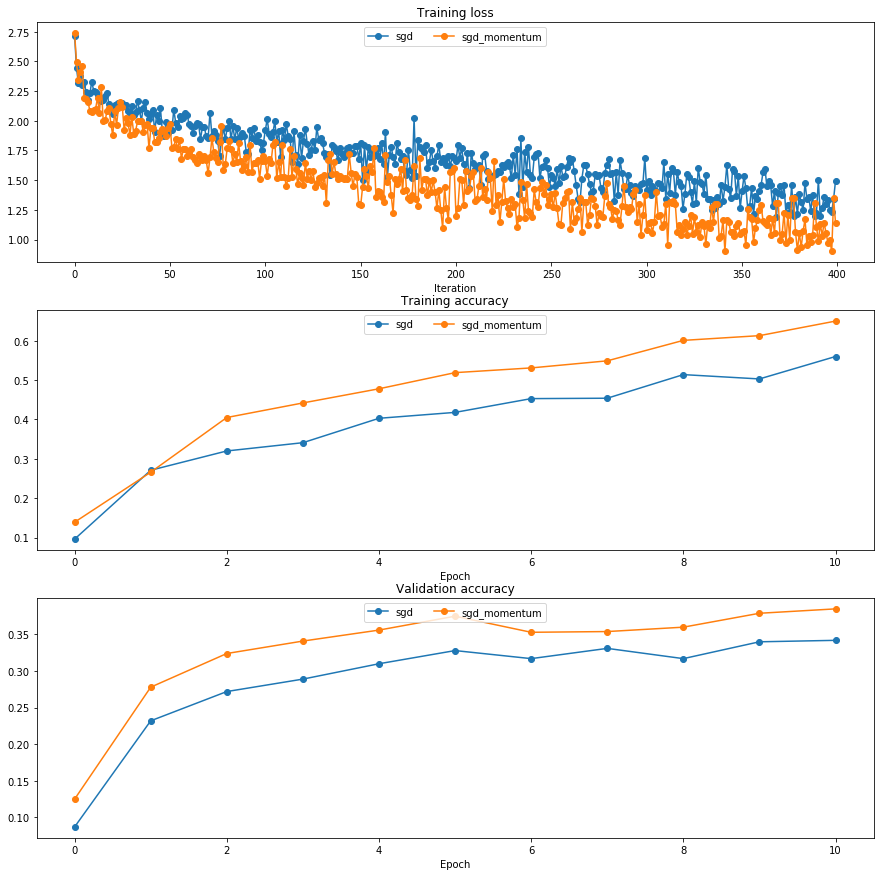

In [59]:
num_train = 4000
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

solvers = {}

for update_rule in ['sgd', 'sgd_momentum']:
  print('running with ', update_rule)
  model = FullyConnectedNeuralNet([100, 100, 100, 100, 100], weight_scale=5e-2)

  solver = Solver(model, small_data,
                  num_epochs=10, batch_size=100,
                  update_rule=update_rule,
                  optim_config={
                    'learning_rate': 1e-2,
                  },
                  verbose=True)
  solvers[update_rule] = solver
  solver.train()
  print()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

for update_rule, solver in solvers.items():
  plt.subplot(3, 1, 1)
  plt.plot(solver.loss_history, '-o', label=update_rule)
  
  plt.subplot(3, 1, 2)
  plt.plot(solver.train_acc_history, '-o', label=update_rule)

  plt.subplot(3, 1, 3)
  plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

# RMSProp et Adam
RMSProp [1] et Adam [2] sont d'autres algorithmes de descente de gradient dont le code est dans le fichier `ift725/optim.py`.   Alors que le code de Adam vous est fournit, vous devez rédigé celui de RMSProp.

[1] Tijmen Tieleman and Geoffrey Hinton. "Lecture 6.5-rmsprop: Divide the gradient by a running average of its recent magnitude." COURSERA: Neural Networks for Machine Learning 4 (2012).

[2] Diederik Kingma and Jimmy Ba, "Adam: A Method for Stochastic Optimization", ICLR 2015.

In [60]:
# Test RMSProp implementation; you should see errors less than 1e-7
import numpy as np
from ift725.optim import rmsprop

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
cache = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'cache': cache}
next_w, _ = rmsprop(w, dw, config=config)

expected_next_w = np.asarray([
    [-0.39,       -0.33846964, -0.2868865,  -0.23525427, -0.18357633],
    [-0.13185574, -0.0800953,  -0.02829757,  0.02353511,  0.07540058],
    [ 0.12729687,  0.17922215,  0.23117507,  0.28315533,  0.33516143],
    [ 0.38719188,  0.43924528,  0.49132033,  0.54341585,  0.59553073]])
expected_cache = np.asarray([
    [0.6,        0.61510526, 0.63021053, 0.64531579, 0.66042105],
 [0.67552632, 0.69063158, 0.70573684, 0.72084211, 0.73594737],
 [0.75105263, 0.76615789, 0.78189474, 0.79805263, 0.81421053],
 [0.83036842, 0.84652632, 0.86268421, 0.87884211, 0.895     ]])  


print('next_w error: ', rel_error(expected_next_w, next_w))
print('cache error: ', rel_error(expected_cache, config['cache']))

next_w error:  3.8665153708273904e-08
cache error:  3.2856307779330615e-09


In [61]:
# Test Adam implementation; you should see errors around 1e-7 or less
from ift725.optim import adam

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
m = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)
v = np.linspace(0.7, 0.5, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'm': m, 'v': v, 't': 5}
next_w, config = adam(w, dw, config=config)

expected_next_w = np.asarray([
  [-0.40094747, -0.34836187, -0.29577703, -0.24319299, -0.19060977],
  [-0.1380274,  -0.08544591, -0.03286534,  0.01971428,  0.0722929],
  [ 0.1248705,   0.17744702,  0.23002243,  0.28259667,  0.33516969],
  [ 0.38774145,  0.44031188,  0.49288093,  0.54544852,  0.59801459]])
expected_v = np.asarray([
  [ 0.69966,     0.68908382,  0.67851319,  0.66794809,  0.65738853,],
  [ 0.64683452,  0.63628604,  0.6257431,   0.61520571,  0.60467385,],
  [ 0.59414753,  0.58362676,  0.57311152,  0.56260183,  0.55209767,],
  [ 0.54159906,  0.53110598,  0.52061845,  0.51013645,  0.49966,   ]])
expected_m = np.asarray([
  [ 0.48,        0.49947368,  0.51894737,  0.53842105,  0.55789474],
  [ 0.57736842,  0.59684211,  0.61631579,  0.63578947,  0.65526316],
  [ 0.67473684,  0.69421053,  0.71368421,  0.73315789,  0.75263158],
  [ 0.77210526,  0.79157895,  0.81105263,  0.83052632,  0.85      ]])

print('next_w error: ', rel_error(expected_next_w, next_w))
print('v error: ', rel_error(expected_v, config['v']))
print('m error: ', rel_error(expected_m, config['m']))

next_w error:  0.0015218451757856217
v error:  4.208314038113071e-09
m error:  4.214963193114416e-09


Exécuter le code que voici afin de comparer ces différent algorithmes.  En pricipe Adam devrait être le meilleur algorithme.

running with  adam
(Iteration 1 / 400) loss: 2.745275
(Epoch 0 / 10) train acc: 0.125000; val_acc: 0.102000
(Iteration 11 / 400) loss: 2.024758
(Iteration 21 / 400) loss: 2.083172
(Iteration 31 / 400) loss: 1.845497
(Epoch 1 / 10) train acc: 0.362000; val_acc: 0.307000
(Iteration 41 / 400) loss: 1.830495
(Iteration 51 / 400) loss: 1.734564
(Iteration 61 / 400) loss: 1.612677
(Iteration 71 / 400) loss: 1.546147
(Epoch 2 / 10) train acc: 0.456000; val_acc: 0.339000
(Iteration 81 / 400) loss: 1.728160
(Iteration 91 / 400) loss: 1.436940
(Iteration 101 / 400) loss: 1.552290
(Iteration 111 / 400) loss: 1.450669
(Epoch 3 / 10) train acc: 0.494000; val_acc: 0.345000
(Iteration 121 / 400) loss: 1.359116
(Iteration 131 / 400) loss: 1.381627
(Iteration 141 / 400) loss: 1.414376
(Iteration 151 / 400) loss: 1.450139
(Epoch 4 / 10) train acc: 0.566000; val_acc: 0.398000
(Iteration 161 / 400) loss: 1.304274
(Iteration 171 / 400) loss: 1.230586
(Iteration 181 / 400) loss: 1.082184
(Iteration 191 / 40

/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:30: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:33: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the ear

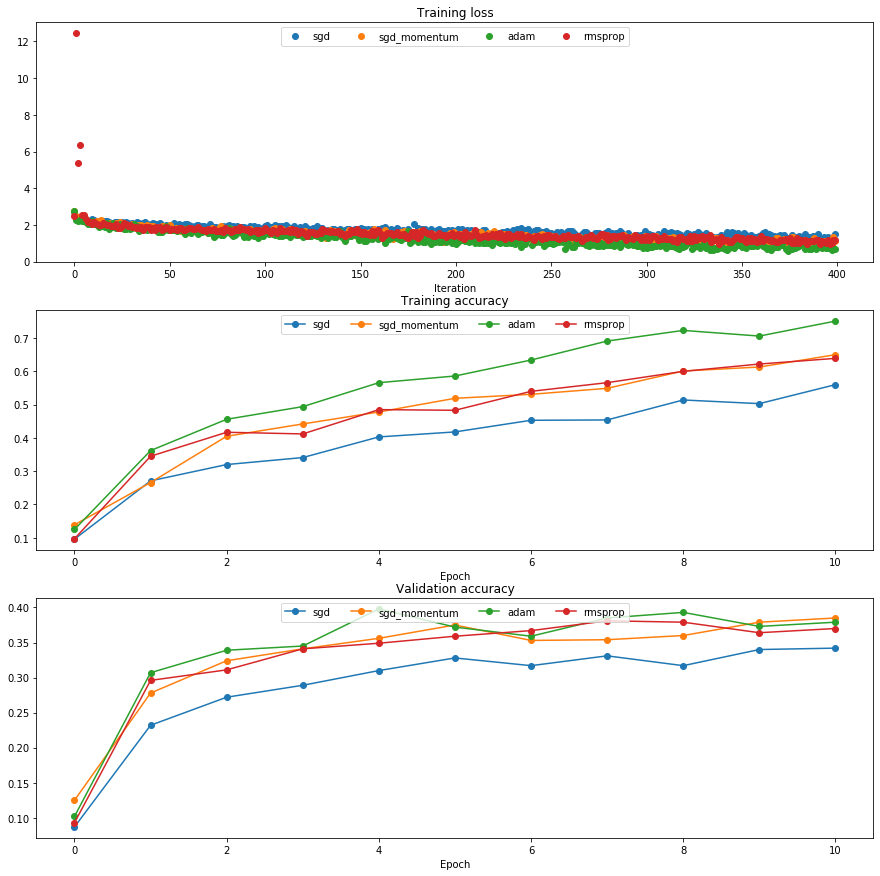

In [62]:
learning_rates = {'rmsprop': 1e-4, 'adam': 1e-3}
for update_rule in ['adam', 'rmsprop']:
  print('running with ', update_rule)
  model = FullyConnectedNeuralNet([100, 100, 100, 100, 100], weight_scale=5e-2)

  solver = Solver(model, small_data,
                  num_epochs=10, batch_size=100,
                  update_rule=update_rule,
                  optim_config={
                    'learning_rate': learning_rates[update_rule]
                  },
                  verbose=True)
  solvers[update_rule] = solver
  solver.train()
  print()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

for update_rule, solver in solvers.items():
  plt.subplot(3, 1, 1)
  plt.plot(solver.loss_history, 'o', label=update_rule)
  
  plt.subplot(3, 1, 2)
  plt.plot(solver.train_acc_history, '-o', label=update_rule)

  plt.subplot(3, 1, 3)
  plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

# Entraînez un bon model!
Entraînez le meilleur réseau de neurones possible sur CIFAR-10 et mettez le meilleur modèle dans la variable `best_model`. Vous devriez avoir au moins une justesse 50% (voire même 55%) en validation et en test.

Plus tard dans le devoir, on vous demandera d'entrainer et de tester une réseau convolutionnel sur CIFAR-10.  Vous verrez alors que cette architecture est supérieure aux réseaus de neurones pleinement connectés.

NOTE: il serait judicieux de compléter le notebook `BatchNormalization.ipynb` et `Dropout.ipynb` avant de compléter cette dernière partie.

In [27]:
do_delete = True

In [28]:
if do_delete:
    trys = []
    best_try = -1
    best_val_acc = 0
    print('Deleted trys')
else:
    print('Did not delete trys')
do_delete = False

Deleted trys


In [55]:
best_model = None
################################################################################
# TODO: Entrainez le meilleur FullyConnectedNeuralNet que vous pouvez sur les  #
#  données CIFAR-10. Vous pourriez trouver la normalization par lots et le     #
#  dropout utile. Stockez votre meilleur modèle dans la variable best_model.   #
################################################################################

def uniform(minv, maxv):
    return np.random.rand() * (maxv - minv) + minv

if 'trys' not in locals():
    trys = []
    best_try = -1
    best_val_acc = 0
for i in range(1):
    # reg 0.00779190546432  lr 0.000423844376859
    # reg 0.000204588367827 lr 0.000529341067109
    weight_scale = 3e-2  # 10 ** uniform(-3, -1)
    lr = 10 ** -2.5  # 10 ** uniform(-4, -2)
    reg = 1e-10  # 10 ** uniform(-6, -3)
    
    model = FullyConnectedNeuralNet([100] * 5, weight_scale=weight_scale, reg=reg, use_batchnorm=True)

    solver = Solver(model, data,
                  num_epochs=30, batch_size=100,
                  update_rule='adam',
                  optim_config={
                    'learning_rate': lr
                  },
                  print_every=200,
                  verbose=True)
    solver.train()
    
    max_val_acc = np.max(solver.val_acc_history)
    cur_index = len(trys)
    print('Try', cur_index, 'Max accu. val.', max_val_acc, 'p:', weight_scale, reg, lr, ('Record!' if max_val_acc > best_val_acc else ''))
    trys.append({
            'ws': weight_scale, 'reg': reg, 'lr': lr,
            'maxvacc': max_val_acc,
            'lossh': solver.loss_history,
            'tacch': solver.train_acc_history,
            'vacch': solver.val_acc_history,
            'model': model
        })
    
    if max_val_acc > best_val_acc:
        best_val_acc = max_val_acc
        best_try = cur_index
        
print('Best try:', best_try)
print('Total tries', len(trys))
################################################################################
#                              FIN DE VOTRE CODE                               #
################################################################################

(Iteration 1 / 14700) loss: 2.304172
(Epoch 0 / 30) train acc: 0.096000; val_acc: 0.115000


KeyboardInterrupt: 

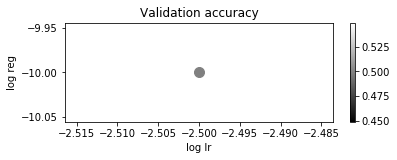

In [52]:
# Visualize the cross-validation results
forget = 0
new_tries = trys[forget:]
marker_size = 100
#x_scatter, x_label = [np.log10(x['ws']) for x in new_tries], 'log weight scale'
x_scatter, x_label = [np.log10(x['lr']) for x in new_tries], 'log lr'
y_scatter, y_label = [np.log10(x['reg']) for x in new_tries], 'log reg'

# plot validation accuracy
colors = [x['maxvacc'] for x in new_tries] # default size of markers is 20
isorted = np.argsort(colors)
x_scatter = np.asarray(x_scatter)[isorted]
y_scatter = np.asarray(y_scatter)[isorted]
colors = np.asarray(colors)[isorted]
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Validation accuracy')
plt.show()

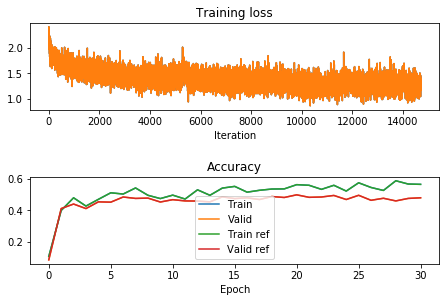

In [53]:
ref = trys[best_try]
best_try = -1
plt.subplot(2, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')
plt.plot(trys[best_try]['lossh'], '-')
plt.plot(ref['lossh'], '-')

plt.subplot(2, 1, 2)
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.plot(trys[best_try]['tacch'], '-', label='Train')
plt.plot(trys[best_try]['vacch'], '-', label='Valid')
plt.plot(ref['tacch'], '-', label='Train ref')
plt.plot(ref['vacch'], '-', label='Valid ref')
plt.legend(loc='lower center')

plt.tight_layout(pad=0, w_pad=0, h_pad=2)
plt.show()

# Test your model
Run your best model on the validation and test sets. You should achieve above 53% accuracy on the validation set.

In [54]:
best_model = trys[best_try]['model']
X_test = data['X_test']
y_test = data['y_test']
X_val  = data['X_val']
y_val  = data['y_val']
y_test_pred = np.argmax(best_model.loss(X_test), axis=1)
y_val_pred = np.argmax(best_model.loss(X_val), axis=1)
print('Validation set accuracy: ', (y_val_pred == y_val).mean())
print('Test set accuracy: ', (y_test_pred == y_test).mean())

Validation set accuracy:  0.499
Test set accuracy:  0.496
